In [73]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt

In [74]:
# Results path and file name

experiment = 'Test_Paper'
path = './Results/' 
path_figures = './Results/Figures/'

# Predictive dataframe path and file name
pred_path = './Data/Paper/'
pred_file = 'predictors_dataset.csv'

In [75]:
pred_dataframe_opt = pd.read_csv(pred_path+pred_file, index_col=0)
pred_dataframe_opt.index = pd.to_datetime(pred_dataframe_opt.index)

In [10]:
# pred_dataframe_opt.drop(['t2mEurope_cluster2','z500Europe_cluster4','olrWorld_cluster3'], axis=1, inplace=True
# pred_dataframe_opt.to_csv('../Predictors/'+'Test6_low_NoVIP'+'/Predictors_dataset.csv')

In [76]:
pred_dataframe_opt.shape

(26663, 71)

In [77]:
import os
files_labels = os.listdir(pred_path)
files_labels = [file for file in files_labels if file.startswith('label')]
files_labels.sort()
files_labels

['labelsmslEurope5.csv',
 'labelsmslWorld5.csv',
 'labelsolrNorth_Atlantic5.csv',
 'labelsolrWorld5.csv',
 'labelssicArtic5.csv',
 'labelssm1Europe5.csv',
 'labelssstNorth_Atlantic5.csv',
 'labelssstWorld5.csv',
 'labelst2mEurope5.csv',
 'labelstpEurope5.csv',
 'labelsz500Europe5.csv',
 'labelsz500World5.csv']

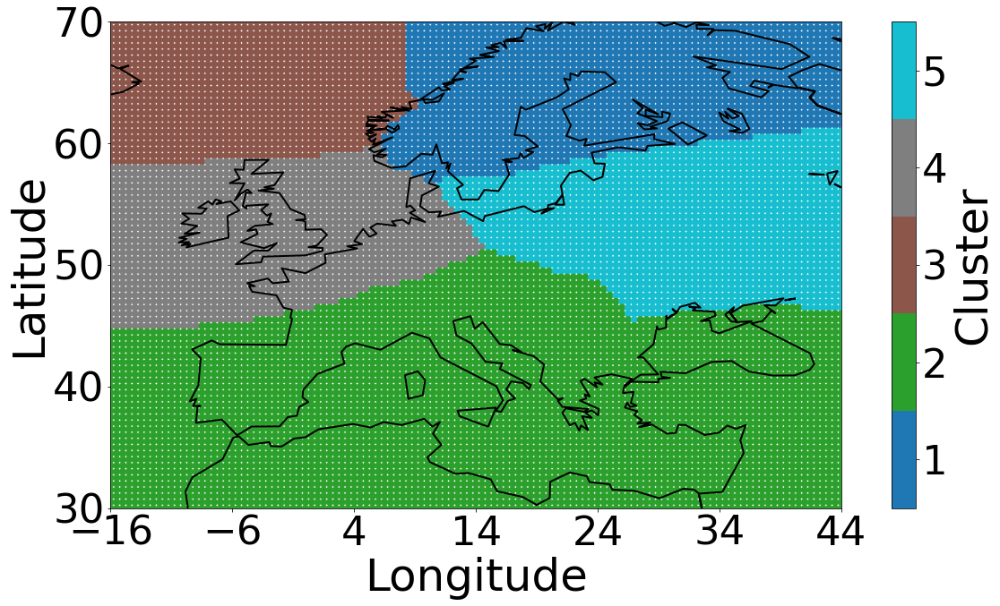

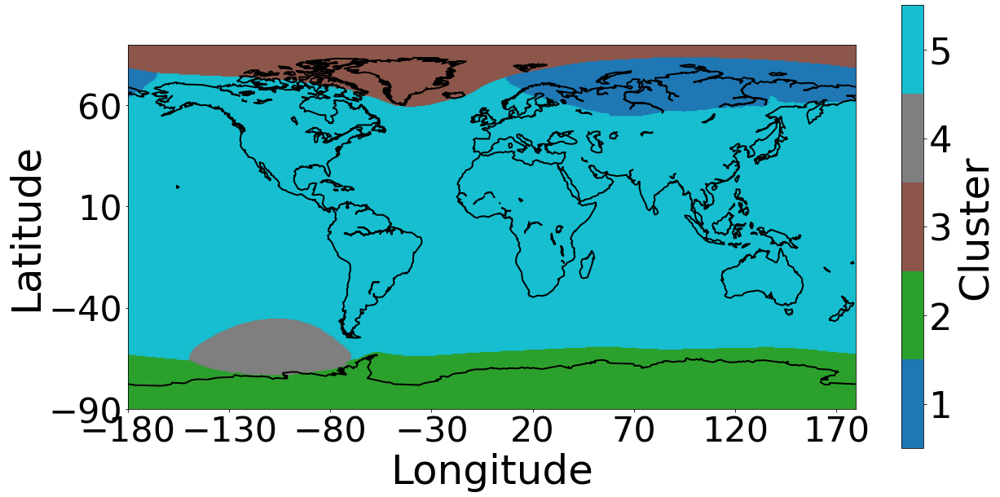

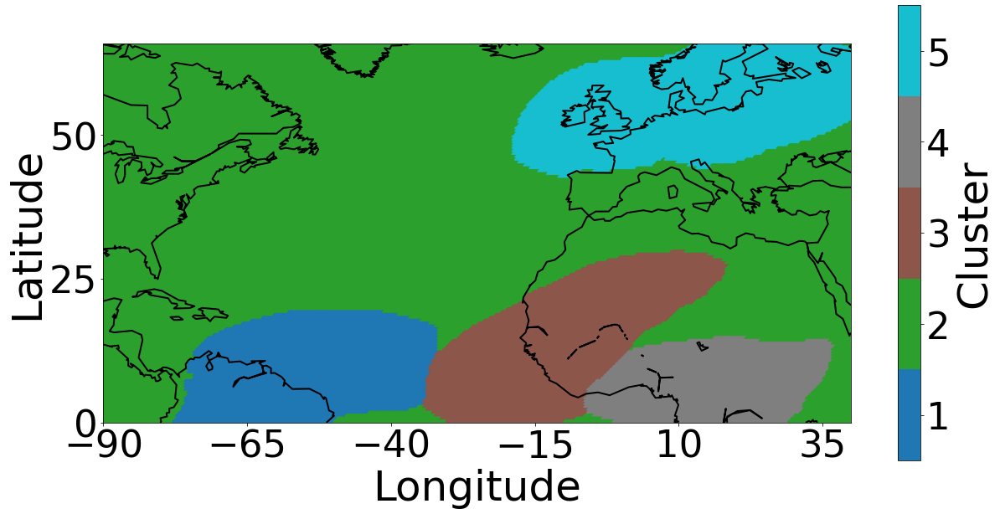

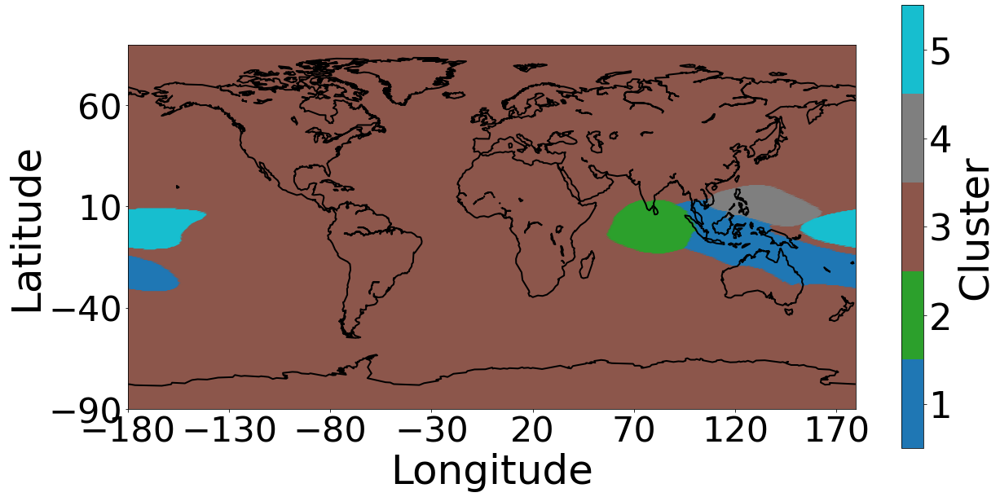

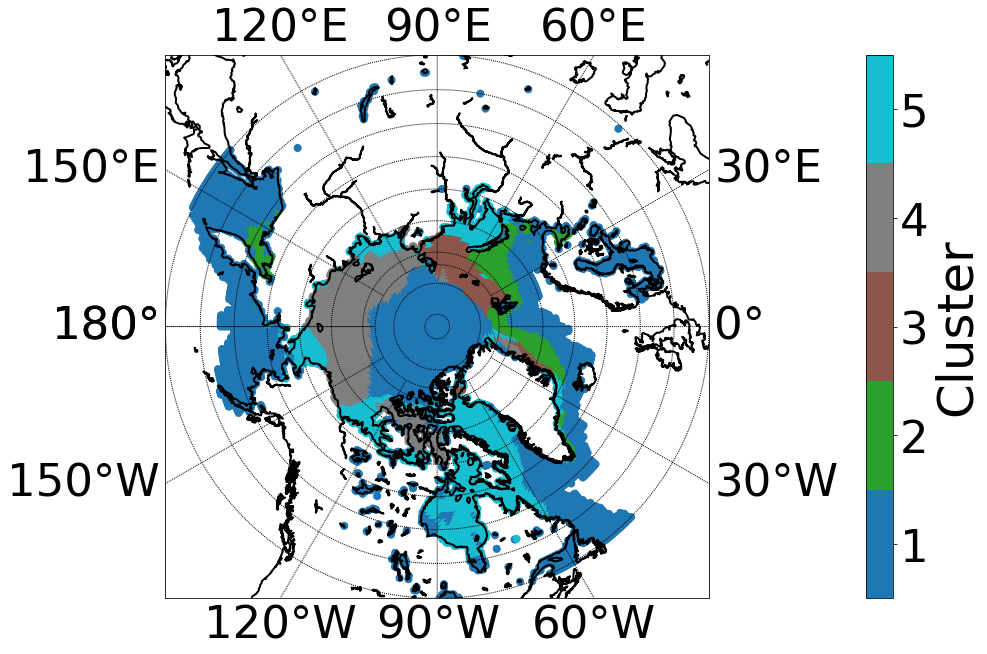

...

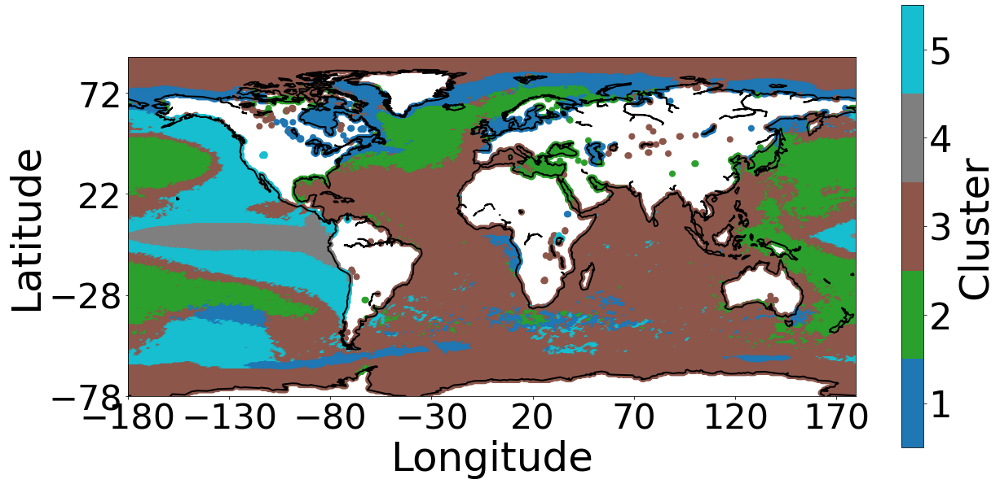

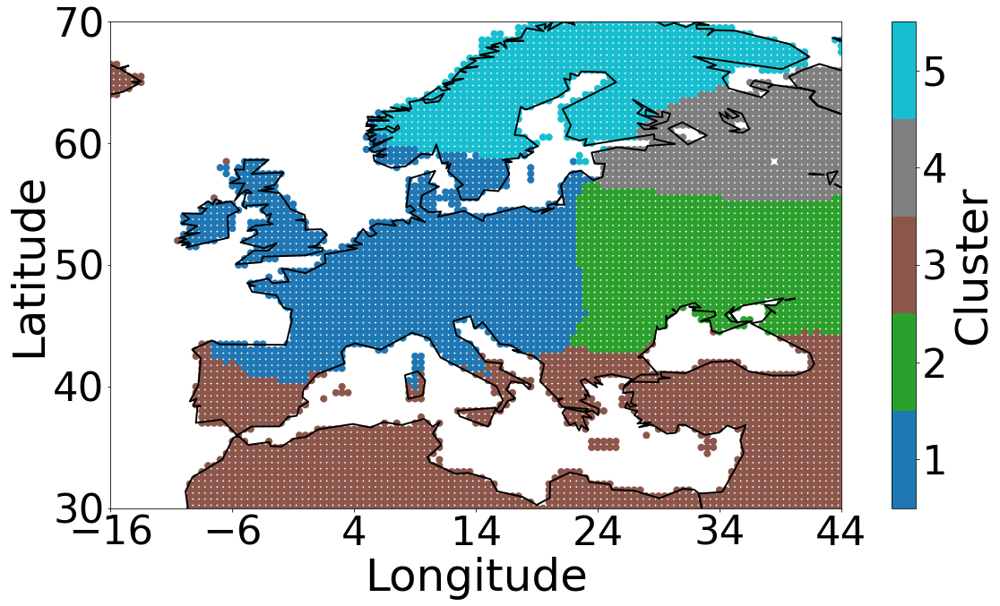

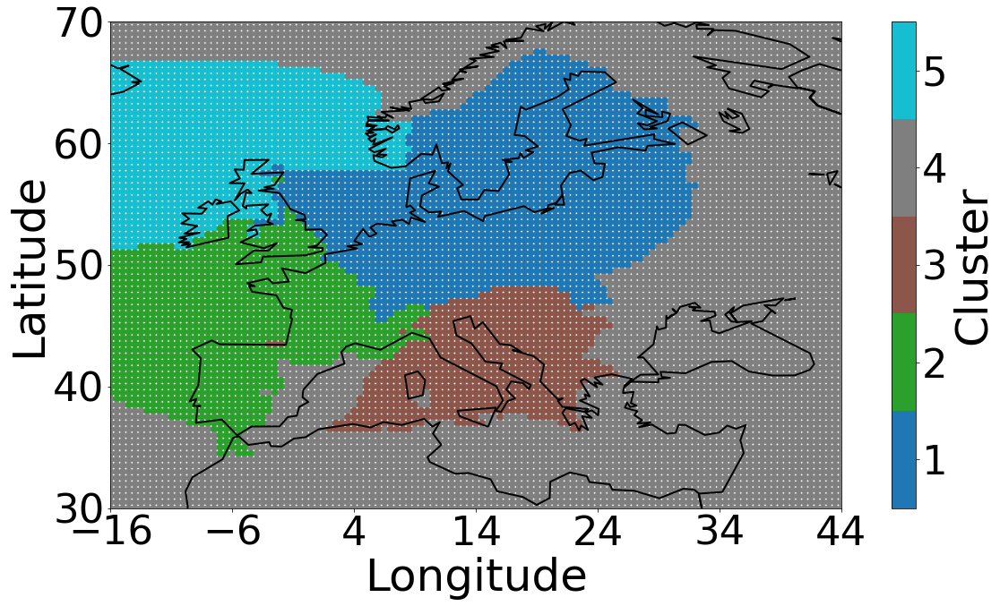

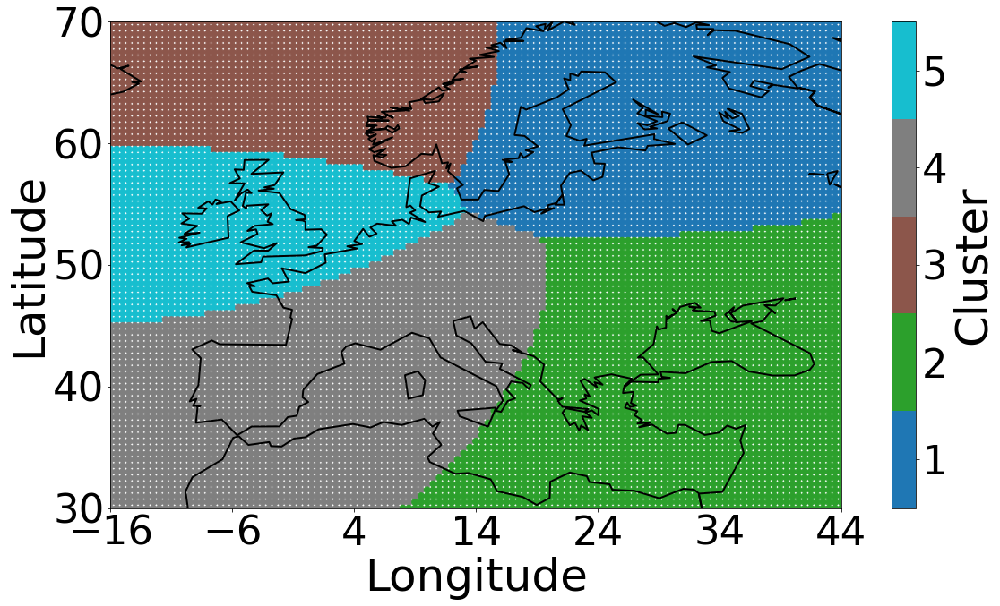

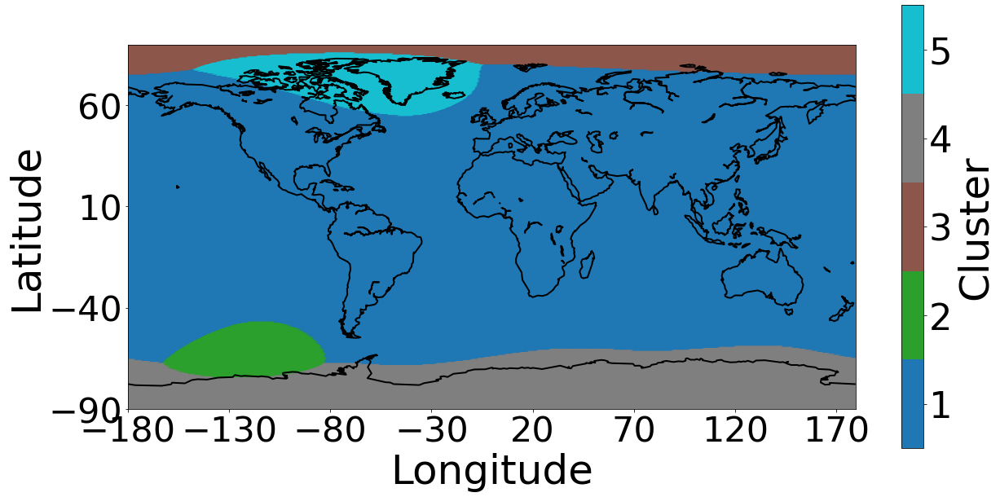

In [14]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv(pred_path+label_file,index_col=0)
    h+=1
    plt.figure(figsize=(20, 10))
    if label_file == 'labelssicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')


    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])


    num_clusters = label_df['cluster'].max()
    if num_clusters>10:
        cmap = plt.cm.get_cmap('tab20', num_clusters)
    else:
        cmap = plt.cm.get_cmap('tab10', num_clusters)
    map.scatter(x, y,c=label_df['cluster'], cmap=cmap, s=50, )
    # Add colorbar
    bounds = np.arange(num_clusters + 1) + 0.5
    cbar = plt.colorbar(ticks=np.arange(num_clusters)+1, boundaries=bounds)
    cbar.set_ticklabels(np.arange(num_clusters)+1)
    cbar.ax.tick_params(labelsize=45)
    cbar.set_label('Cluster',fontsize=50)
  
    map.drawcoastlines(linewidth=2)
    # Set plot title
    # plt.title(label_file[8:-5],fontsize=25)

    if label_file=='labelssicArtic5.csv':

        # Adjust the position: move it 7% to the right
        cbar_pos = cbar.ax.get_position()
        new_cbar_pos = [cbar_pos.x0 + 0.07, cbar_pos.y0, cbar_pos.width, cbar_pos.height]
        cbar.ax.set_position(new_cbar_pos)

        # plot xticks and yticks for npstere projection
        # map.drawmeridians(np.arange(-180.,181.,20.), labels=[True, True, True, True])
        parallels = np.arange(48., 91., 5.)  # Define your latitude ticks
        meridians = np.arange(-180., 181., 30.)  # Define your longitude ticks

        # Draw parallels and meridians
        map.drawparallels(parallels, labels=[False, False, False, False],)
        map.drawmeridians(meridians, labels=[True, True, True, True],fontsize=45)


    elif (label_df['nodes_lon'].min() == -180) :
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 50),fontsize=43)
        plt.yticks(np.arange(label_df['nodes_lat'].min(), label_df['nodes_lat'].max()+2,50),fontsize=43)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)
    elif  (label_df['nodes_lon'].min() == -90):
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 25),fontsize=45)
        plt.yticks(np.arange(label_df['nodes_lat'].min(), label_df['nodes_lat'].max()+2,25),fontsize=45)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)
    else:
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10),fontsize=45)
        plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10),fontsize=45)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)


    # Show the plot
    # plt.savefig('../Predictors/'+experiment+'/labels/'+label_file[:-4]+'.eps', format='eps', dpi=1000, bbox_inches='tight')
    plt.savefig(path_figures+experiment+'_'+label_file[:-4]+'.png', format='png', dpi=250, bbox_inches='tight')
    plt.show()

In [78]:
import os
files = os.listdir(path+experiment)
files = [file for file in files if file.endswith('.csv')]
files = files[1:]
files

['Test_Paper_10.csv',
 'Test_Paper_2.csv',
 'Test_Paper_3.csv',
 'Test_Paper_4.csv',
 'Test_Paper_5.csv',
 'Test_Paper_6.csv',
 'Test_Paper_7.csv',
 'Test_Paper_8.csv',
 'Test_Paper_9.csv']

In [79]:
sol_file_av = pd.DataFrame(columns=['CV','Test','Sol'])
for file in files:
    ff = pd.read_csv(path+experiment+'/'+file,sep=' ',header=0)
    # ff = pd.read_csv('./Results/Test3_CRO/'+file,sep=' ',header=0)[:20000]
    print(len(ff))
    sol_file_av = pd.concat([sol_file_av,ff])
sol_file_av.reset_index(inplace=True,drop=True)
# sol_file_av.drop_duplicates(subset=['Sol'],inplace=True)
sol_file_av.shape


3954
10442
14389
10456
8068
10280
11682
13249
12804


(95324, 3)

In [10]:
# sol_file_av = pd.read_csv('./Results/Test3_CRO/CRO_LogReg_Test3_Run3.csv',sep=' ',header=0)
# sol_file_av.shape


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


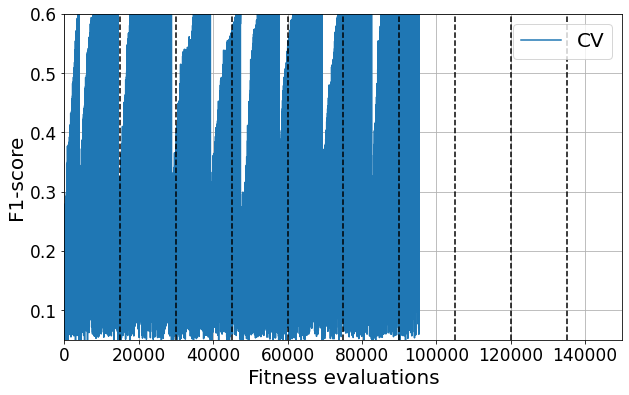

In [80]:
plt.figure(figsize=(10, 6))
plt.plot(sol_file_av.index,sol_file_av['CV'],label='CV')
# plt.plot(sol_file_av.index,sol_file_av['Test'],label='Test')
# plt.axhline(y = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(0.1*sol_file_av.shape[0]))['CV'].values[-1], color = 'r', linestyle = '-')
plt.axvline(x=15000, color = 'k', linestyle = '--')
plt.axvline(x=15000*2, color = 'k', linestyle = '--')
plt.axvline(x=15000*3, color = 'k', linestyle = '--')
plt.axvline(x=15000*4, color = 'k', linestyle = '--')
plt.axvline(x=15000*5, color = 'k', linestyle = '--')
plt.axvline(x=15000*6, color = 'k', linestyle = '--')
plt.axvline(x=15000*7, color = 'k', linestyle = '--')
plt.axvline(x=15000*8, color = 'k', linestyle = '--')
plt.axvline(x=15000*9, color = 'k', linestyle = '--')
plt.ylim([0.05,0.6])
plt.xlim([0,150000])
plt.grid()
plt.xlabel('Fitness evaluations',fontsize=20)
plt.ylabel('F1-score',fontsize=20)
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
plt.legend(fontsize = 20)
plt.savefig('./CV_Low.eps', format='eps', dpi=1000, bbox_inches = 'tight')


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


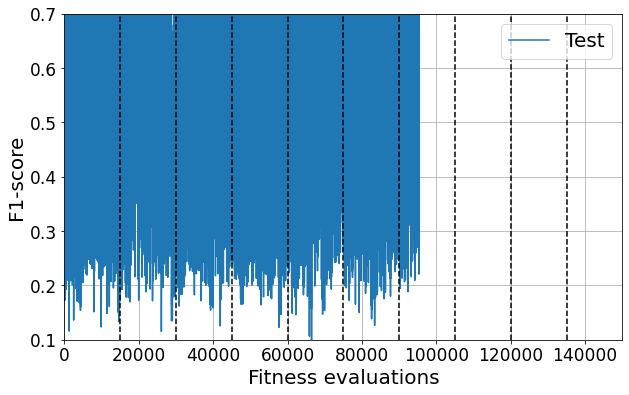

In [81]:
plt.figure(figsize=(10, 6))
# plt.plot(sol_file_av.index,sol_file_av['CV'],label='CV')
plt.plot(sol_file_av.index,sol_file_av['Test'],label='Test')
# plt.axhline(y = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(0.1*sol_file_av.shape[0]))['CV'].values[-1], color = 'r', linestyle = '-')
plt.axvline(x=15000, color = 'k', linestyle = '--')
plt.axvline(x=15000*2, color = 'k', linestyle = '--')
plt.axvline(x=15000*3, color = 'k', linestyle = '--')
plt.axvline(x=15000*4, color = 'k', linestyle = '--')
plt.axvline(x=15000*5, color = 'k', linestyle = '--')
plt.axvline(x=15000*6, color = 'k', linestyle = '--')
plt.axvline(x=15000*7, color = 'k', linestyle = '--')
plt.axvline(x=15000*8, color = 'k', linestyle = '--')
plt.axvline(x=15000*9, color = 'k', linestyle = '--')
plt.ylim([0.1,0.7])
plt.xlim([0,150000])
plt.grid()
plt.xlabel('Fitness evaluations',fontsize=20)
plt.ylabel('F1-score',fontsize=20)
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
plt.legend(fontsize = 20,loc=1)
plt.savefig('./Test_Low.eps', format='eps', dpi=1000, bbox_inches = 'tight')

In [82]:
sol_file_av.drop_duplicates(subset=['Sol'],inplace=True)
sol_file_av.shape

(74816, 3)

 
0.5808 x + 0.415


Text(0.5, 1.0, 'y=0.5x+0.33')

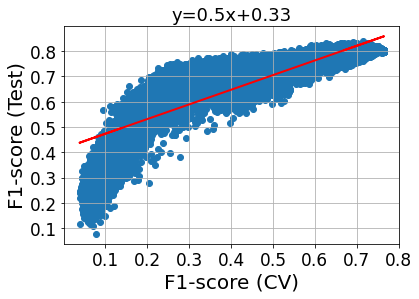

In [83]:
plt.scatter(sol_file_av['CV'],sol_file_av['Test'])
z = np.polyfit(sol_file_av['CV'], sol_file_av['Test'], 1)
p = np.poly1d(z)
#add trendline to plot
plt.plot(sol_file_av['CV'], p(sol_file_av['CV']), "r-", linewidth=2.0,)
plt.xlabel('F1-score (CV)',fontsize=20)
plt.ylabel('F1-score (Test)',fontsize=20)
plt.grid()
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
print(p)
plt.title('y=0.5x+0.33',fontsize=18)
# plt.savefig('./Scatter_low.png', format='png', dpi=250, bbox_inches = 'tight')

In [84]:
array_best = np.fromstring(sol_file_av.Sol[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')

array_best

array([  9.,  11.,  10.,  18.,  10.,  18.,  46.,   1.,   6.,  15.,   4.,
        50.,  10.,   5.,   7.,  33.,  24.,  16.,  22.,  33.,  13.,   2.,
        33.,  12.,  14.,  39.,  15.,  16.,  17.,  22.,  16.,   9.,   4.,
         8.,  19.,   1.,  35.,  14.,  25.,  29.,  20.,   4.,   8.,  17.,
        28.,  11.,  20.,   5.,  21.,  33.,  25.,  14.,   4.,   4.,  11.,
         8.,  15.,  23.,   7.,  10.,  12.,  13.,   5.,  46.,   9.,  27.,
        32.,  24.,  12.,   2.,  16.,  10.,  30.,  35.,   8.,  41.,  44.,
        13.,  12.,  41.,  37.,  16.,  22.,  32.,  45.,  30.,  17.,  52.,
        30.,  33.,  48.,  19.,  21., 143.,  45.,  67.,  27.,  36.,  32.,
         8.,   3.,  45.,  51.,  15.,  61.,  41.,  19.,  30.,  52.,  22.,
       143.,   0.,  32., 113.,  22.,  23.,   2.,  48.,  13.,  23.,  34.,
        13.,  26.,  28.,  41.,  38.,  13.,  89., 143.,  48.,  20.,  31.,
         1.,  10.,   0.,  28.,   0.,  37.,  23.,   7.,  26.,  28.,   1.,
         1.,   0.,   0.,   0.,   0.,   0.,   0.,   

 
0.5808 x + 0.415


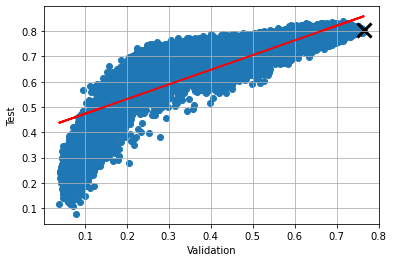

In [85]:
plt.scatter(sol_file_av['CV'],sol_file_av['Test'])
z = np.polyfit(sol_file_av['CV'], sol_file_av['Test'], 1)
p = np.poly1d(z)
plt.scatter(sol_file_av.CV[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],sol_file_av.Test[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],color='black',marker='x',s=200,linewidths=3)
#add trendline to plot
plt.plot(sol_file_av['CV'], p(sol_file_av['CV']), "r-", linewidth=2.0,)
plt.xlabel('Validation')
plt.ylabel('Test')
plt.grid()
print(p)

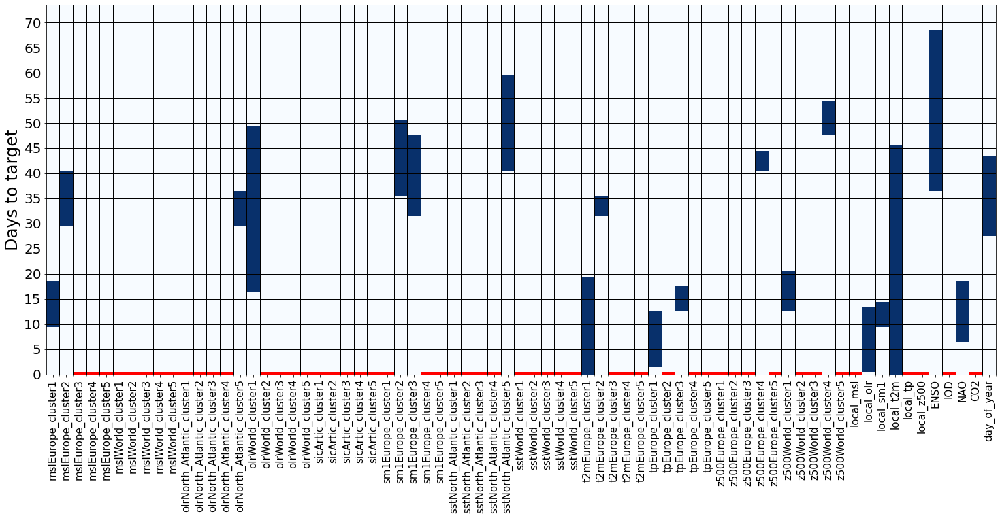

In [86]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator,MultipleLocator

def create_board(n_rows, n_cols, final_sequence, sequence_length):
    board = np.zeros((n_rows, n_cols))
    
    # Establecer los cuadrados azules
    for i in range(n_cols):
        start_index = int(final_sequence[i]) 
        end_index = int(final_sequence[i])  + int(sequence_length[i])
        if feat_sel[i] != 0:
            board[start_index:end_index, i] = 1
    
    return board

def plot_board(board, column_names):
    plt.figure(figsize=(25, 10))
    plt.imshow(board, cmap='Blues', origin='lower',aspect='auto')
    plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=15)
    minor_locator = AutoMinorLocator(2)

    plt.gca().yaxis.set_major_locator(MultipleLocator(5))

    plt.yticks(fontsize=20)

    # Put the yticks labels

    # plt.gca().xaxis.grid( which='major',linewidth=1)
    # plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
    plt.gca().xaxis.set_minor_locator(minor_locator)
    plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
    plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
    plt.ylabel('Days to target', fontsize=25)

    for i in range(board.shape[1]):
        if feat_sel[i] == 0:
            rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
            plt.gca().add_patch(rect)
    plt.ylim(0)
    # plt.savefig('./Heatmap_low_100_best.eps', format='eps', bbox_inches = 'tight')
    plt.show()

column_names = pred_dataframe_opt.columns.tolist()
final_sequence = array_best[len(column_names):2*len(column_names)]
sequence_length = array_best[:len(column_names)]
feat_sel = array_best[2*len(column_names):]


n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_best = create_board(n_rows, n_cols, final_sequence, sequence_length)

plot_board(board_best, column_names)

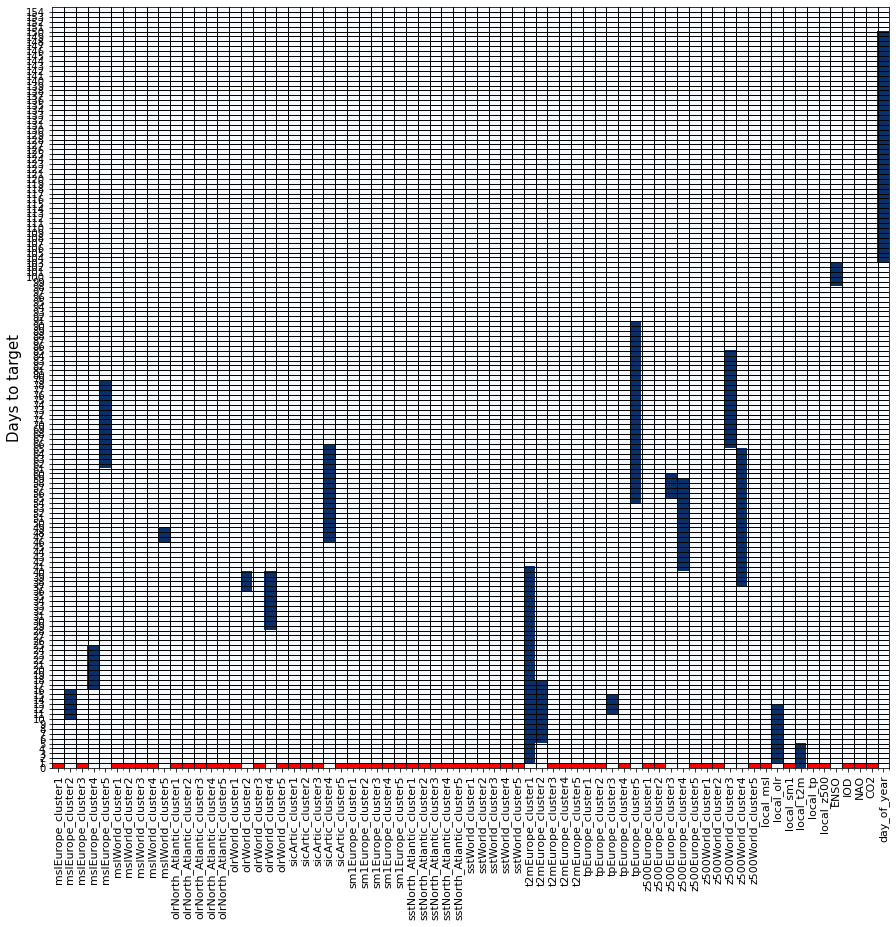

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator

def create_board(n_rows, n_cols, final_sequence, sequence_length):
    board = np.zeros((n_rows, n_cols))
    
    # Establecer los cuadrados azules
    for i in range(n_cols):
        start_index = int(final_sequence[i]) 
        end_index = int(final_sequence[i])  + int(sequence_length[i])
        if feat_sel[i] != 0:
            board[start_index:end_index, i] = 1
    
    return board

def plot_board(board, column_names):
    plt.figure(figsize=(15, 14))
    plt.imshow(board, cmap='Blues', origin='lower',aspect='auto')
    plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
    plt.yticks(np.arange(board.shape[0])-0.5,np.arange(board.shape[0]))
    minor_locator = AutoMinorLocator(2)
    plt.gca().xaxis.set_minor_locator(minor_locator)
    
    plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
    plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
    # plt.grid(color='black', linewidth=1)
    plt.ylabel('Days to target',fontsize=15)

    for i in range(board.shape[1]):
        if feat_sel[i] == 0:
            rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
            plt.gca().add_patch(rect)
    
    plt.show()

column_names = pred_dataframe_opt.columns.tolist()
final_sequence = array_best[len(column_names):2*len(column_names)]
sequence_length = array_best[:len(column_names)]
feat_sel = array_best[2*len(column_names):]


n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_best = create_board(n_rows, n_cols, final_sequence, sequence_length)

plot_board(board_best, column_names)



In [32]:
array_best

array([14., 25., 12.,  6., 43., 31., 13.,  3., 45., 27., 30., 42., 17.,
        5., 11.,  7., 13., 14., 39., 45., 19., 40., 21.,  9., 43., 29.,
       18., 30., 21., 39., 10., 10., 22., 23., 25., 15., 11., 34.,  9.,
       16., 16., 34.,  3., 12., 31., 15., 27., 13., 20.,  8., 24., 14.,
        8., 41., 22., 26., 14.,  4., 17., 33., 27., 18., 15., 15., 50.,
        2., 20.,  9., 17., 10., 21., 30., 13., 69., 42.,  5., 34., 46.,
       45., 36., 23., 40., 47., 37., 23., 32., 23., 37., 39., 24., 35.,
       11., 37., 26., 12., 46., 41., 25., 28., 27., 19., 46., 46., 32.,
       13., 14., 11., 25., 32.,  9., 25.,  2., 27., 50., 29., 33., 39.,
       24., 10., 51., 40., 42., 21., 43., 22., 14., 42., 34., 26., 51.,
       30., 27., 25., 26.,  0., 21.,  0., 19., 33., 34., 47., 50.,  0.,
        0.,  1.,  1.,  0.,  1.,  1.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,
        1.,  1.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0

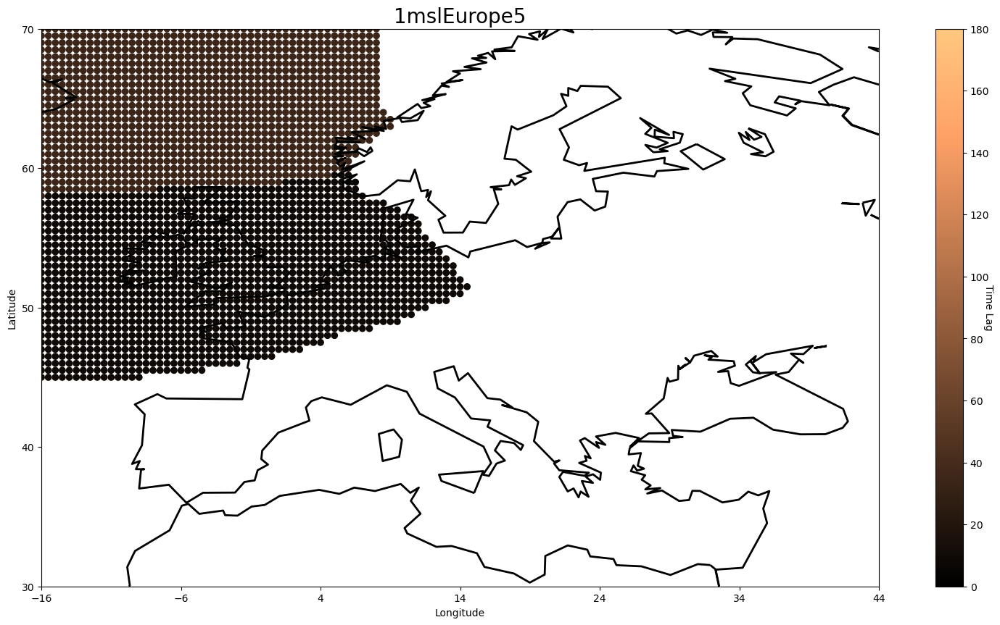

KeyboardInterrupt: 

In [46]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        if feat_sel[h+i]==0:
            label_df['fin_seq'] = np.where(label_df['cluster'] == i, -1, label_df['fin_seq'])
        else:
            # print((final_sequence * feat_sel)[h+i])
            label_df['fin_seq'] = np.where(label_df['cluster'] == i, (final_sequence * feat_sel)[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=2)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=180)

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [87]:
best100_index = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(0.1*sol_file_av.shape[0])).index

arrays = []
for ind in best100_index:
    array = np.fromstring(sol_file_av.Sol[ind].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')
    arrays.append(array)

 
0.5808 x + 0.415


Text(0.5, 1.0, 'y=0.5x+0.33')

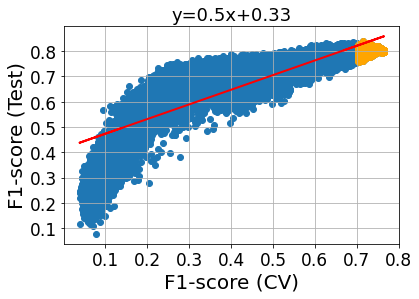

In [88]:
plt.scatter(sol_file_av['CV'],sol_file_av['Test'])
z = np.polyfit(sol_file_av['CV'], sol_file_av['Test'], 1)
p = np.poly1d(z)
# plt.scatter(sol_file_av.CV[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],sol_file_av.Test[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],color='black',marker='x',s=200,linewidths=3)
plt.scatter(sol_file_av.CV[best100_index],sol_file_av.Test[best100_index],color='orange')
#add trendline to plot
plt.plot(sol_file_av['CV'], p(sol_file_av['CV']), "r-", linewidth=2.0,)
plt.xlabel('CV')
plt.ylabel('Test')
plt.grid()
print(p)
plt.xlabel('F1-score (CV)',fontsize=20)
plt.ylabel('F1-score (Test)',fontsize=20)
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
plt.title('y=0.5x+0.33',fontsize=18)
# plt.savefig('./Scatter_low_Best.png', format='png', dpi=250, bbox_inches = 'tight')



 
0.5808 x + 0.415


Text(0.5, 1.0, 'y=0.5x+0.33')

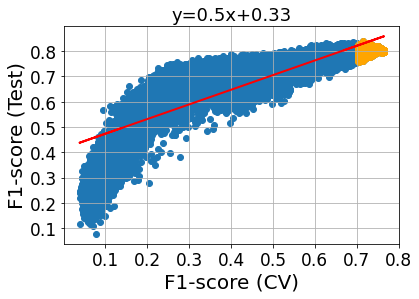

In [89]:
plt.scatter(sol_file_av['CV'],sol_file_av['Test'])
z = np.polyfit(sol_file_av['CV'], sol_file_av['Test'], 1)
p = np.poly1d(z)
# plt.scatter(sol_file_av.CV[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],sol_file_av.Test[sol_file_av.sort_values(by=['CV'],ascending=False).index[0]],color='black',marker='x',s=200,linewidths=3)
plt.scatter(sol_file_av.CV[best100_index],sol_file_av.Test[best100_index],color='orange')
#add trendline to plot
plt.plot(sol_file_av['CV'], p(sol_file_av['CV']), "r-", linewidth=2.0,)
plt.xlabel('CV')
plt.ylabel('Test')
plt.grid()
print(p)
plt.xlabel('F1-score (CV)',fontsize=20)
plt.ylabel('F1-score (Test)',fontsize=20)
plt.xticks(fontsize=17)
plt.yticks(fontsize=17)
plt.title('y=0.5x+0.33',fontsize=18)
# plt.savefig('./Scatter_low_Best.png', format='png', dpi=250, bbox_inches = 'tight')



In [90]:
n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_100 = np.zeros((n_rows, n_cols))
discarded = np.zeros((1, n_cols))

for array in arrays:
    final_sequence = array[len(column_names):2*len(column_names)]
    sequence_length = array[:len(column_names)]
    feat_sel = array[2*len(column_names):]
    column_names = pred_dataframe_opt.columns.tolist()

    for i in range(n_cols):
        start_index = int(final_sequence[i])
        end_index = int(final_sequence[i]) + int(sequence_length[i])
        

        if feat_sel[i]==0:
            discarded[0,i] += 1
        else:
            board_100[start_index:end_index, i] += 1
    
board_100[0,:].shape

(71,)

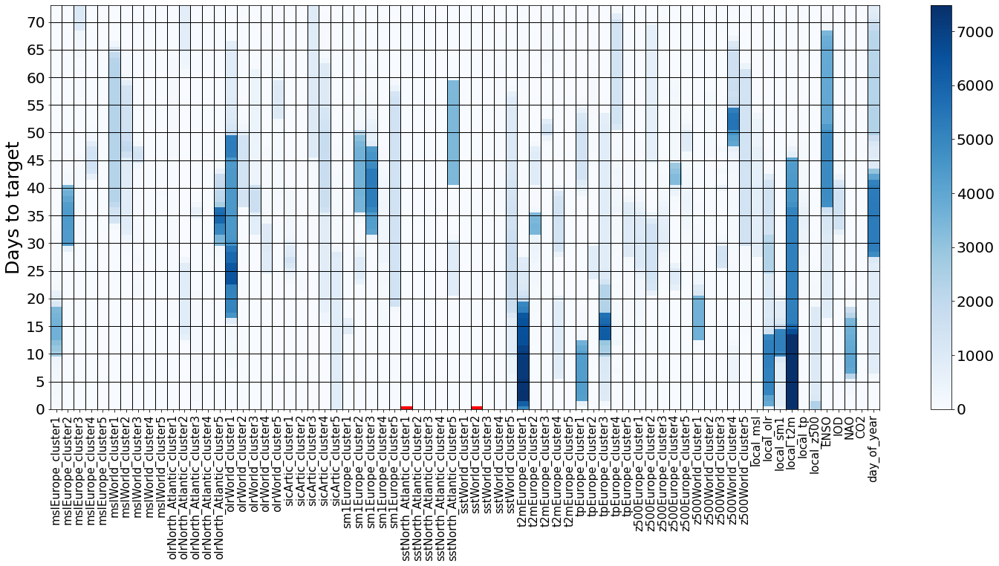

In [91]:
from matplotlib.ticker import MultipleLocator
plt.figure(figsize=(25, 10))
plt.imshow(board_100, cmap='Blues', origin='lower', aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90, fontsize=15)
# plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0],5))
minor_locator = AutoMinorLocator(2)

plt.gca().yaxis.set_major_locator(MultipleLocator(5))
# plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0],5))

plt.yticks(fontsize=20)


# Put the yticks labels

# plt.gca().xaxis.grid( which='major',linewidth=1)
# plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=25)






for i in range(board_100.shape[1]):
    if np.sum(board_100[:, i]) == 0:
        rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
        plt.gca().add_patch(rect)
colorbar = plt.colorbar()
colorbar.ax.tick_params(labelsize=20)
plt.ylim(-0, np.nonzero(board_100.sum(axis=1))[0][-1])





# plt.savefig('./Heatmap_low_100_.eps', format='eps', bbox_inches = 'tight')
plt.show()

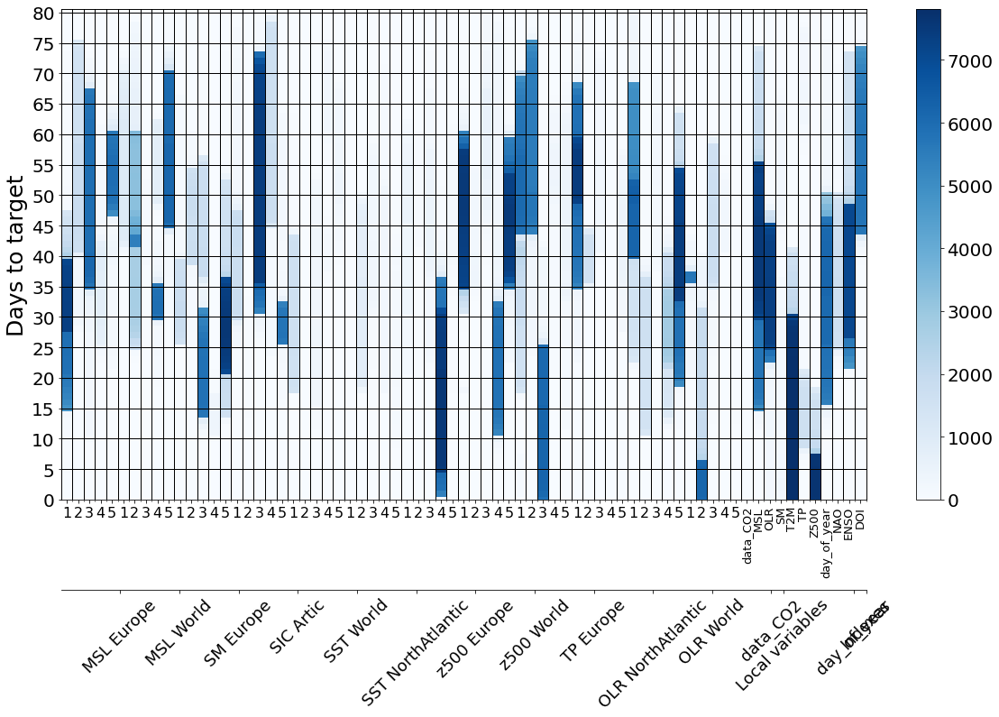

In [87]:
from matplotlib.ticker import MultipleLocator
plt.figure(figsize=(20, 10))
plt.imshow(board_100, cmap='Blues', origin='lower', aspect='auto')
labels=['1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        '1','2','3','4','5',
        'data_CO2','MSL','OLR','SM','T2M','TP','Z500','day_of_year','NAO','ENSO','DOI']
plt.xticks(np.arange(len(column_names)), labels, rotation=0, fontsize=16)


# plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0],5))
minor_locator = AutoMinorLocator(2)

plt.gca().yaxis.set_major_locator(MultipleLocator(5))
# plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0],5))

plt.yticks(fontsize=20)


# Put the yticks labels

# plt.gca().xaxis.grid( which='major',linewidth=1)
# plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=25)






for i in range(board_100.shape[1]):
    if np.sum(board_100[:, i]) == 0:
        rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
        plt.gca().add_patch(rect)
colorbar = plt.colorbar()
colorbar.ax.tick_params(labelsize=20)
plt.ylim(-0, np.nonzero(board_100.sum(axis=1))[0][-1]+0.5)

ax = plt.gca()

# Adjust rotation and fontsize for the last 5 labels
for label in ax.get_xticklabels()[-11:]:
    label.set_rotation(90)  # Rotate the label
    label.set_fontsize(13)   # Set the fontsize



ax2 = ax.twiny()
ax2.set_xticks([5,10,15,20,25,30,35,40,45,50,55,60,61,67,68])
ax2.xaxis.set_ticks_position('bottom')  # Set the position of the second x-axis to bottom
ax2.xaxis.set_label_position('bottom')  # Set the position of the second x-axis label to bottom
ax2.spines['bottom'].set_position(('outward', 100))
ax2.set_xticklabels(['MSL Europe','MSL World','SM Europe','SIC Artic','SST World','SST NorthAtlantic','z500 Europe','z500 World','TP Europe','OLR NorthAtlantic','OLR World',
                        'data_CO2','Local variables','day_of_year','Indexes'], rotation=45, fontsize=18)



# plt.savefig('./Heatmap_low_100.eps', format='eps', bbox_inches = 'tight')
plt.show()

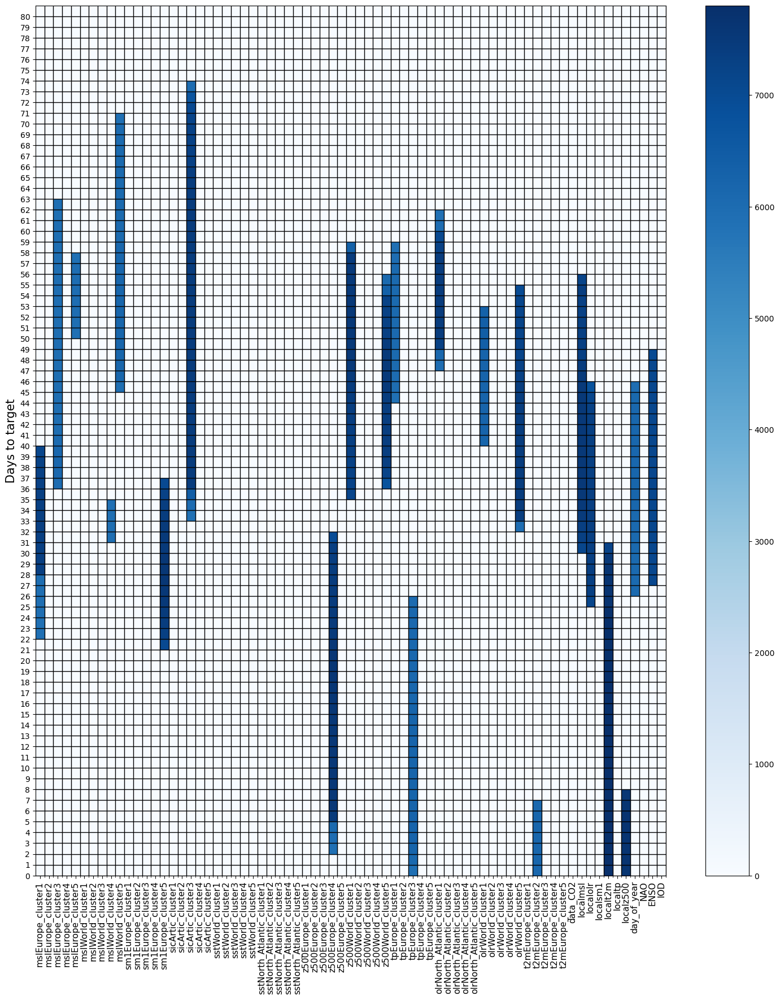

In [43]:

plt.figure(figsize=(18, 20))
plt.imshow(np.where(board_100/len(arrays) >0.75,board_100,0), cmap='Blues', origin='lower', aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90, fontsize=11)
plt.yticks(np.arange(board_100.shape[0]) - 0.5, np.arange(board_100.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=15)

for i in range(board_100.shape[1]):
    if np.sum(board_100[:, i]) == 0:
        rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
        plt.gca().add_patch(rect)
plt.colorbar()
plt.ylim(-0.5, np.nonzero(board_100.sum(axis=1))[0][-1]+0.5)
plt.show()

In [21]:
weighted_av = []
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=int(np.sum(board_100[:,i]*(1+np.arange(board_100.shape[0])))/np.sum(board_100[:,i]))-1
    weighted_av.append(av)
weighted_av

[27,
 37,
 75,
 43,
 69,
 49,
 46,
 44,
 78,
 48,
 53,
 36,
 21,
 51,
 36,
 44,
 43,
 35,
 30,
 59,
 26,
 48,
 64,
 49,
 14,
 16,
 27,
 39,
 19,
 38,
 -1,
 28,
 17,
 34,
 26,
 28,
 -1,
 20,
 112,
 37,
 14,
 33,
 50,
 27,
 51,
 45,
 28,
 23,
 59,
 53,
 46,
 43,
 57,
 33,
 45,
 26,
 59,
 59,
 55,
 45,
 40,
 23,
 17,
 7,
 30,
 8,
 36,
 37,
 34,
 62,
 56]

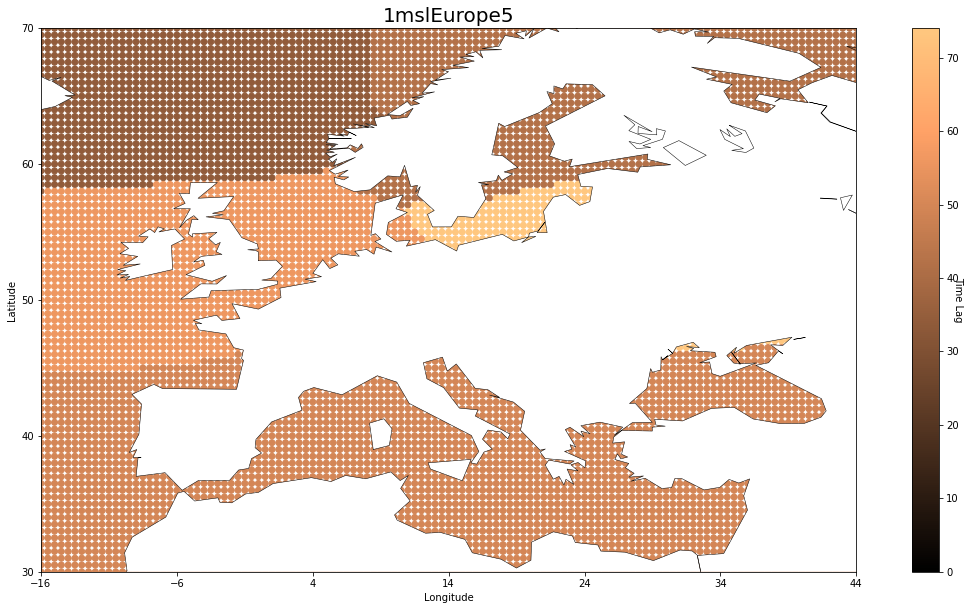

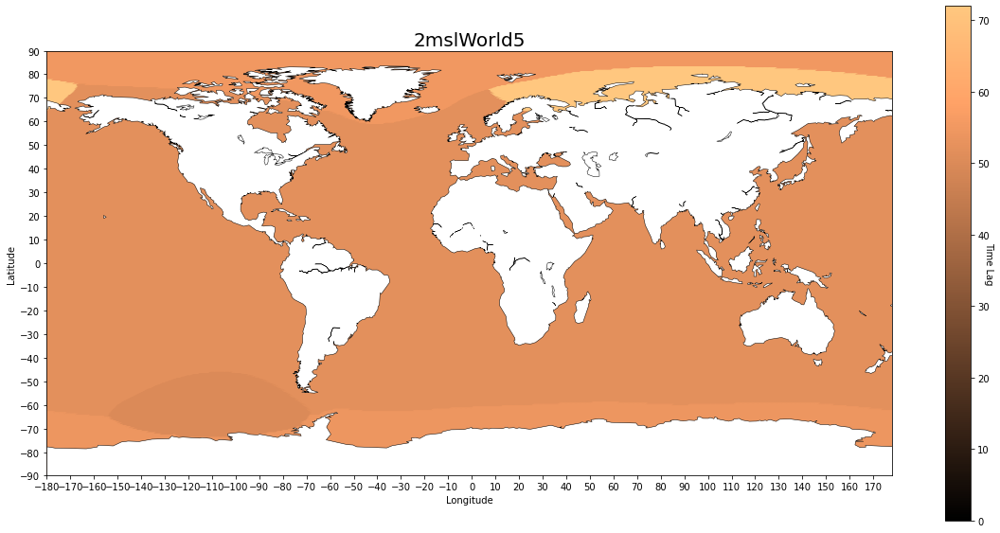

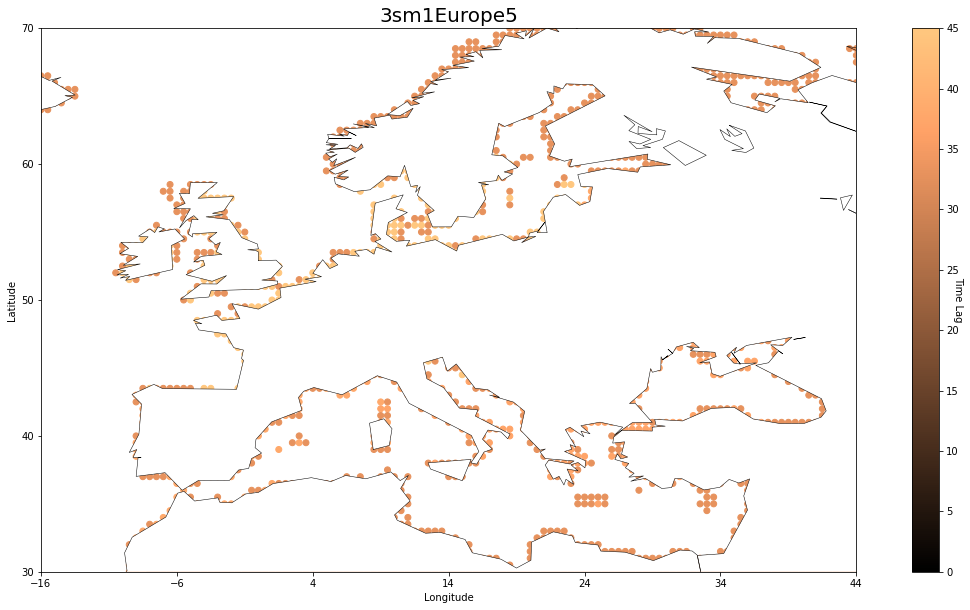

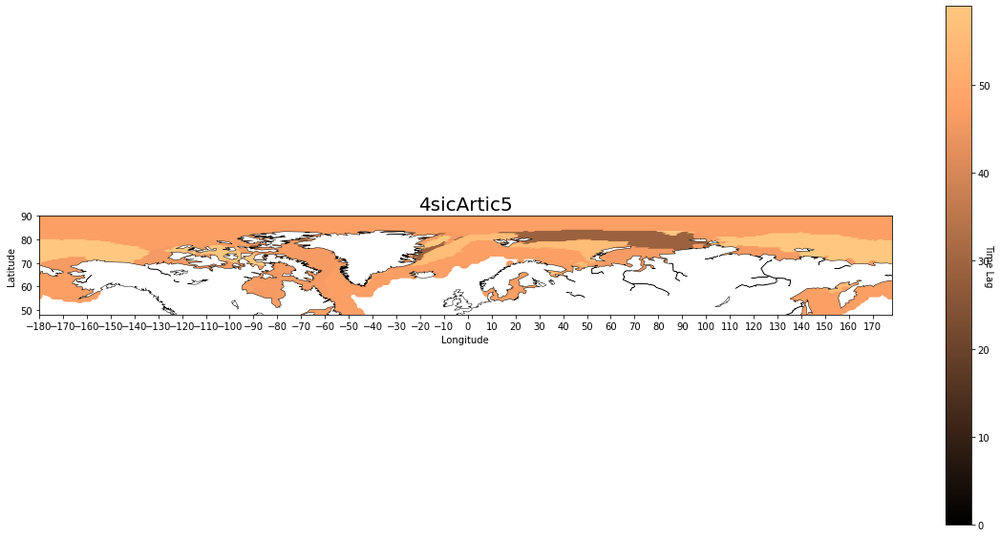

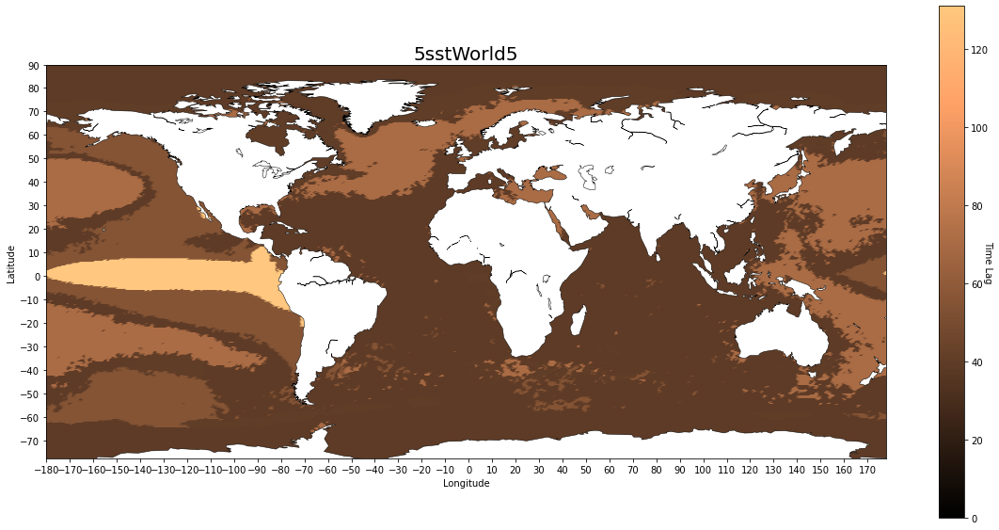

...

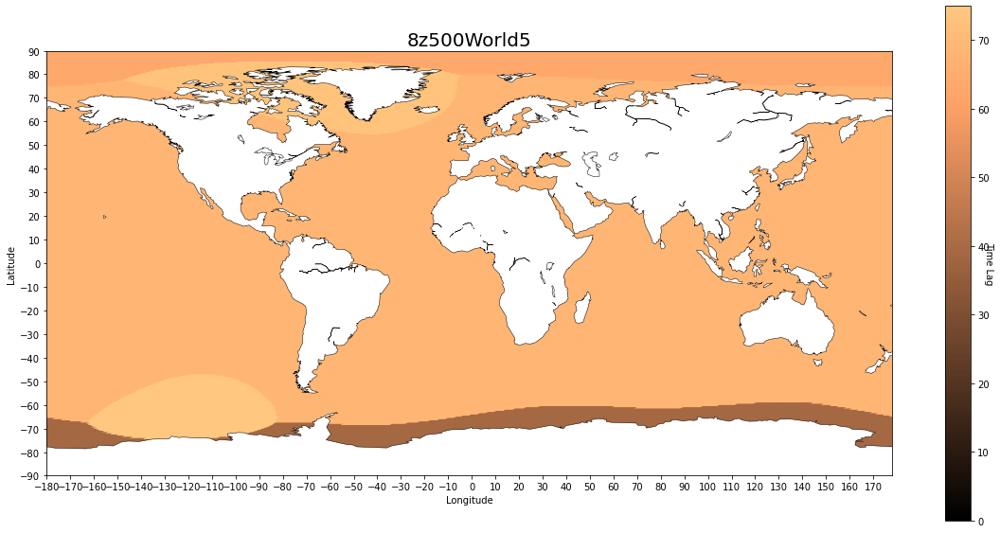

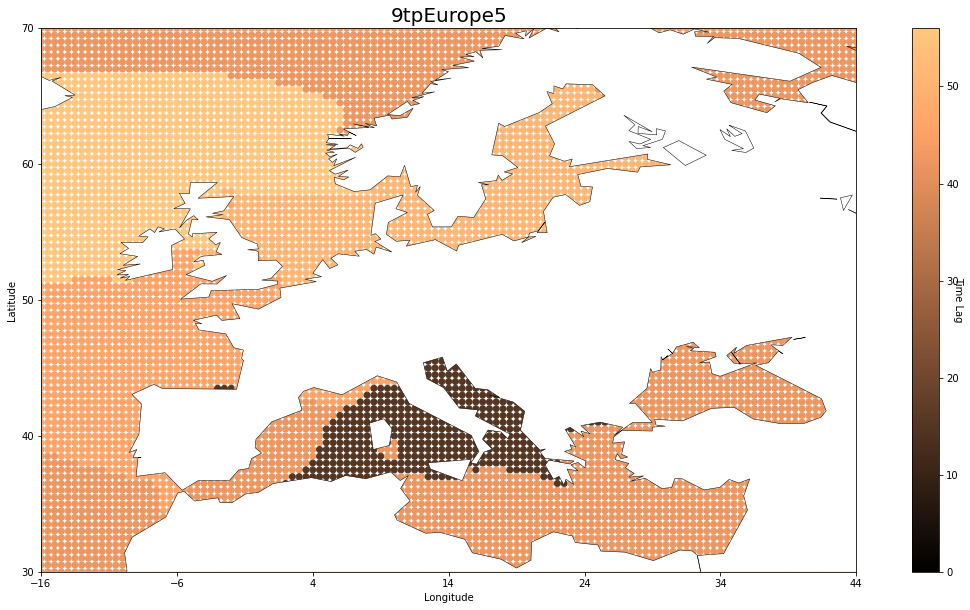

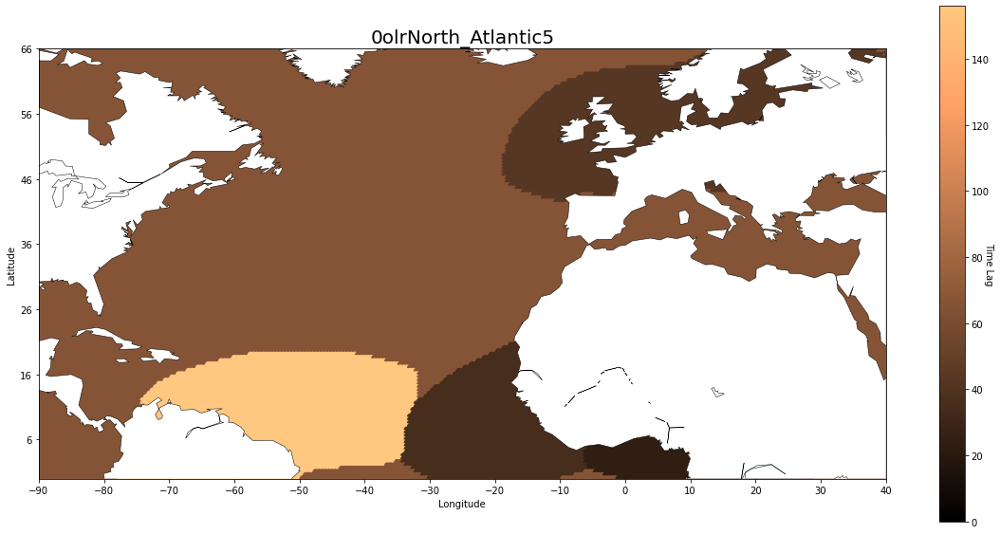

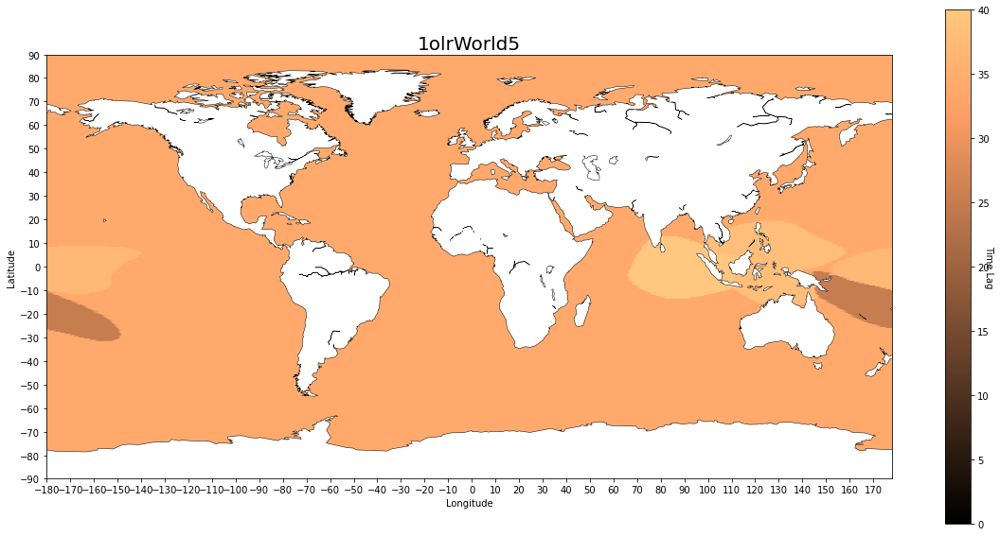

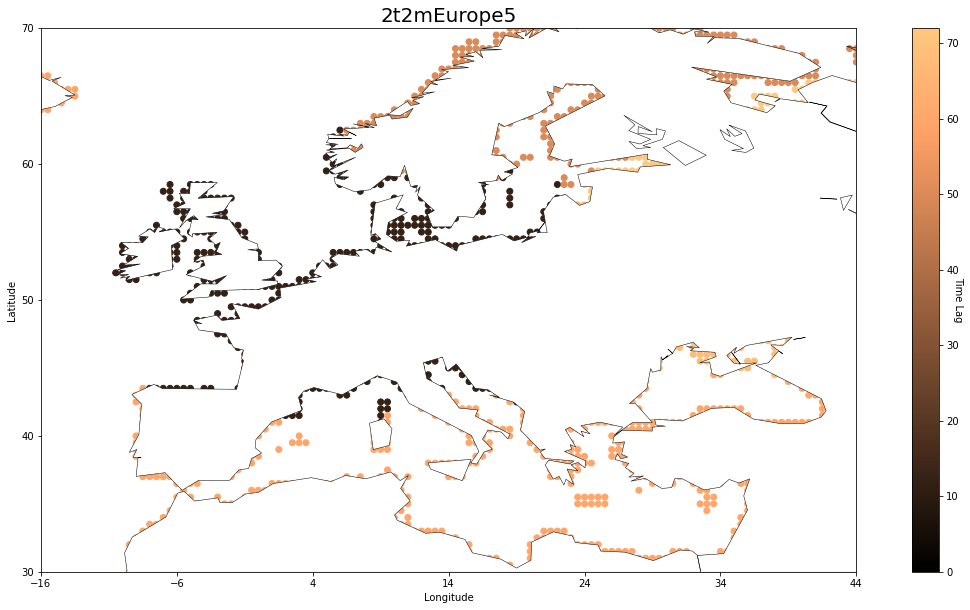

In [25]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, weighted_av[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=0.5)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=label_df['fin_seq'].max())

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [22]:
sequence_lengths = []

for i in range(board_100.shape[1]):
    col = board_100[:, i]  # Get the current column
    consecutive_count = 0  # Initialize consecutive count
    max_consecutive_count = 0  # Initialize maximum consecutive count

    for value in col:
        if value/len(arrays) > 0.25:
            consecutive_count += 1
        else:
            consecutive_count = 0  # Reset count if the value is 0

        # Update maximum consecutive count
        max_consecutive_count = max(max_consecutive_count, consecutive_count)

    sequence_lengths.append(max_consecutive_count)

# Now, 'sequence_lengths' contains the sequence lengths for each column
print(sequence_lengths)

[0, 0, 0, 6, 0, 32, 28, 3, 0, 0, 0, 12, 0, 0, 11, 20, 14, 8, 9, 7, 0, 0, 43, 26, 29, 0, 3, 7, 0, 39, 0, 0, 0, 0, 10, 0, 0, 0, 0, 39, 27, 5, 3, 13, 0, 14, 5, 50, 21, 9, 0, 23, 0, 3, 3, 0, 0, 5, 18, 32, 0, 39, 0, 15, 0, 19, 34, 9, 0, 0, 35]


In [23]:
first_max=[]
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=board_100.argmax(axis=0)[i]
    first_max.append(av)
first_max

[35,
 35,
 74,
 46,
 67,
 47,
 48,
 46,
 60,
 47,
 46,
 23,
 9,
 53,
 39,
 25,
 38,
 32,
 31,
 57,
 26,
 37,
 46,
 47,
 19,
 15,
 26,
 38,
 8,
 29,
 -1,
 13,
 9,
 25,
 26,
 25,
 -1,
 14,
 154,
 32,
 8,
 44,
 50,
 32,
 42,
 46,
 26,
 14,
 55,
 34,
 45,
 30,
 59,
 24,
 48,
 21,
 59,
 28,
 52,
 31,
 34,
 28,
 11,
 0,
 45,
 0,
 26,
 37,
 41,
 18,
 57]

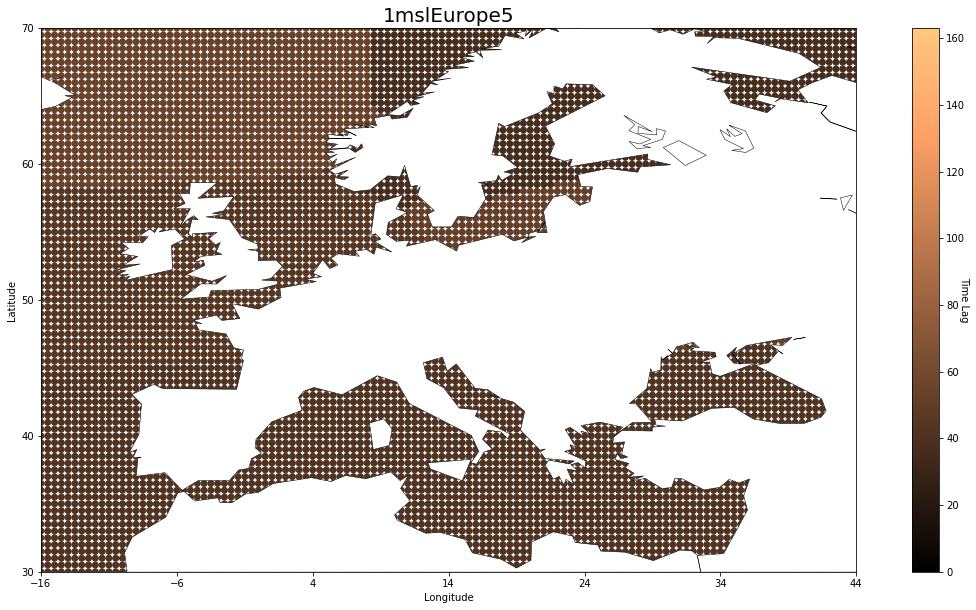

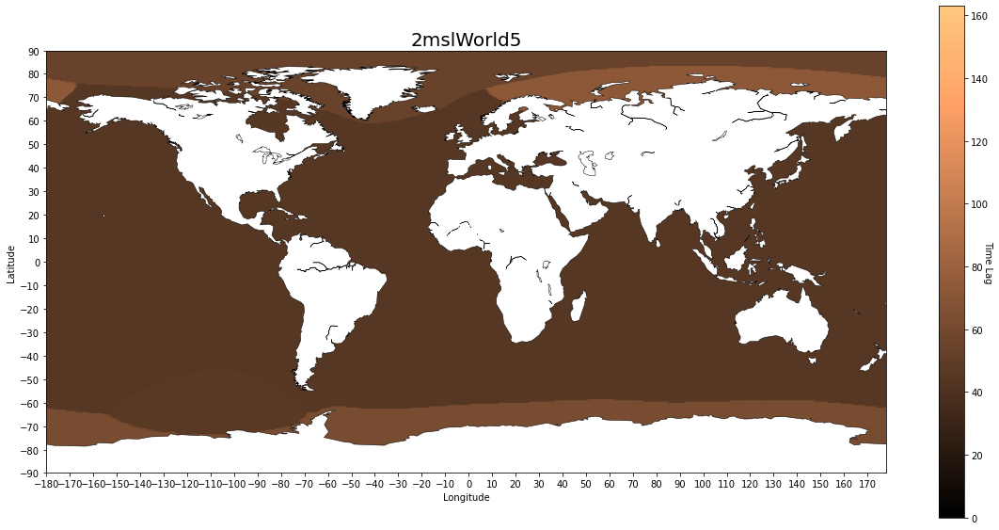

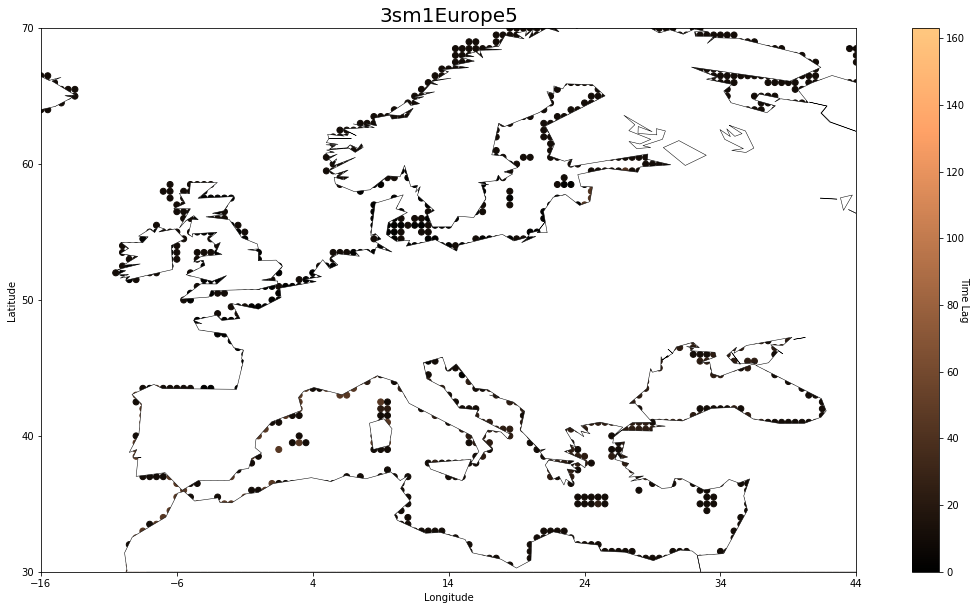

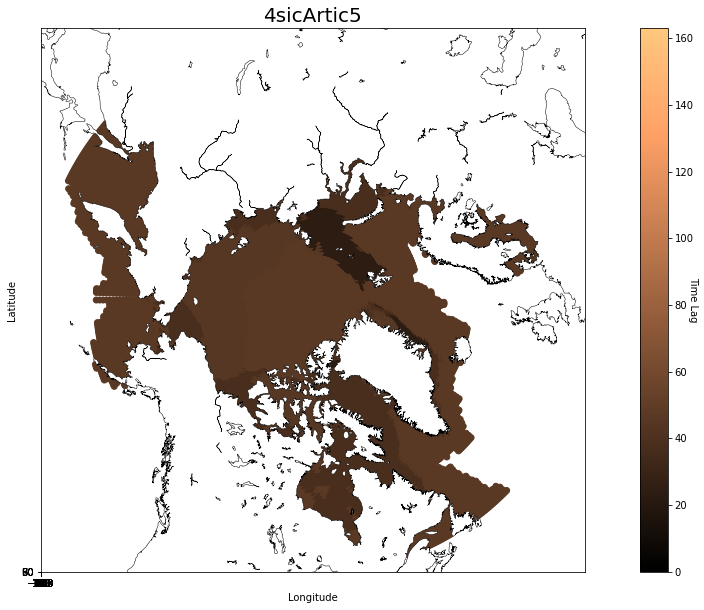

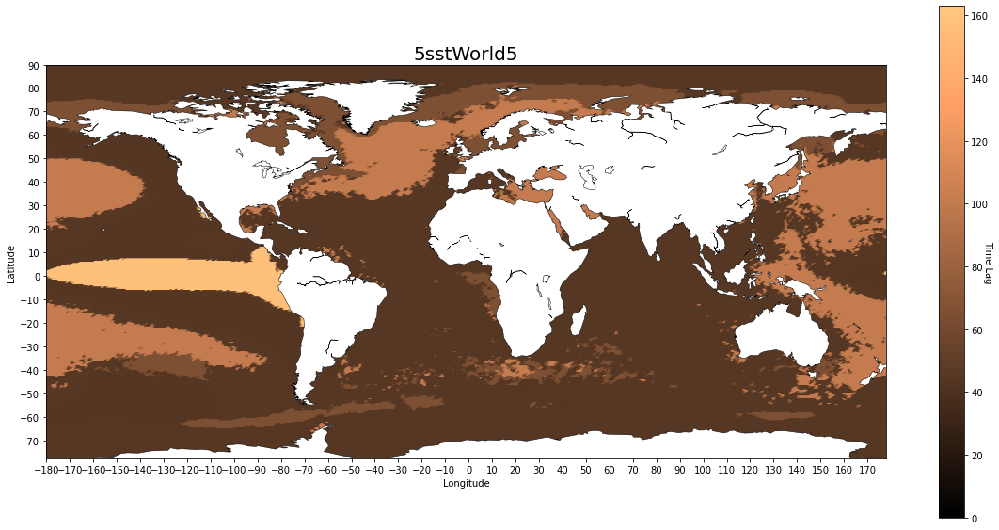

...

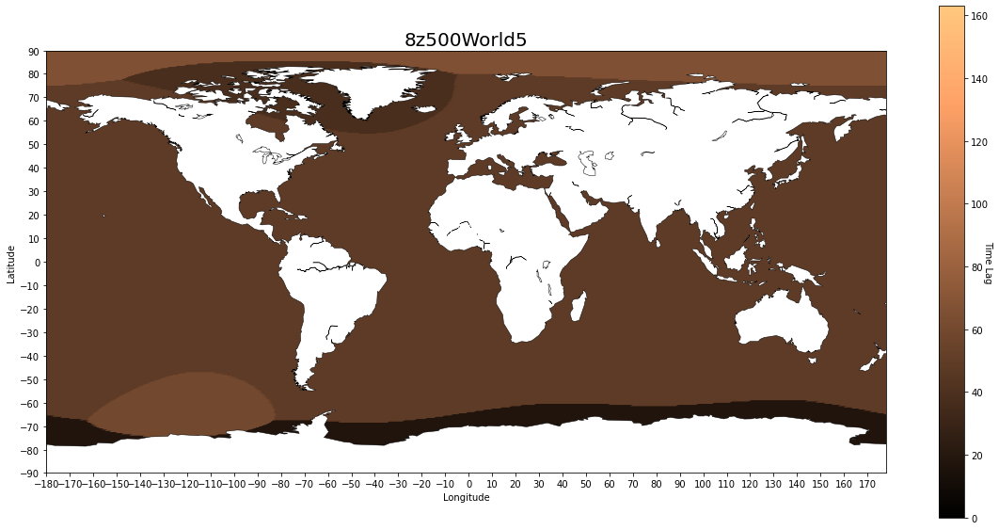

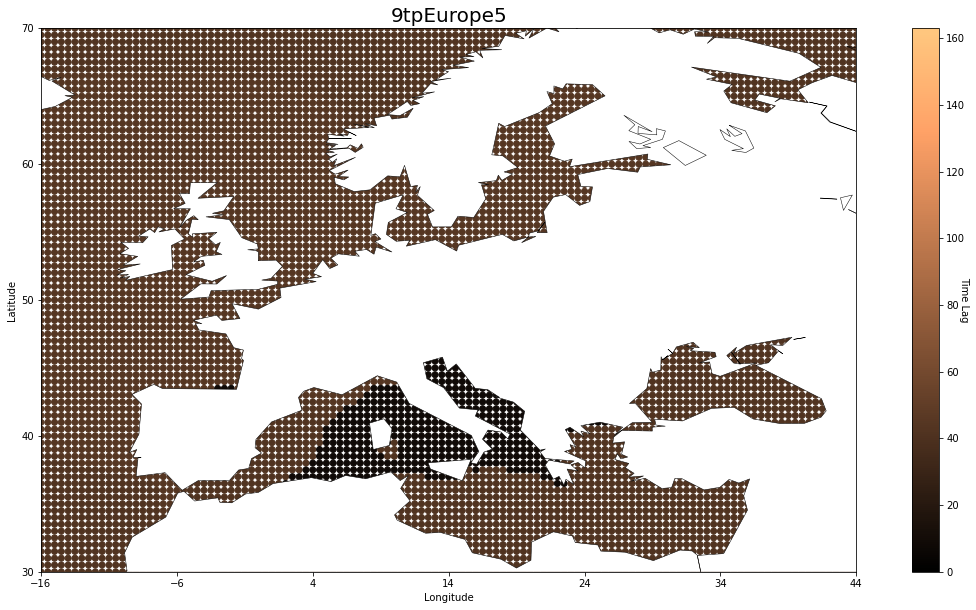

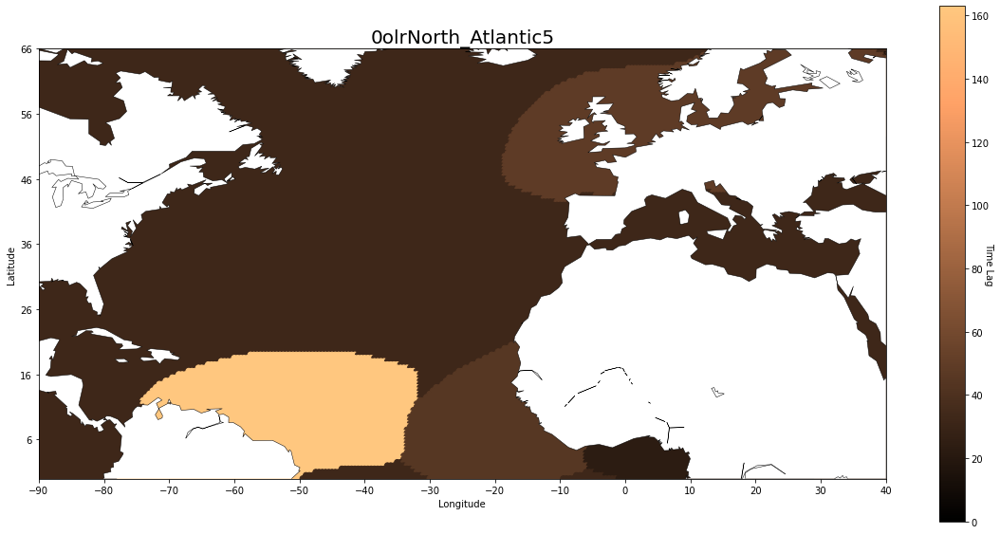

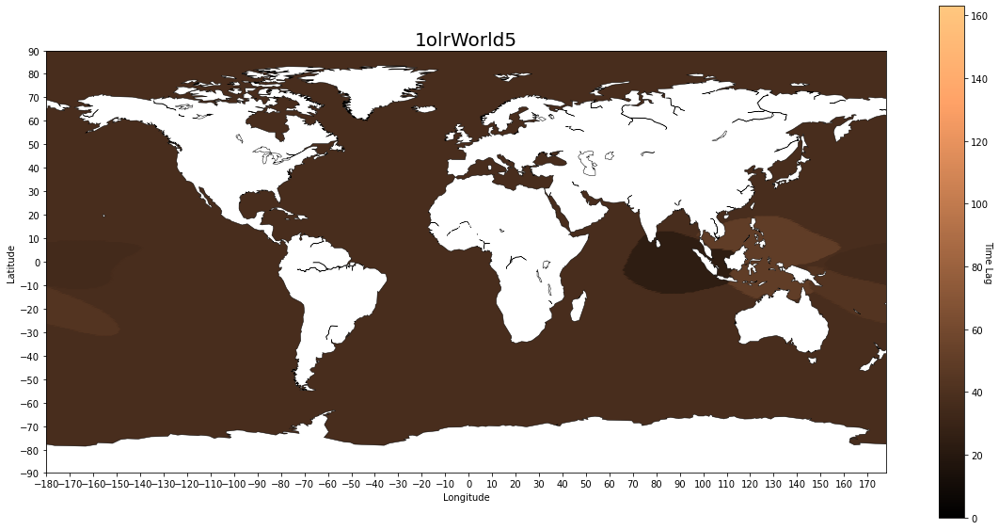

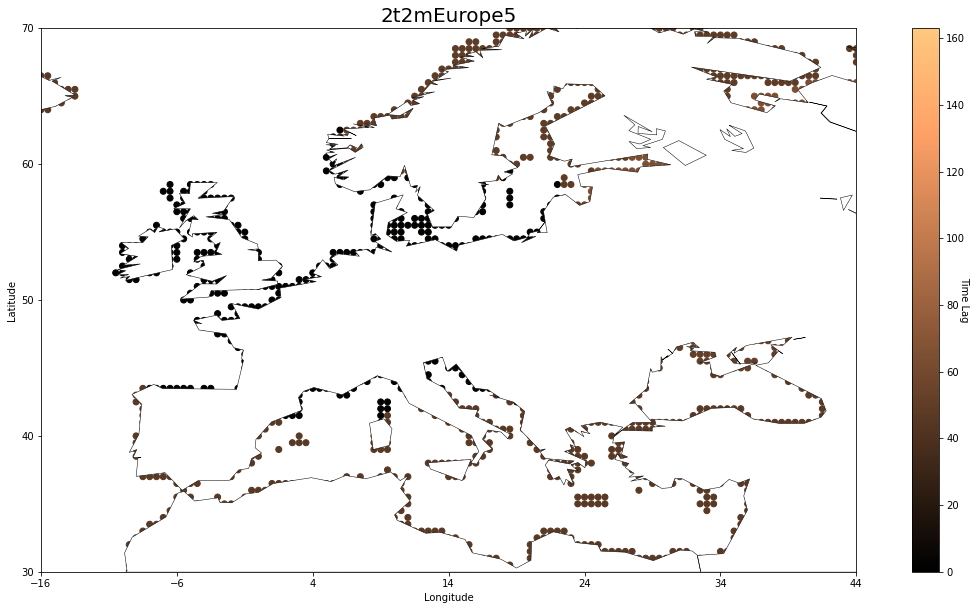

In [28]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, first_max[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels04sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    map.drawcoastlines(linewidth=0.5)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=np.array(first_max).max())

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=20)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

In [24]:
av_max=[]
for i in range(board_100.shape[1]):
    if np.sum(board_100[:,i])==0:
        av=-1
    else:
        av=[h for h, x in enumerate(board_100[:,i]) if x == max(board_100[:,i])]
    av_max.append(np.array(av).mean())
av_max


[35.0,
 35.0,
 74.0,
 46.0,
 67.0,
 48.0,
 48.0,
 46.0,
 60.5,
 47.0,
 50.0,
 23.0,
 14.5,
 53.0,
 39.0,
 25.0,
 38.0,
 32.0,
 31.0,
 57.0,
 26.0,
 37.0,
 46.0,
 47.0,
 20.5,
 15.0,
 26.0,
 38.0,
 11.2,
 29.0,
 -1.0,
 21.0,
 9.5,
 30.5,
 27.0,
 25.0,
 -1.0,
 14.0,
 154.0,
 32.0,
 8.5,
 44.0,
 50.0,
 32.0,
 45.0,
 46.0,
 26.0,
 14.0,
 55.0,
 34.0,
 45.0,
 30.0,
 59.0,
 24.0,
 48.0,
 21.0,
 59.0,
 28.0,
 52.0,
 31.0,
 35.5,
 28.0,
 11.0,
 0.0,
 45.0,
 0.0,
 27.5,
 37.0,
 41.0,
 18.0,
 57.0]

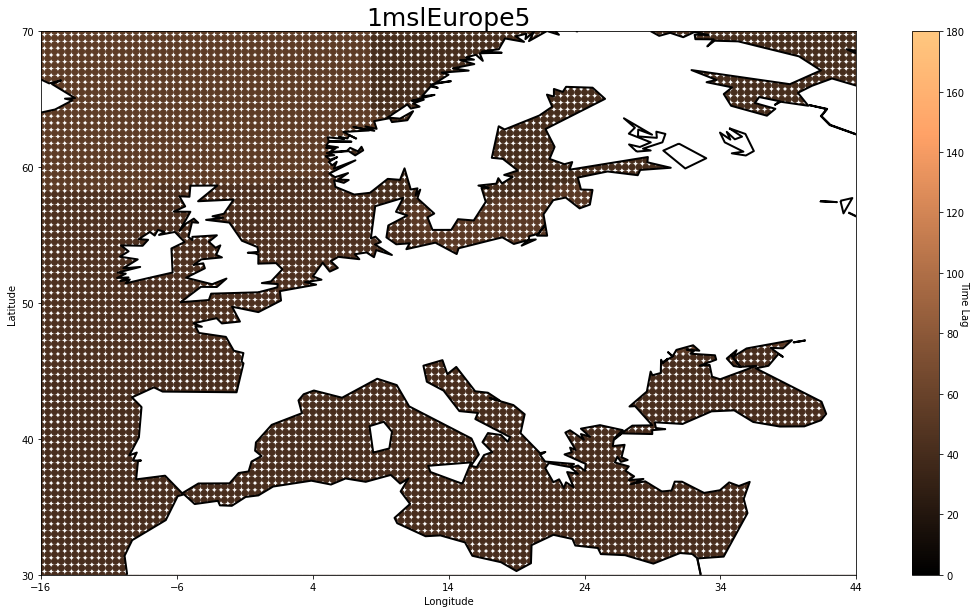

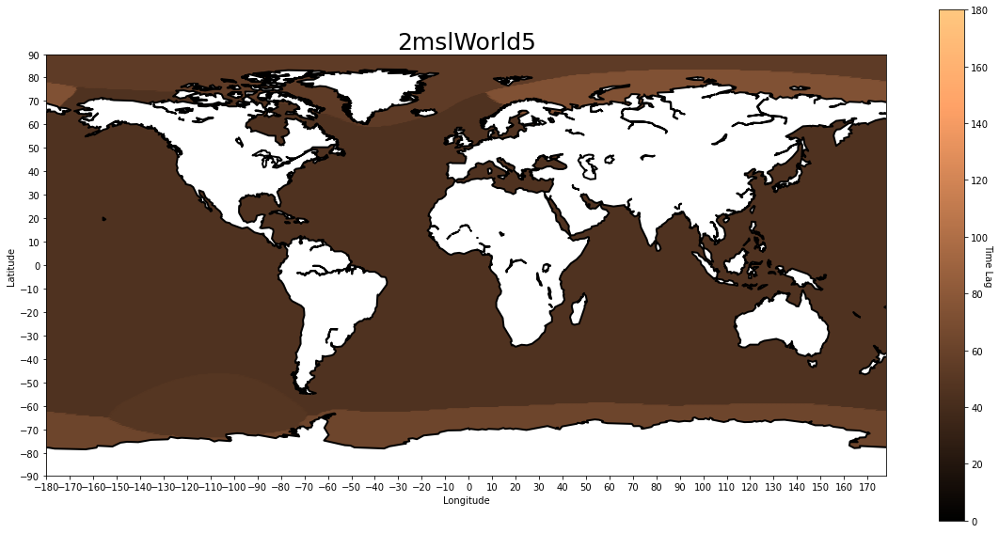

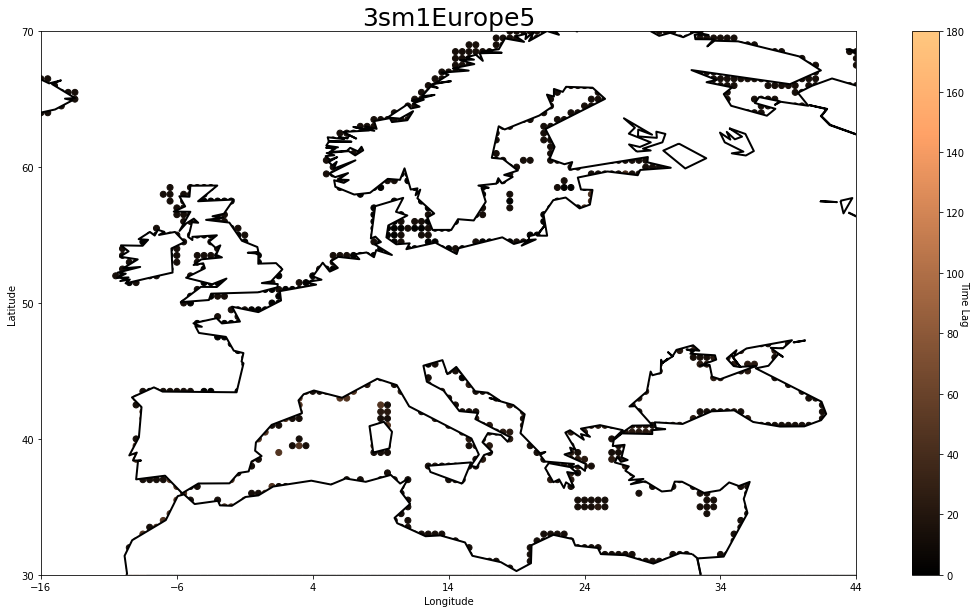

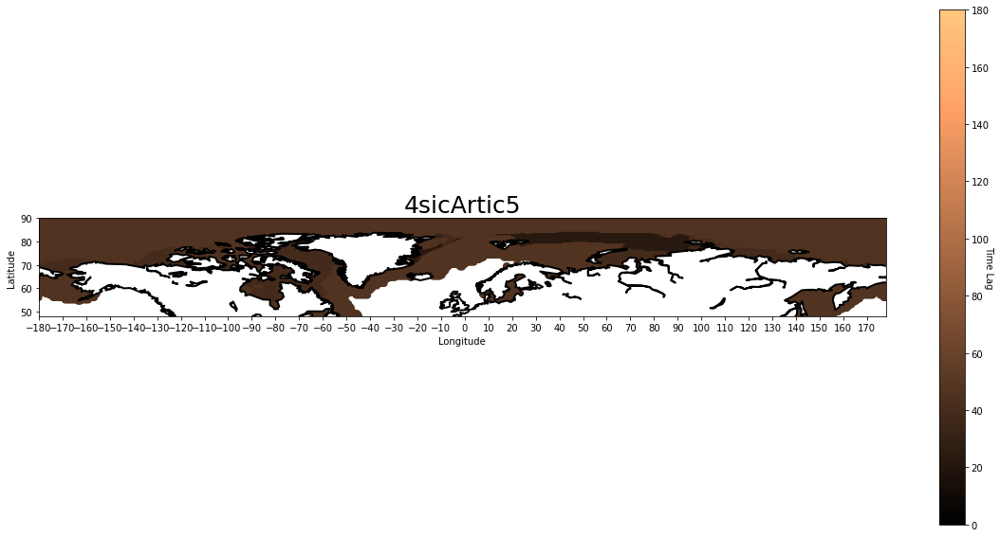

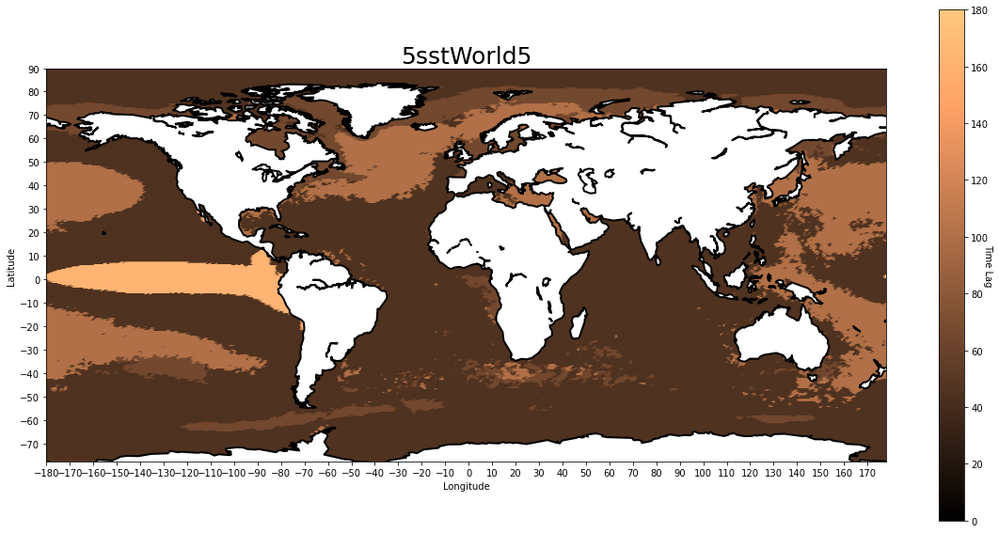

...

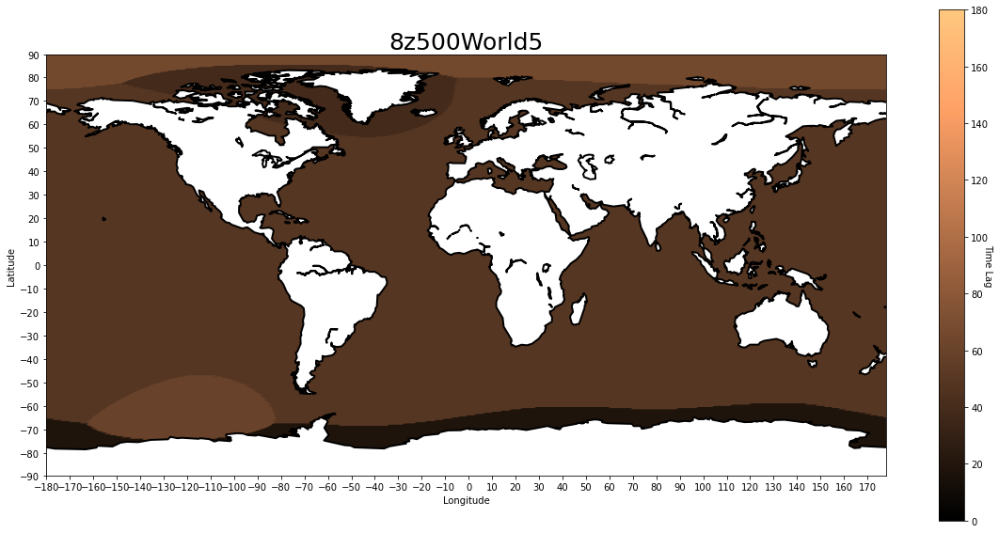

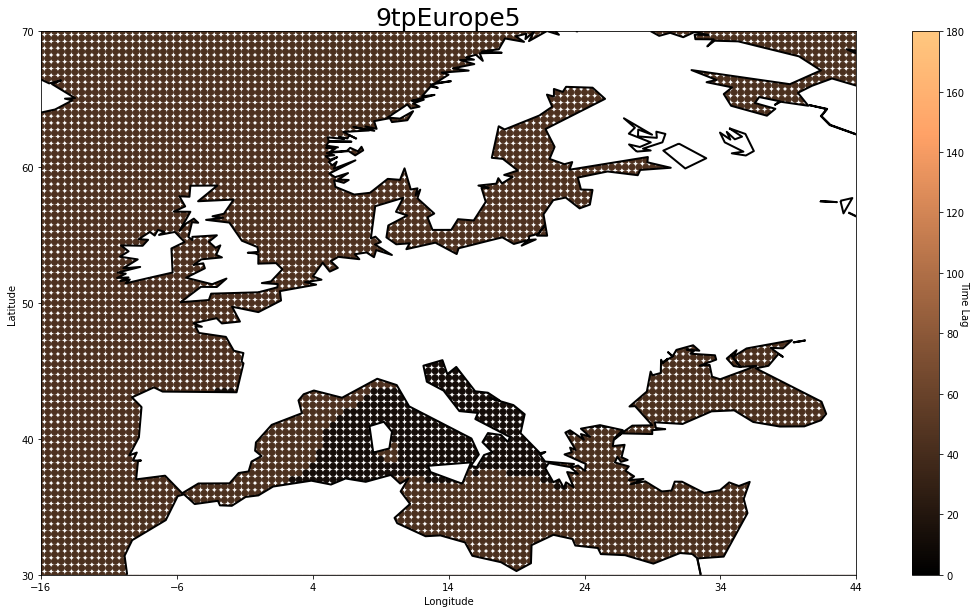

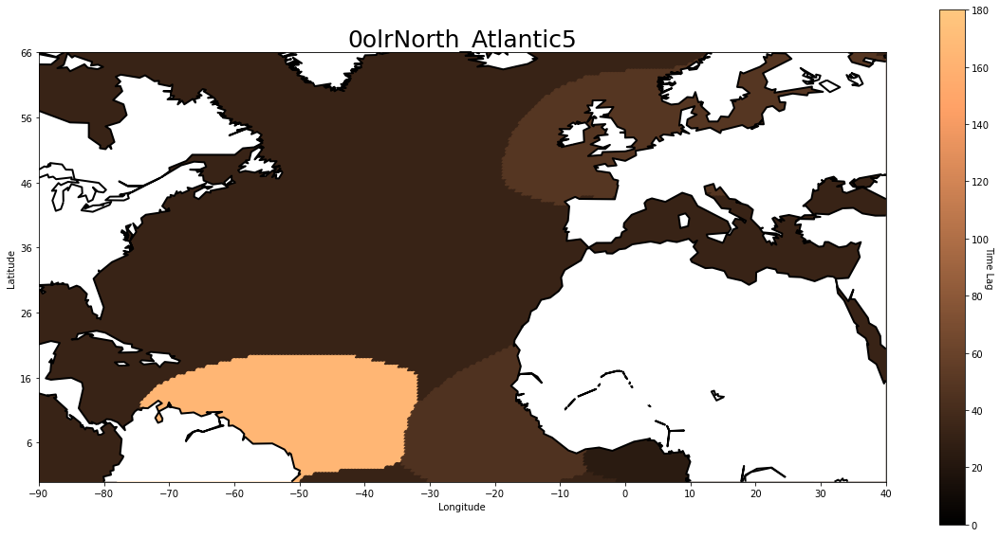

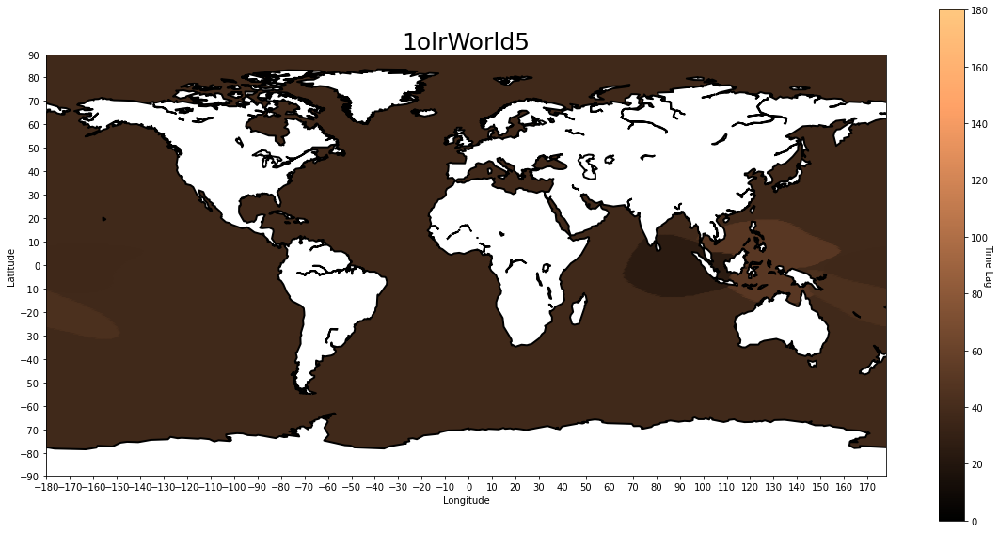

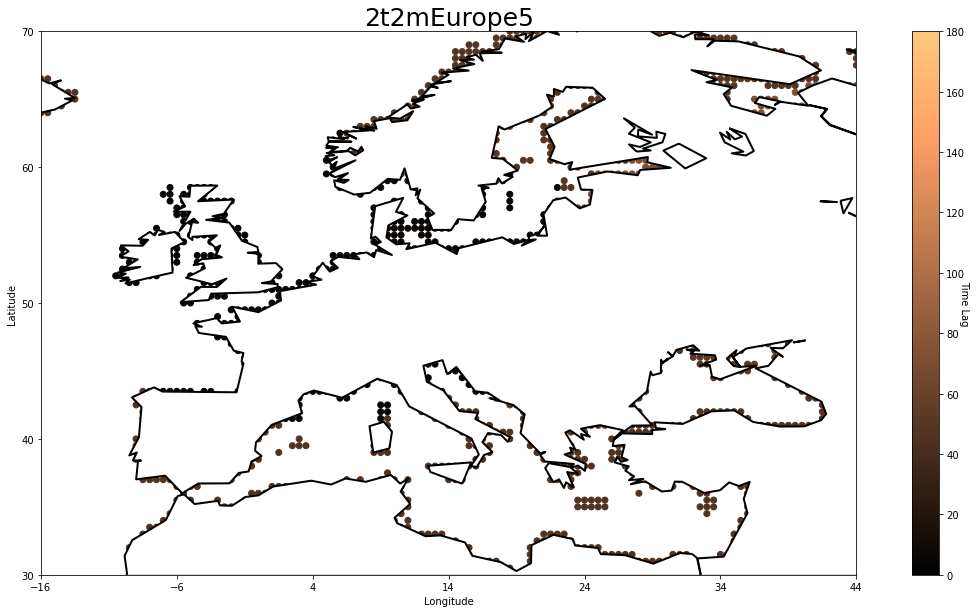

In [30]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, av_max[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels4sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    
    map.drawcoastlines(linewidth=2)
    map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='copper',vmin=0, vmax=180)

    cbar = plt.colorbar()
    cbar.set_label('Time Lag', rotation=270)
    plt.title(label_file[7:-4],fontsize=25)
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10))
    plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10))
    # Show the plot
    plt.show()

(-0.5, 71.5)

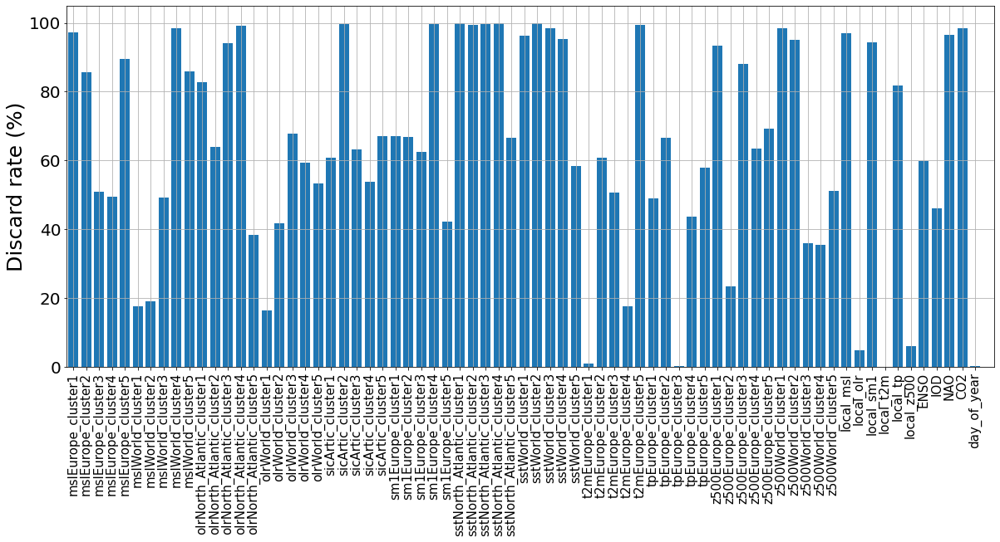

In [25]:
plt.figure(figsize=(20, 8))
plt.bar(pred_dataframe_opt.columns,discarded[0]*100/len(arrays))
plt.xticks(rotation = 90,fontsize=15)
plt.grid()
# plt.ylim(0,1)
plt.ylabel('Discard rate (%)',fontsize=25)
plt.yticks(fontsize=20)
plt.xlim(-0.5,pred_dataframe_opt.shape[1]+0.5)
# plt.savefig('./discard_rate_table.eps', format='eps', dpi=1000, bbox_inches = 'tight')

In [26]:
df_discarded = pd.DataFrame(discarded[0]*100/len(arrays),index=pred_dataframe_opt.columns,columns=['Discard rate (%)'])
df_discarded['Weighted average (days to target)'] = weighted_av
df_discarded['First maximum (days to target)'] = first_max
df_discarded['Sequence length (consecutive days > 25%)'] = sequence_lengths
df_discarded.sort_values(by=['Discard rate (%)'],ascending=True,inplace=True)

df_discarded

,Discard rate (%),Weighted average (days to target),First maximum (days to target),Sequence length (consecutive days > 25%)
local_t2m,0.000000,7,0,15
tpEurope_cluster3,0.126514,23,14,50
day_of_year,0.289174,56,57,35
t2mEurope_cluster1,0.921742,14,8,27
local_olr,4.771372,23,28,39
...,...,...,...,...
sicArtic_cluster2,99.674679,48,37,0
sm1Europe_cluster4,99.783119,19,8,0
sstNorth_Atlantic_cluster4,99.873486,34,25,0
sstWorld_cluster2,100.000000,-1,-1,0


In [109]:
df_discarded.head(15)

,Discard rate (%),Weighted average (days to target),First maximum (days to target),Sequence length (consecutive days > 25%)
localt2m,0.000000,16,0,34
z500World_cluster1,0.499680,46,50,27
t2mEurope_cluster2,0.525304,12,4,10
day_of_year,0.550929,33,35,35
tpEurope_cluster1,0.871236,50,51,27
olrNorth_Atlantic_cluster1,1.511851,51,53,34
localz500,1.716848,5,2,9
sm1Europe_cluster5,1.768097,30,28,18
localmsl,1.960282,39,37,44
sm1Europe_cluster3,2.126842,28,18,18


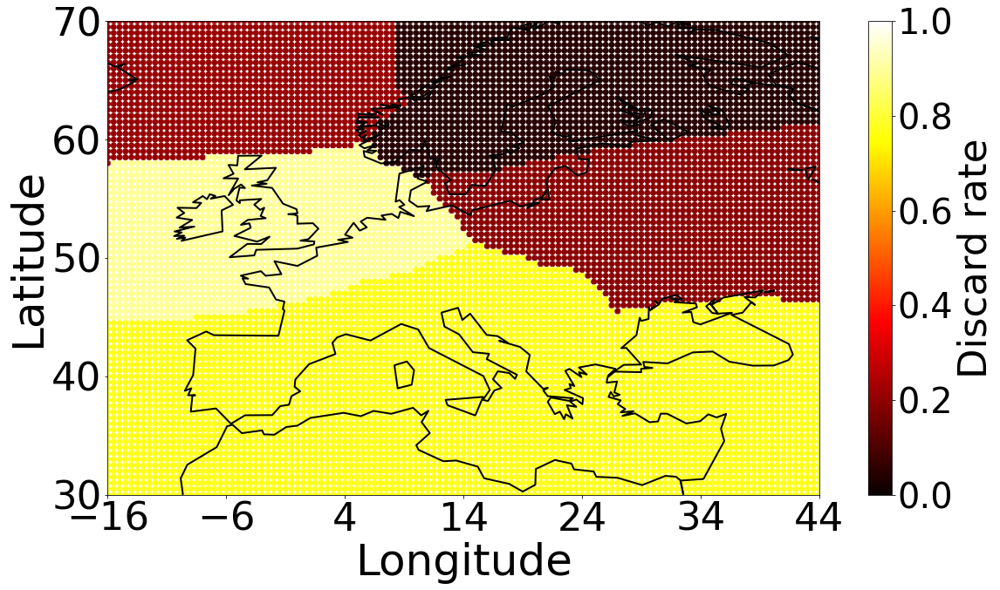

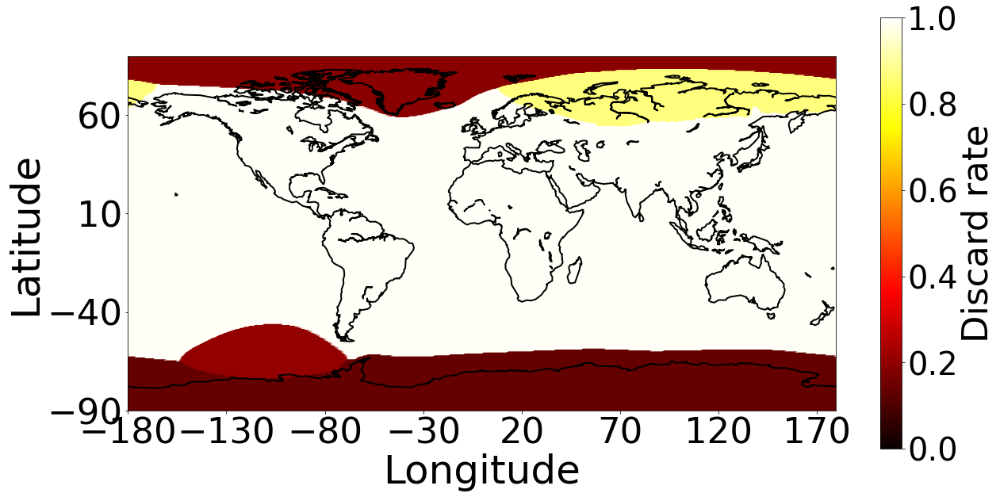

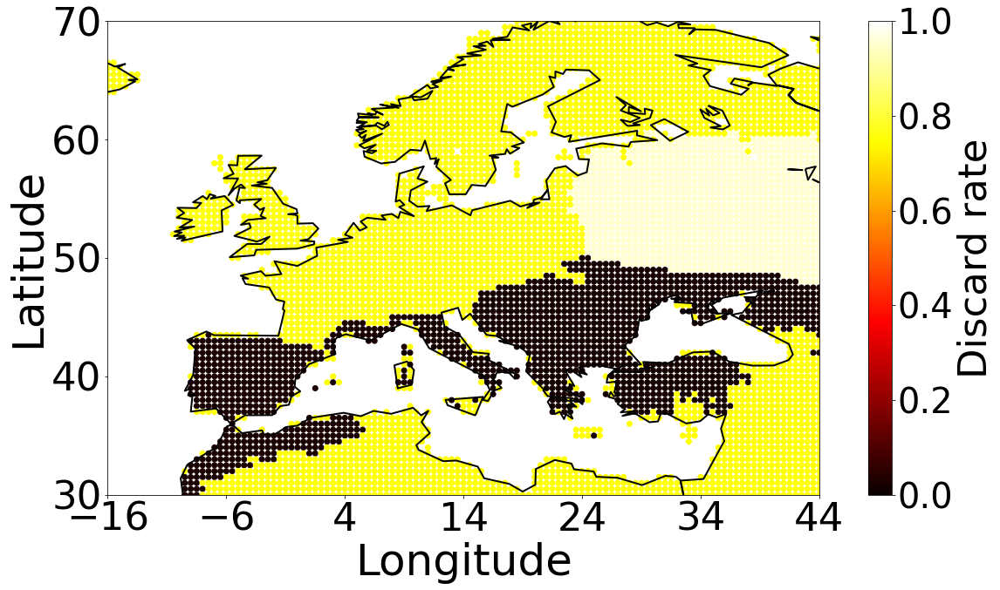

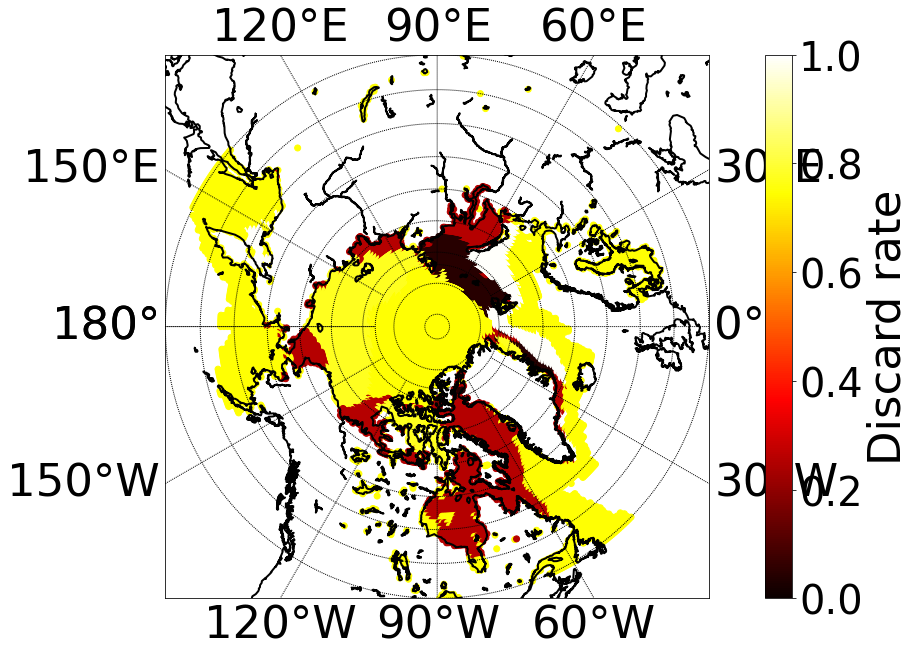

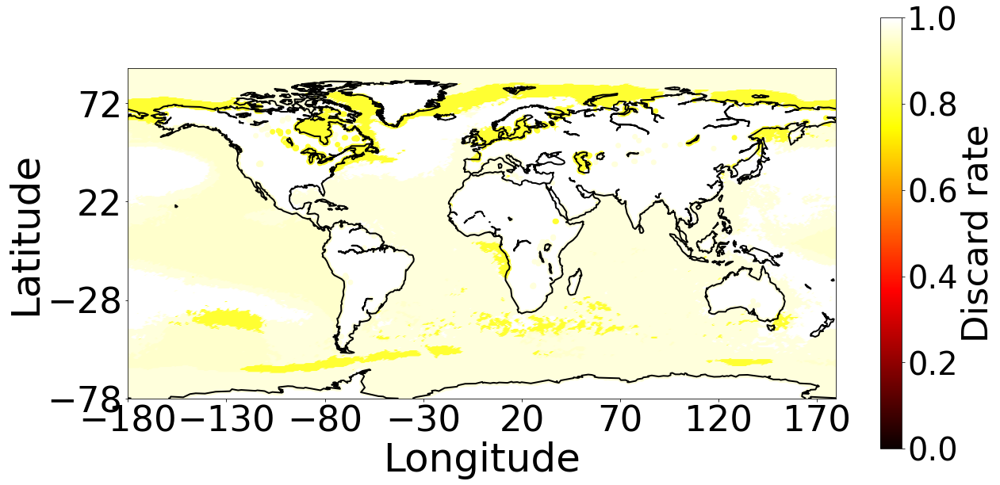

...

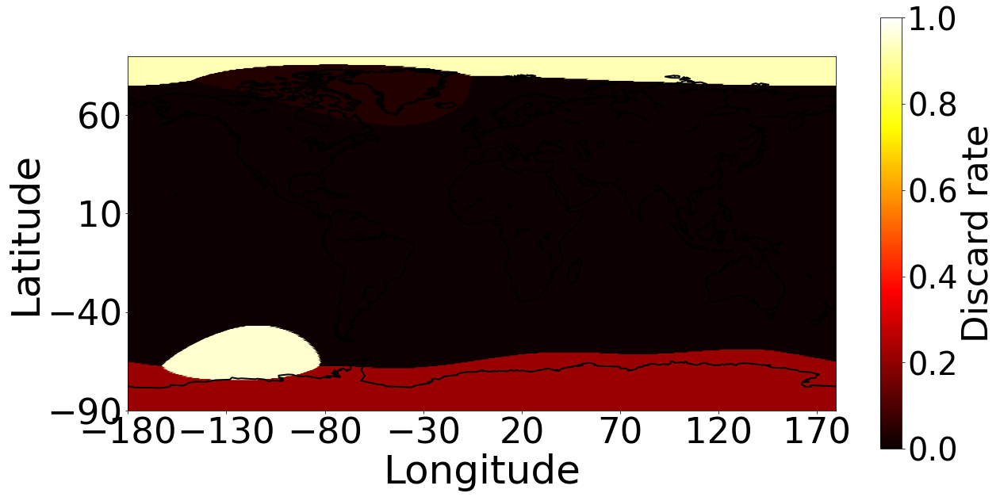

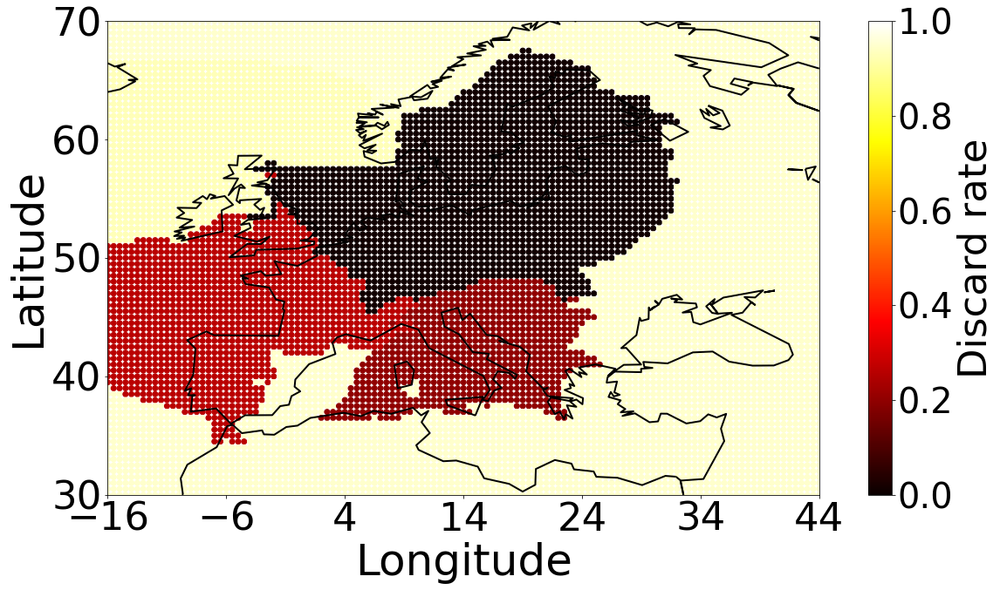

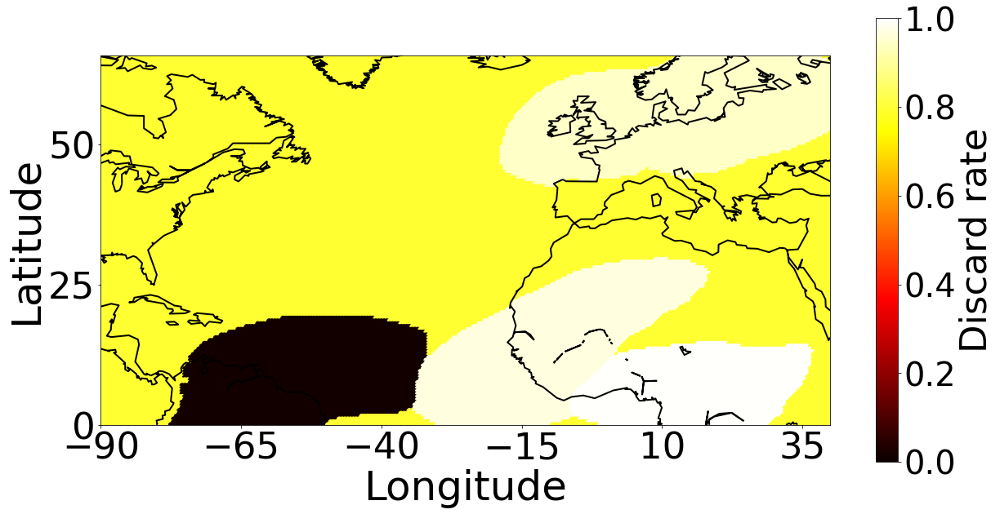

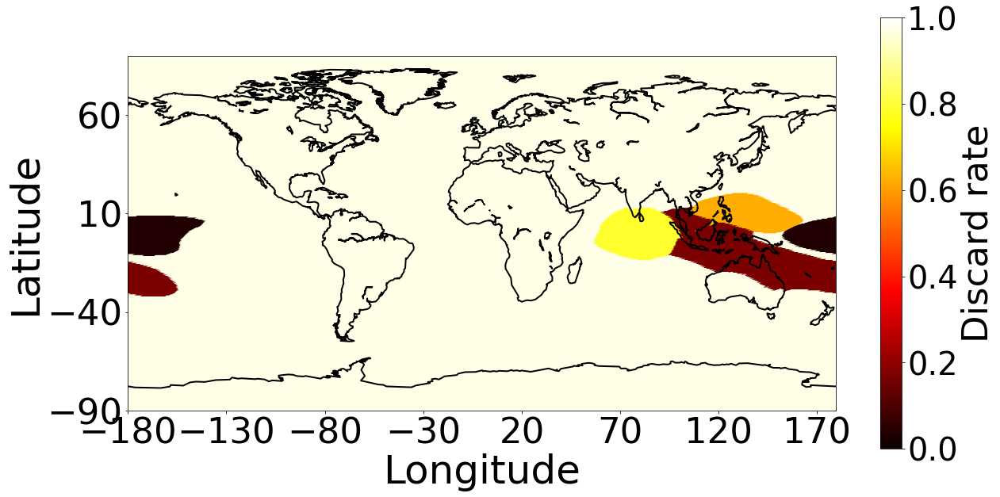

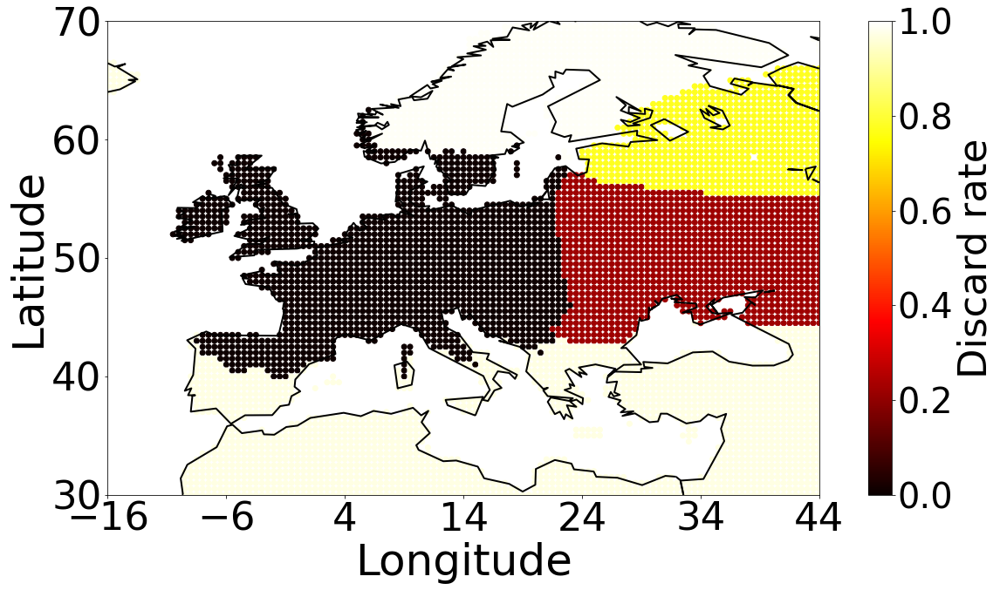

In [122]:
from mpl_toolkits.basemap import Basemap
h=0
for label_file in files_labels:
    label_df = pd.read_csv('../Predictors/'+experiment+'/labels/'+label_file,index_col=0)
    label_df['fin_seq'] = label_df['cluster']
    for i in range(0,len(np.unique(label_df['cluster']))):
        
        # if (discarded[0]/len(arrays))[h+i]==0:
        #     label_df['fin_seq'] = np.where(label_df['cluster'] == i, -1, label_df['fin_seq'])
        # else:
        label_df['fin_seq'] = np.where(label_df['cluster'] == i, (discarded[0]/len(arrays))[h+i], label_df['fin_seq'])
    h+=i+1
    plt.figure(figsize=(20, 10))
    if label_file == 'labels04sicArtic5.csv':
        map = Basemap(projection='npstere',boundinglat=48,lon_0=270,resolution='l')
    else:
        map = Basemap(projection='cyl',llcrnrlat=label_df['nodes_lat'].min(),urcrnrlat=label_df['nodes_lat'].max(), llcrnrlon=label_df['nodes_lon'].min(),urcrnrlon=label_df['nodes_lon'].max(),resolution='c')
    
    
    # map.drawcoastlines(linewidth=2)
    # map.fillcontinents(color='white', lake_color='white')
    x, y = map(label_df['nodes_lon'],label_df['nodes_lat'])
    map.scatter(x[label_df['fin_seq']!=-1], y[label_df['fin_seq']!=-1],c=label_df['fin_seq'][label_df['fin_seq']!=-1], cmap='hot',vmin=0, vmax=1)
    map.drawcoastlines(linewidth=2)
    cbar = plt.colorbar()
    for t in cbar.ax.get_yticklabels():
     t.set_fontsize(14)
    cbar.set_label('Discard rate', rotation=90,fontsize=45)
    cbar.ax.tick_params(labelsize=40)
    # cbar.set_label('Cluster',fontsize=50)
    # plt.title(label_file[7:-4],fontsize=30)
    # plt.xlabel('Longitude',fontsize=25)
    # plt.ylabel('Latitude',fontsize=25)
    # plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10),fontsize=20)
    # plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10),fontsize=20)
    # Show the plot
    
    if label_file=='labels04sicArtic5.csv':
        # plot xticks and yticks for npstere projection
        # map.drawmeridians(np.arange(-180.,181.,20.), labels=[True, True, True, True])
        parallels = np.arange(48., 91., 5.)  # Define your latitude ticks
        meridians = np.arange(-180., 181., 30.)  # Define your longitude ticks

        # Draw parallels and meridians
        map.drawparallels(parallels, labels=[False, False, False, False],)
        map.drawmeridians(meridians, labels=[True, True, True, True],fontsize=45)


    elif (label_df['nodes_lon'].min() == -180) :
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 50),fontsize=45)
        plt.yticks(np.arange(label_df['nodes_lat'].min(), label_df['nodes_lat'].max()+2,50),fontsize=45)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)
    elif  (label_df['nodes_lon'].min() == -90):
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 25),fontsize=45)
        plt.yticks(np.arange(label_df['nodes_lat'].min(), label_df['nodes_lat'].max()+2,25),fontsize=45)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)
    else:
        plt.xticks(np.arange(label_df['nodes_lon'].min(), label_df['nodes_lon'].max()+2, 10),fontsize=45)
        plt.yticks(np.arange(label_df['nodes_lat'].max(), label_df['nodes_lat'].min()-2,-10),fontsize=45)
        plt.xlabel('Longitude',fontsize=50)
        plt.ylabel('Latitude',fontsize=50)


    # Show the plot
    # plt.savefig('../Predictors/'+experiment+'/labels/'+label_file[:-4]+'.eps', format='eps', dpi=1000, bbox_inches='tight')
    plt.savefig('./Discard'+label_file[:-4]+'.png', format='png', dpi=250, bbox_inches='tight')
    plt.show()


    plt.show()

### ML

In [352]:
pred_dataframe.index[0]

Timestamp('1950-01-01 00:00:00')

In [362]:
pred_dataframe['sstWorld_cluster1']

1950-01-01   -0.250796
1950-01-02   -0.240729
1950-01-03   -0.237795
1950-01-04   -0.230869
1950-01-05   -0.225861
                ...   
2022-12-27    9.533328
2022-12-28    9.538412
2022-12-29    9.525040
2022-12-30    9.520077
2022-12-31    9.518884
Name: sstWorld_cluster1, Length: 26663, dtype: float64

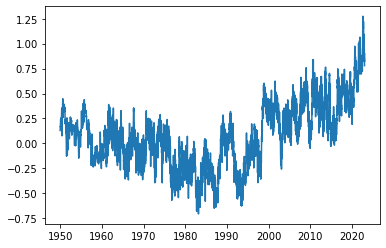

In [31]:
# plt.plot(pred_dataframe.index,pred_dataframe['tpEurope_cluster1'])
plt.plot(pred_dataframe.index,pred_dataframe['sstWorld_cluster2'])
# plt.plot(pred_dataframe.index,pred_dataframe['z500World_cluster3'])
# plt.plot(pred_dataframe.index,pred_dataframe['z500World_cluster4'])
# plt.plot(pred_dataframe.index,pred_dataframe['z500World_cluster5'])
# plt.plot(pred_dataframe.index,pred_dataframe['z500Europe_cluster1'])
# # plt.xlim([pred_dataframe.index[3000],pred_dataframe.index[7000]])

In [27]:
pred_dataframe = pd.read_csv(pred_path+pred_file, index_col=0)
# pred_dataframe = pd.read_csv('../Predictors/'+experiment+'/locals_variables.csv', index_col=0)
pred_dataframe.index = pd.to_datetime(pred_dataframe.index)
target_dataset = pd.read_csv(pred_path+'/target.csv', index_col=0)
target_dataset.index = pd.to_datetime(target_dataset.index)

first_train = 1951
last_train = 2010


train_indices = (target_dataset.index.year >=first_train) & (target_dataset.index.year <=last_train)
test_indices = (target_dataset.index.year >last_train)

In [27]:
# train_indices = train_indices[:,0]
# test_indices = test_indices[:,0]

In [32]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_best.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

In [33]:
# from functions import forecast_plots
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error,precision_score, accuracy_score, confusion_matrix, classification_report, recall_score, f1_score
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               FixedLocator)

In [34]:

def forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title):
    # Plotting
    
    fig, axs = plt.subplots(2, 2, figsize=(12, 8))

    # First subplot: Monthly line plot
    axs[0, 0].plot(monthly_sum_test.index, monthly_sum_test, label='True')
    axs[0, 0].plot(monthly_sum_test.index, monthly_sum_pred, label='Predicted')
    axs[0, 0].set_xlabel('Time')
    axs[0, 0].set_ylabel('Monthly sum of HW')
    axs[0, 0].legend()
    axs[0, 0].set_title('Monthly sum')

    # Second subplot: Monthly scatter plot
    axs[0, 1].scatter(monthly_sum_test, monthly_sum_pred)
    axs[0, 1].plot([0, max(monthly_sum_test)], [0, max(monthly_sum_test)], ls="--", c=".3")
    axs[0, 1].set_xlabel('True')
    axs[0, 1].set_ylabel('Predicted')
    axs[0, 1].set_title('Monthly sum')

    # Third subplot: Yearly line plot
    axs[1, 0].plot(year_sum_test.index.year, year_sum_test, label='True')
    axs[1, 0].plot(year_sum_test.index.year, year_sum_pred, label='Predicted')
    axs[1, 0].set_xlabel('Time')
    axs[1, 0].set_ylabel('Yearly sum of HW')
    axs[1, 0].legend()
    axs[1, 0].set_title('Yearly sum')

    # Fourth subplot: Yearly scatter plot
    axs[1, 1].scatter(year_sum_test, year_sum_pred)
    axs[1, 1].plot([0, max(year_sum_test)], [0, max(year_sum_test)], ls="--", c=".3")
    axs[1, 1].set_xlabel('True')
    axs[1, 1].set_ylabel('Predicted')
    axs[1, 1].set_title('Yearly sum')

    # Add a title to the Figure
    fig.suptitle(title)

    # Adjust the spacing between subplots
    plt.tight_layout()

    # Display the subplots
    plt.show()



In [35]:
def plotter(x,y,array1, array2, method):
    fig,ax=plt.subplots(figsize=(8,7))
    plt.title("{0}".format(method))

    plt.pcolormesh(y,x,array2,cmap='binary')
    for i in range(x.size):
        for j in range(y.size-1):
            if array1[i,j]==1:
                #print (j,i)
                plt.plot(y[j]+0.5,x[i],'ro')
    plt.xticks(range(2011,2023,1))
    plt.ylim([0,123])
    ticks=np.array([0,31,31+30,31+30+31])+15
    plt.yticks(ticks,["May","Jun","Jul","Aug"],rotation=45)
    ax.yaxis.set_minor_locator(FixedLocator(ticks-15))
    ax.xaxis.set_minor_locator(FixedLocator(np.arange(2011,2023,1)+0.5))
    ax.tick_params(which='minor',width=1)

    plt.xlim([2010.5,2022.5])
    plt.grid(axis='y',which='minor')
    plt.grid(axis='x',which='minor')
    plt.show()

x=np.arange(123)
y=np.arange(2010.5,2023.5,1)

#### Best Solution

In [131]:
train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

In [132]:
X_train = np.array(X_train)[:,board_best.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_best.T.reshape(1,-1)[0].astype(bool)]

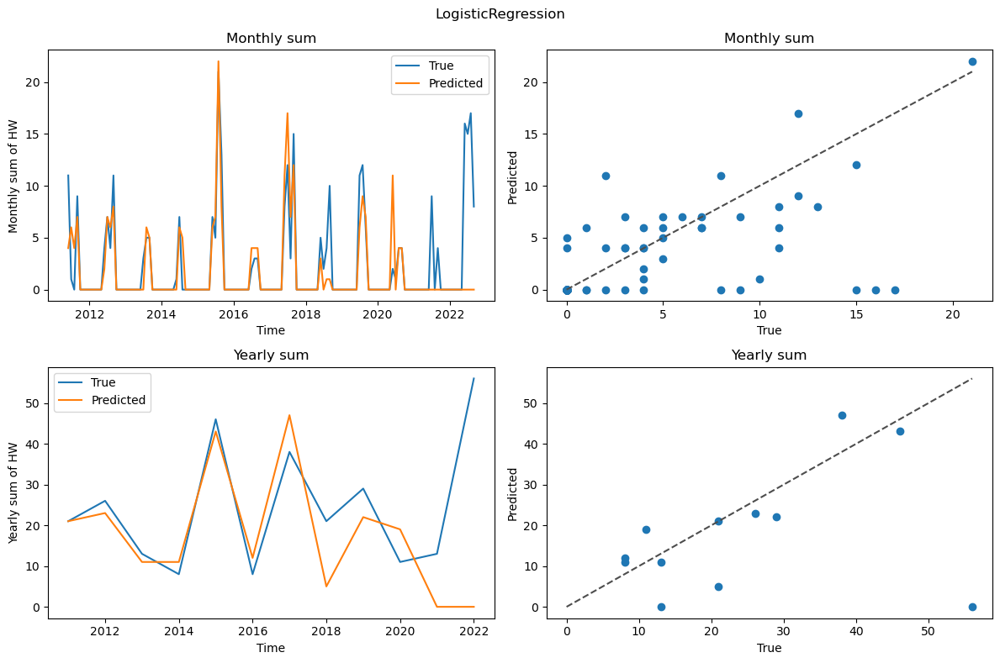

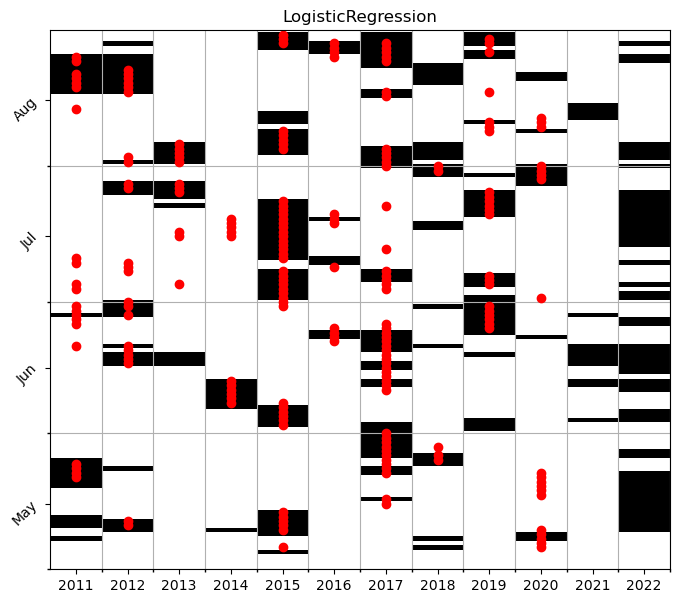

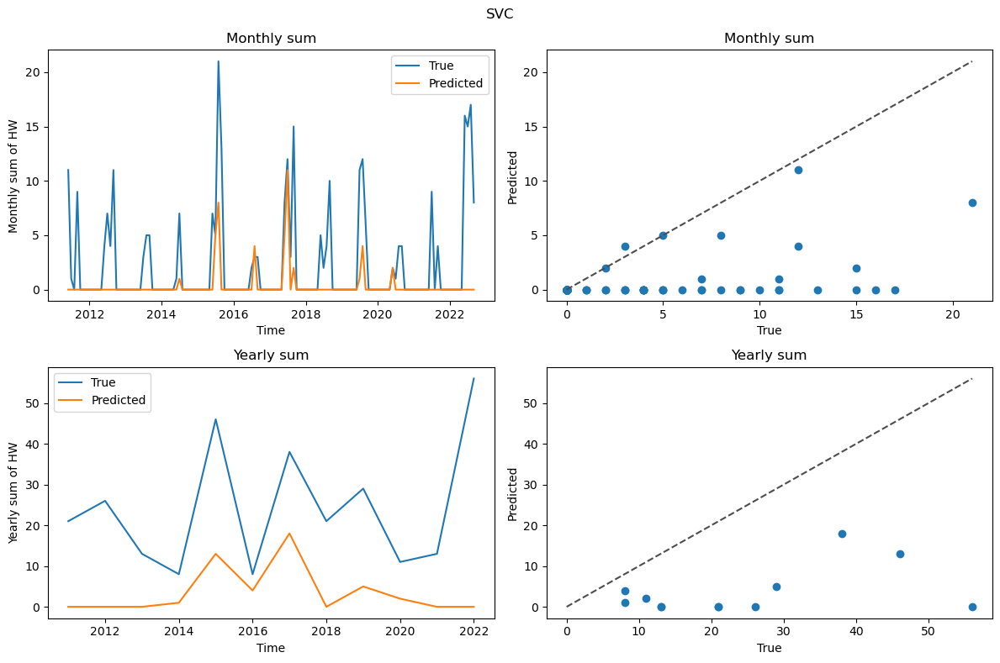

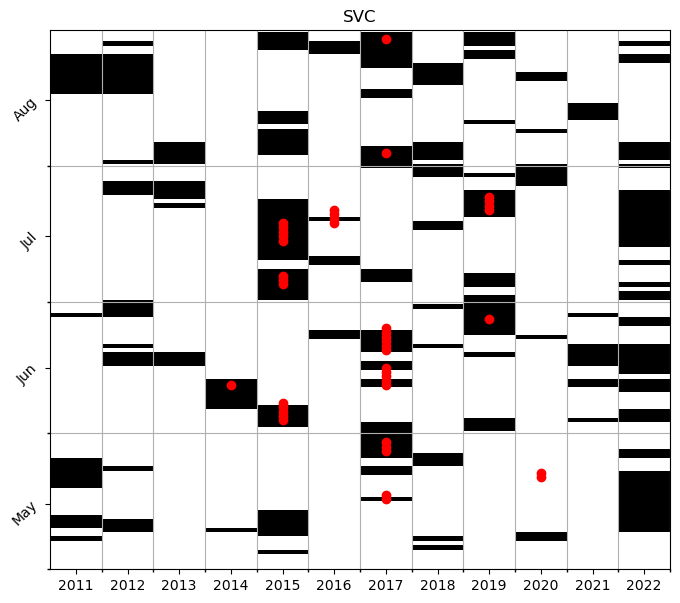

KeyboardInterrupt: 

In [151]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]

    
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)
    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [ ]:
from functions import divide_variables_deep,deep_learning_model

In [ ]:
#DL 
X_train_deep ,Y_train_deep,X_test_deep,Y_test_deep = divide_variables_deep(pred_dataframe,target_dataset,train_indices,test_indices,Y_column,time_lags,time_sequences,False)
model_RNN = deep_learning_model(X_train_deep,Y_train_deep,'RNN',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_LSTM = deep_learning_model(X_train_deep,Y_train_deep,'LSTM',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_GRU = deep_learning_model(X_train_deep,Y_train_deep,'GRU',[64,32],[32,16],'binary_crossentropy','Adam','relu',1000,32,50,0)
model_CNN1D = deep_learning_model(X_train_deep,Y_train_deep,'CNN1D',[32,32],[64,32],'binary_crossentropy','Adam','relu',1000,32,50,2)
model_CNN2D = deep_learning_model(X_train_deep,Y_train_deep,'CNN2D',[32,32],[64,32],'binary_crossentropy','Adam','relu',1000,32,50,2)

DL_models = [model_RNN, model_LSTM, model_GRU, model_CNN1D, model_CNN2D]
DL_names = ['RNN', 'LSTM', 'GRU', 'CNN1D', 'CNN2D']   

for mod in DL_models:
    predictions = mod.predict(X_test_deep).round()
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()
    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = DL_names[DL_models.index(mod)]
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    # Metrics
    results = results.append({'Method':DL_names[DL_models.index(mod)],
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

KeyboardInterrupt: 

In [ ]:
train_indices.shape[0]

6579

In [59]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.324786,0.444444,0.375309,0.730769,2.898305,10.416667,-0.023757,-0.289102
1,SVC,0.021368,0.500000,0.040984,0.042735,3.966102,18.666667,-0.666748,-1.715914
2,DecisionTreeClassifier,0.358974,0.237288,0.285714,1.512821,4.983051,17.666667,-1.530296,-2.343365
3,RandomForestClassifier,0.089744,0.247059,0.131661,0.363248,3.779661,17.416667,-0.594187,-1.537620
4,GaussianNB,1.000000,0.169688,0.290143,5.893162,19.406780,95.416667,-19.381021,-49.690834
5,KNeighborsClassifier,0.000000,0.000000,0.000000,0.029915,3.847458,18.916667,-0.574071,-1.840401
6,AdaBoostClassifier,0.316239,0.654867,0.426513,0.482906,2.559322,11.250000,0.272235,-0.137711
7,MLPClassifier,0.098291,0.450980,0.161404,0.217949,3.440678,15.250000,-0.394464,-0.909257
8,GradientBoostingClassifier,0.371795,0.281553,0.320442,1.320513,5.135593,19.750000,-2.703485,-6.181487
9,ELMClassifier,0.034188,0.533333,0.064257,0.064103,3.813559,18.250000,-0.568324,-1.710898


#### Best Solutions

In [63]:
threshold = 0.50
board_filtered = board_100/len(arrays)
board_filtered = np.where(board_filtered>threshold,1,0)

In [64]:
board_filtered_or = board_filtered

Text(0, 0.5, 'Days to target')

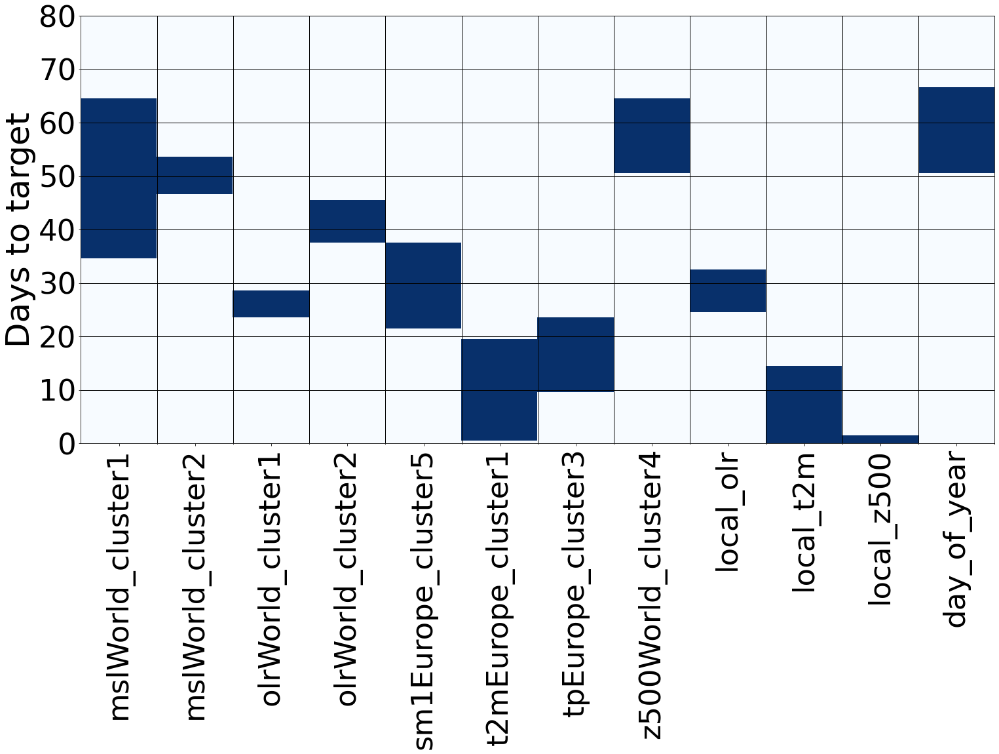

In [52]:
from matplotlib.ticker import MultipleLocator
# Just consider the columns of the board that have at least one day with a value greater than the threshold

board_filtered = board_filtered[:,np.any(board_filtered, axis=0)]


plt.figure(figsize=(25, 12))
plt.imshow(board_filtered, cmap='Blues', origin='lower',aspect='auto')
# Put xticks of columns with at least one day with a value greater than the threshold

column_names = pred_dataframe_opt.columns.tolist()
column_names = np.array(column_names)[np.any(board_filtered_or, axis=0)]

plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=45)

# Put just one of each 5 yticks
plt.gca().yaxis.set_major_locator(MultipleLocator(10))

plt.yticks(fontsize=45)
plt.ylim(0,80)
# Put the yticks labels











# plt.yticks(np.arange(board_filtered.shape[0])-0.5,np.arange(board_filtered.shape[0]),fontsize=16)
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=50)

# plt.savefig('board_filtered_95.eps', format='eps', bbox_inches = 'tight')

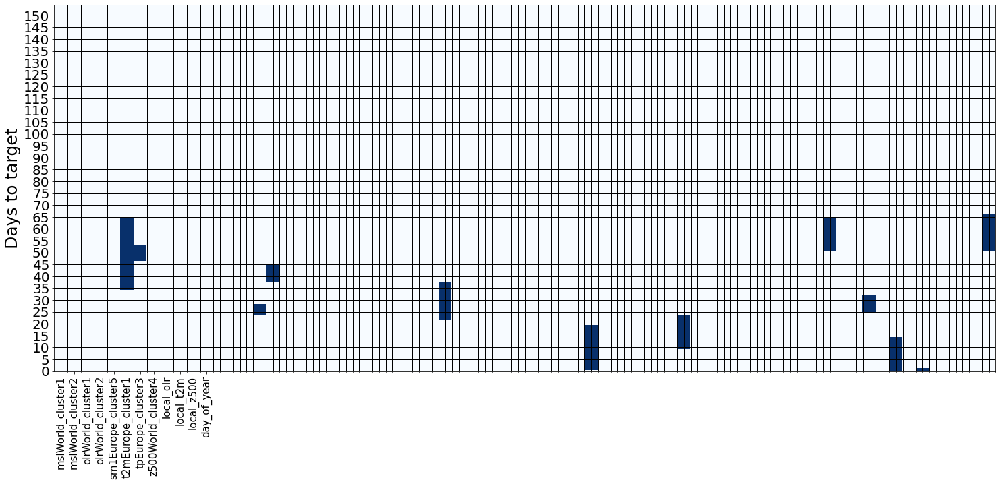

In [65]:
plt.figure(figsize=(25, 10))
plt.imshow(board_filtered, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=15)
# plt.yticks(np.arange(board_filtered.shape[0])-0.5,np.arange(board_filtered.shape[0]))
# minor_locator = AutoMinorLocator(2)
# plt.gca().xaxis.set_minor_locator(minor_locator)

# plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
# plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# # plt.grid(color='black', linewidth=1)
# plt.ylabel('Days to target',fontsize=15)
# # plt.ylim(-0.5, 100)


minor_locator = AutoMinorLocator(2)

plt.gca().yaxis.set_major_locator(MultipleLocator(5))

plt.yticks(fontsize=20)

# Put the yticks labels

# plt.gca().xaxis.grid( which='major',linewidth=1)
# plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
plt.gca().xaxis.set_minor_locator(minor_locator)
plt.gca().xaxis.grid(which='minor', color='black', linewidth=1)
plt.gca().yaxis.grid(which='major', color='black', linewidth=1)
plt.ylabel('Days to target', fontsize=25)

plt.ylim(0)
# plt.savefig('./Filtered_Heatmap_low_95.eps', format='eps', bbox_inches = 'tight')
plt.show()

# plt.savefig('../Results/Test12_low_NOVIP1/Board_095.eps', format='eps')

In [66]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])

# time_lags = board_filtered.argmax(axis=0)
# time_sequences = board_filtered.sum(axis=0)
# variable_selection = board_filtered.sum(axis=0)!=0
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        # dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pd.merge(dataset_opt,pred_dataframe[col].shift(time_lags[i]+j),on='index')
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

In [67]:
dataset_opt

,Target,mslEurope_cluster1_lag0,mslEurope_cluster1_lag1,mslEurope_cluster1_lag2,mslEurope_cluster1_lag3,mslEurope_cluster1_lag4,mslEurope_cluster1_lag5,mslEurope_cluster1_lag6,mslEurope_cluster1_lag7,mslEurope_cluster1_lag8,...,day_of_year_lag145,day_of_year_lag146,day_of_year_lag147,day_of_year_lag148,day_of_year_lag149,day_of_year_lag150,day_of_year_lag151,day_of_year_lag152,day_of_year_lag153,day_of_year_lag154
Date,,,,,,,,,,,,,,,,,,,,,
1940-05-01,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1940-05-02,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1940-05-03,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1940-05-04,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1940-05-05,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-27,0,516.553956,1056.649865,1409.603104,1578.277780,1238.354332,379.362025,296.585413,637.975670,810.808754,...,94.0,93.0,92.0,91.0,90.0,89.0,88.0,87.0,86.0,85.0
2022-08-28,0,521.605483,516.553956,1056.649865,1409.603104,1578.277780,1238.354332,379.362025,296.585413,637.975670,...,95.0,94.0,93.0,92.0,91.0,90.0,89.0,88.0,87.0,86.0
2022-08-29,1,1040.804483,521.605483,516.553956,1056.649865,1409.603104,1578.277780,1238.354332,379.362025,296.585413,...,96.0,95.0,94.0,93.0,92.0,91.0,90.0,89.0,88.0,87.0


In [68]:
train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

In [58]:
X_train

,mslEurope_cluster1_lag0,mslEurope_cluster1_lag1,mslEurope_cluster1_lag2,mslEurope_cluster1_lag3,mslEurope_cluster1_lag4,mslEurope_cluster1_lag5,mslEurope_cluster1_lag6,mslEurope_cluster1_lag7,mslEurope_cluster1_lag8,mslEurope_cluster1_lag9,...,day_of_year_lag145,day_of_year_lag146,day_of_year_lag147,day_of_year_lag148,day_of_year_lag149,day_of_year_lag150,day_of_year_lag151,day_of_year_lag152,day_of_year_lag153,day_of_year_lag154
Date,,,,,,,,,,,,,,,,,,,,,
1951-05-01,0.841897,1.738201,0.762495,-0.371527,-0.343927,-0.458572,-0.921786,-0.547464,0.053944,-0.193113,...,1.850504,1.802128,1.755969,1.711838,1.669566,1.629001,1.590011,1.552474,1.516284,1.481341
1951-05-02,0.697900,0.842587,1.737032,0.761686,-0.373792,-0.346703,-0.462246,-0.924030,-0.548533,0.053105,...,1.858541,1.810057,1.763797,1.719572,1.677211,1.636564,1.597495,1.559886,1.523627,1.488620
1951-05-03,-0.007082,0.698726,0.842259,1.735841,0.759198,-0.376562,-0.350303,-0.464715,-0.924499,-0.548617,...,1.866577,1.817986,1.771626,1.727306,1.684856,1.644126,1.604980,1.567297,1.530969,1.495898
1951-05-04,0.073179,-0.005593,0.698532,0.841418,1.733161,0.756164,-0.380182,-0.352827,-0.465915,-0.924112,...,1.874614,1.825914,1.779454,1.735040,1.692502,1.651688,1.612465,1.574709,1.538312,1.503176
1951-05-05,0.660184,0.074593,-0.005126,0.697748,0.838914,1.729900,0.753287,-0.382691,-0.354205,-0.466103,...,1.882651,1.833843,1.787282,1.742773,1.700147,1.659251,1.619949,1.582121,1.545655,1.510454
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2010-08-27,-0.536418,-1.159040,-1.612981,-1.719186,-1.570327,-1.134972,-0.109122,0.228856,-0.414081,-0.585593,...,-0.134584,-0.156323,-0.177581,-0.198406,-0.218841,-0.238924,-0.258691,-0.278173,-0.297400,-0.316399
2010-08-28,-0.264372,-0.534431,-1.157492,-1.612859,-1.721186,-1.572817,-1.139090,-0.111765,0.226552,-0.414334,...,-0.126547,-0.148394,-0.169753,-0.190672,-0.211196,-0.231362,-0.251206,-0.270762,-0.290058,-0.309121
2010-08-29,0.061410,-0.262641,-0.533469,-1.157548,-1.614880,-1.723640,-1.577222,-1.141227,-0.113527,0.225496,...,-0.118510,-0.140465,-0.161925,-0.182939,-0.203550,-0.223799,-0.243722,-0.263350,-0.282715,-0.301842


In [60]:
board_filtered.shape

(155, 12)

In [70]:
X_train.columns.shape

(154,)

In [69]:
X_train = X_train[X_train.columns[board_filtered.T.reshape(1,-1)[0].astype(bool)]]
X_test = X_test[X_test.columns[board_filtered.T.reshape(1,-1)[0].astype(bool)]]

In [395]:
X_train.to_csv('../Results/'+experiment+'/X_train_75.csv')
X_test.to_csv('../Results/'+experiment+'/X_test_75.csv')

In [299]:
X_train['day']=train_dataset_opt['day_of_year_lag0']
X_test['day']=test_dataset_opt['day_of_year_lag0']

In [224]:
X_train = np.array(X_train)
X_test = np.array(X_test)

In [159]:
X_train.shape

(7380, 441)

In [203]:
#Apply pca

from sklearn.decomposition import PCA
pca = PCA(n_components=0.99)
pca.fit(X_train)
X_train_pca = pca.transform(X_train)

X_test_pca = pca.transform(X_test)

X_train_pca.shape

(7380, 216)

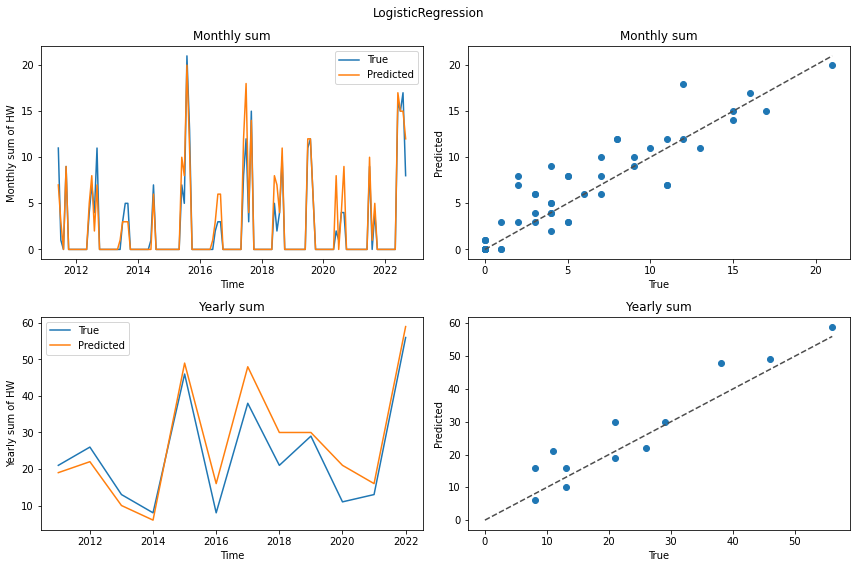

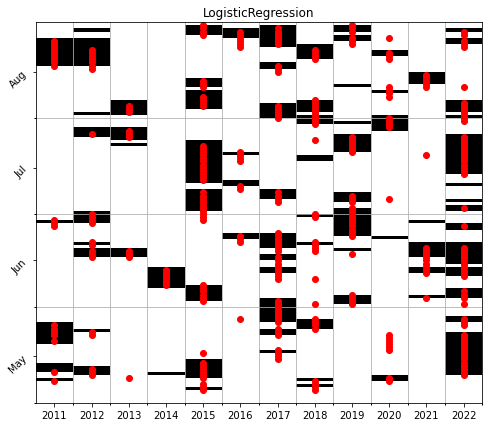

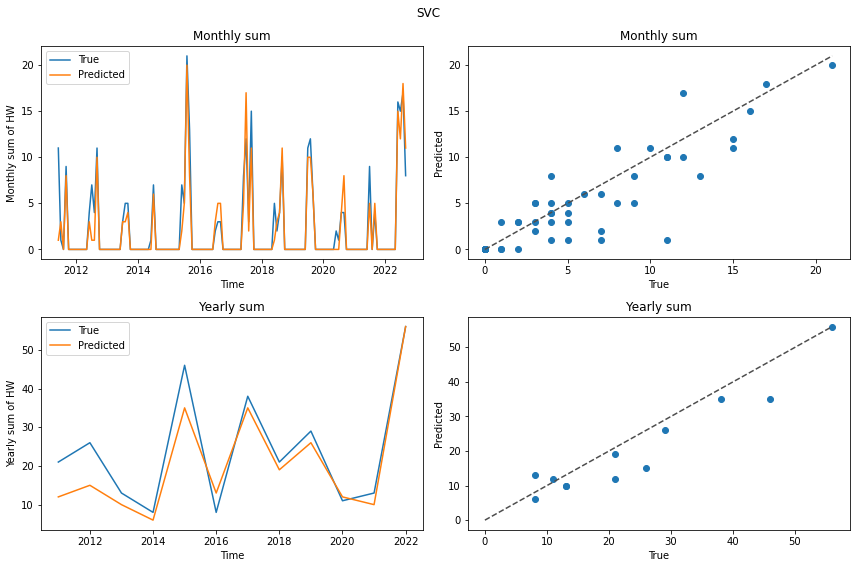

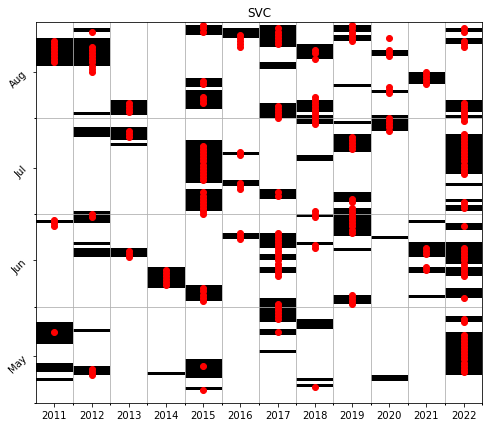

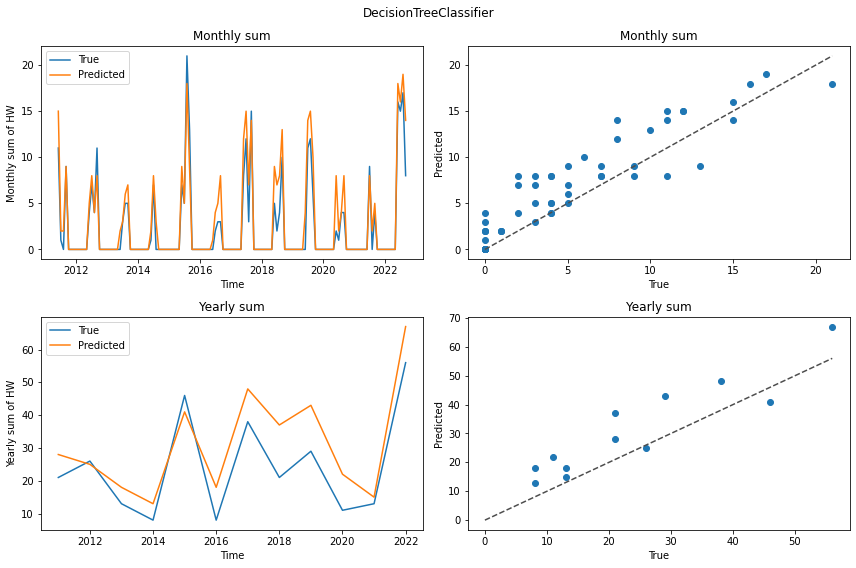

...

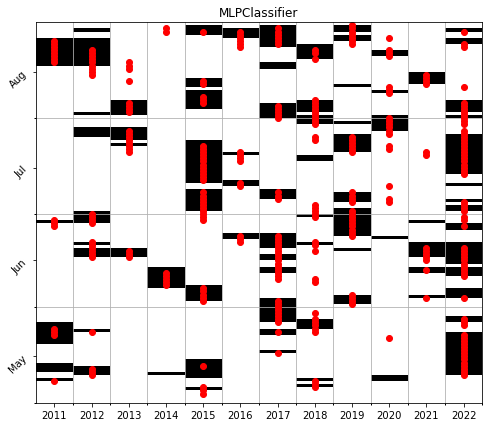

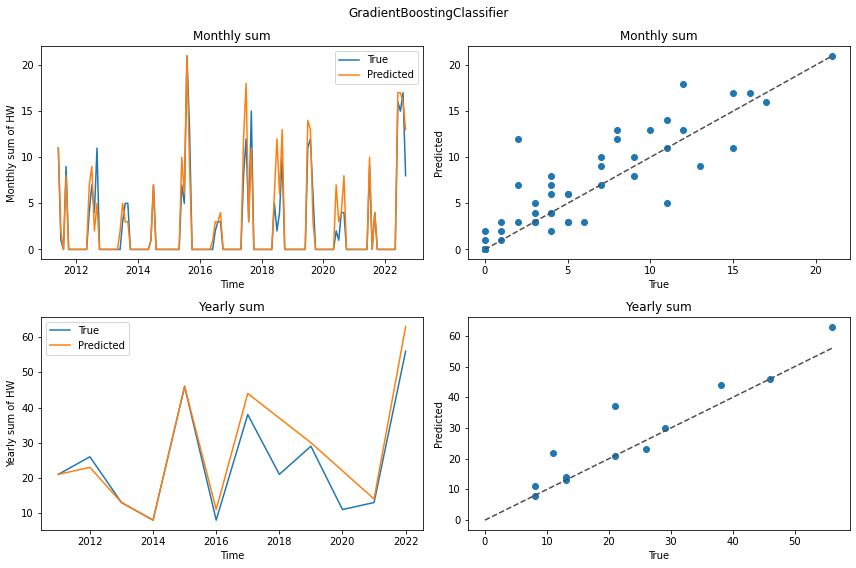

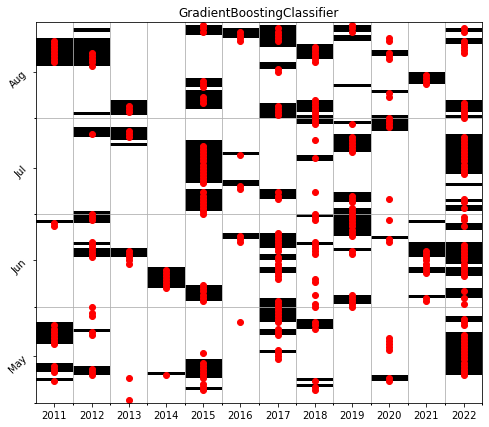

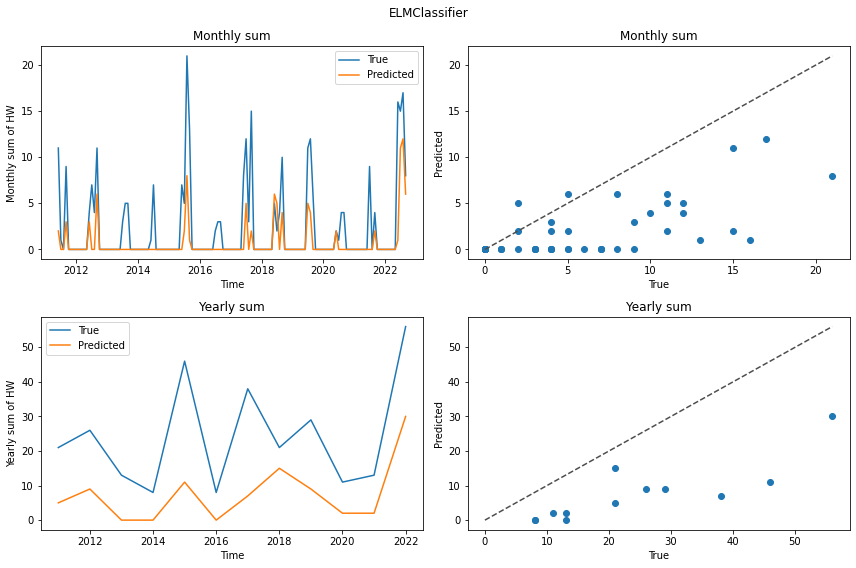

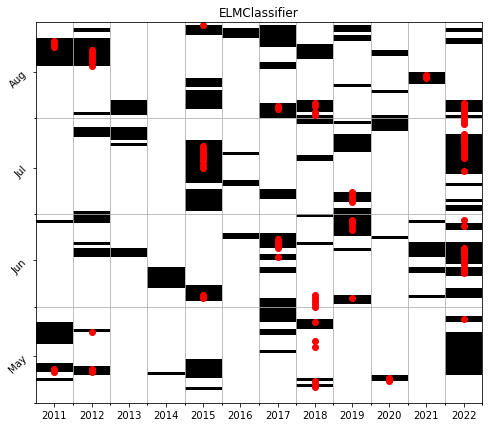

In [71]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#LGBM
from lightgbm import LGBMClassifier
clf_LGBM = LGBMClassifier()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_LGBM,clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
# ML_models = [clf_LR]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    # clf.fit(X_train_pca, Y_train)
    # predictions = clf.predict(X_test_pca)
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [72]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.865517,0.769939,0.814935,1.124138,1.389831,4.833333,0.835209,0.848149
1,SVC,0.724138,0.843373,0.779221,0.858621,1.474576,4.416667,0.787347,0.853011
2,DecisionTreeClassifier,0.837931,0.648000,0.730827,1.293103,1.847458,8.083333,0.771595,0.617379
3,RandomForestClassifier,0.796552,0.855556,0.825000,0.931034,1.084746,3.333333,0.889735,0.929685
4,GaussianNB,0.982759,0.369650,0.537229,2.658621,8.152542,40.083333,-3.353025,-8.160828
5,KNeighborsClassifier,0.141379,0.854167,0.242604,0.165517,4.101695,20.166667,-0.330444,-1.393716
6,AdaBoostClassifier,0.865517,0.812298,0.838063,1.065517,1.169492,3.583333,0.890341,0.918838
7,MLPClassifier,0.800000,0.743590,0.770764,1.075862,1.627119,5.000000,0.778259,0.828700
8,GradientBoostingClassifier,0.872414,0.762048,0.813505,1.144828,1.559322,4.000000,0.770989,0.819723
9,ELMClassifier,0.255172,0.822222,0.389474,0.310345,3.525424,16.666667,0.037912,-0.623987


In [34]:
# Test different varaince levels
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
f1s = []
vars = []
for var in np.arange(0.2,1,0.05):
    var = np.round(var,2)
    pca = PCA(n_components=var)
    pca.fit(X_train)
    X_train_pca = pca.transform(X_train)

    X_test_pca = pca.transform(X_test)

    clf_LR = LogisticRegression()

    clf_LR.fit(X_train_pca, Y_train)
    Y_pred = clf_LR.predict(X_test_pca)

    f1s.append(f1_score(Y_test, Y_pred))
    vars.append(var)
    print(var,X_train_pca.shape[1])

0.2 2
0.25 3
0.3 4
0.35 5
0.4 7
0.45 9
0.5 12
0.55 16
0.6 19
0.65 25
0.7 31
0.75 39
0.8 51
0.85 67
0.9 90
0.95 131


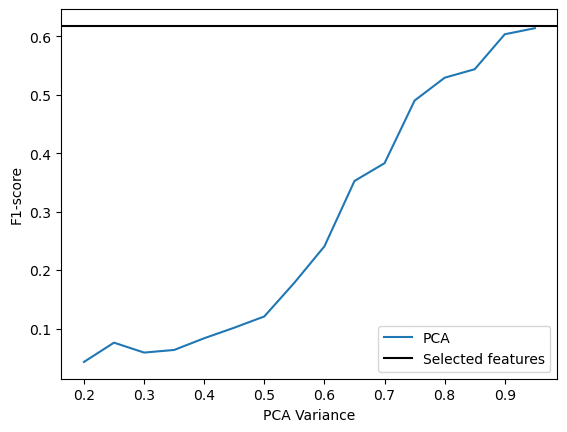

In [364]:
plt.plot(vars,f1s,label='PCA')
plt.axline((0.6181,0.6181),slope=0,color='black',label='Selected features')
plt.xlabel('PCA Variance')
plt.ylabel('F1-score')
plt.legend()

#### Voting ensemble (test)

In [128]:
# Voting Ensemble
preds = []
from sklearn import model_selection
for threshold in np.arange(0.2,1,0.05):
    board_filtered = board_100/len(arrays)
    board_filtered = np.where(board_filtered>threshold,1,0)


    time_lags = np.repeat(0,pred_dataframe.shape[1])
    time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
    variable_selection = np.repeat(1,pred_dataframe.shape[1])
    # print(solution)
    # if sum(variable_selection) == 0:
    #     return 100000


    # Create dataset according to solution
    dataset_opt = target_dataset.copy()
    for i,col in enumerate(pred_dataframe.columns):
        if variable_selection[i] == 0:
            continue
        for j in range(time_sequences[i]):
            dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

    train_dataset_opt = dataset_opt[train_indices]
    test_dataset_opt = dataset_opt[test_indices]

    Y_column = 'Target' 
                
    X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
    Y_train=train_dataset_opt[Y_column]

    X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
    Y_test=test_dataset_opt[Y_column]
        
    from sklearn import preprocessing
    scaler = preprocessing.StandardScaler()
    X_std_train = scaler.fit(X_train)

    X_std_train = scaler.transform(X_train)
    X_std_val = scaler.transform(X_test)

    X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
    X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

    X_train = np.array(X_train)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]
    X_test = np.array(X_test)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]


    from sklearn.linear_model import LogisticRegression
    clf_LR = LogisticRegression()
    clf_LR.fit(X_train, Y_train)
    predictions = clf_LR.predict(X_test)
# Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)
    f1 = f1_score(Y_test, predictions)
    print(f1)

    preds.append(predictions)

0.2571428571428571
0.23121387283236997


KeyboardInterrupt: 

In [82]:
majority = np.where(np.array(preds).sum(axis=0)>np.array(preds).shape[0]/2,1,0)
f1_score(Y_test, majority)

0.5301204819277108

In [29]:
# Voting Ensemble
preds = []
for elitism in np.arange(0.1,0.6,0.1):
    print(elitism)
    best100_index = sol_file_av.sort_values(by=['CV'],ascending=False).head(int(elitism*sol_file_av.shape[0])).index

    arrays = []
    for ind in best100_index:
        array = np.fromstring(sol_file_av.Sol[ind].replace('[', '').replace(']', '').replace('\n', ''), dtype=float, sep=' ')
        arrays.append(array)

    n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
    n_cols = len(column_names)

    board_100 = np.zeros((n_rows, n_cols))
    discarded = np.zeros((1, n_cols))

    for array in arrays:
        final_sequence = array[len(column_names):2*len(column_names)]
        sequence_length = array[:len(column_names)]
        feat_sel = array[2*len(column_names):]
        column_names = pred_dataframe_opt.columns.tolist()

        for i in range(n_cols):
            start_index = int(final_sequence[i])
            end_index = int(final_sequence[i]) + int(sequence_length[i])
            

            if feat_sel[i]==0:
                discarded[0,i] += 1
            else:
                board_100[start_index:end_index, i] += 1
        
    board_100[0,:].shape



    for threshold in np.arange(0.2,1,0.05):
        # print(threshold)
        board_filtered = board_100/len(arrays)
        board_filtered = np.where(board_filtered>threshold,1,0)


        time_lags = np.repeat(0,pred_dataframe.shape[1])
        time_sequences = np.repeat(board_filtered.shape[0],pred_dataframe.shape[1])
        variable_selection = np.repeat(1,pred_dataframe.shape[1])
        # print(solution)
        # if sum(variable_selection) == 0:
        #     return 100000


        # Create dataset according to solution
        dataset_opt = target_dataset.copy()
        for i,col in enumerate(pred_dataframe.columns):
            if variable_selection[i] == 0:
                continue
            for j in range(time_sequences[i]):
                dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

        train_dataset_opt = dataset_opt[train_indices]
        test_dataset_opt = dataset_opt[test_indices]

        Y_column = 'Target' 
                    
        X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
        Y_train=train_dataset_opt[Y_column]

        X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
        Y_test=test_dataset_opt[Y_column]
            
        from sklearn import preprocessing
        scaler = preprocessing.StandardScaler()
        X_std_train = scaler.fit(X_train)

        X_std_train = scaler.transform(X_train)
        X_std_val = scaler.transform(X_test)

        X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
        X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

        X_train = np.array(X_train)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]
        X_test = np.array(X_test)[:,board_filtered.T.reshape(1,-1)[0].astype(bool)]


        from sklearn.linear_model import LogisticRegression
        clf_LR = LogisticRegression()
        clf_LR.fit(X_train, Y_train)
        predictions = clf_LR.predict(X_test)
    # Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)
        f1 = f1_score(Y_test, predictions)
        print(f1)

        preds.append(predictions)

0.1


NameError: name 'f1_score' is not defined

In [84]:
majority = np.where(np.array(preds).sum(axis=0)>np.array(preds).shape[0]/2,1,0)
f1_score(Y_test, majority)

0.503875968992248

In [30]:
n_rows = int(((sequence_length + final_sequence)*feat_sel).max())+5
n_cols = len(column_names)

board_100 = np.zeros((n_rows, n_cols))
discarded = np.zeros((1, n_cols))

for array in arrays:
    final_sequence = array[len(column_names):2*len(column_names)]
    sequence_length = array[:len(column_names)]
    feat_sel = array[2*len(column_names):]
    column_names = pred_dataframe_opt.columns.tolist()

    for i in range(n_cols):
        start_index = int(final_sequence[i])
        end_index = int(final_sequence[i]) + int(sequence_length[i])
        

        if feat_sel[i]==0:
            discarded[0,i] += 1
        else:
            board_100[start_index:end_index, i] += 1
    
board_100[0,:].shape

(35,)

#### Benchmarks

In [77]:
board_benchmark = np.where(board_100>0.5,0,0)

In [78]:
board_benchmark[:7,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Text(0, 0.5, 'Days to target')

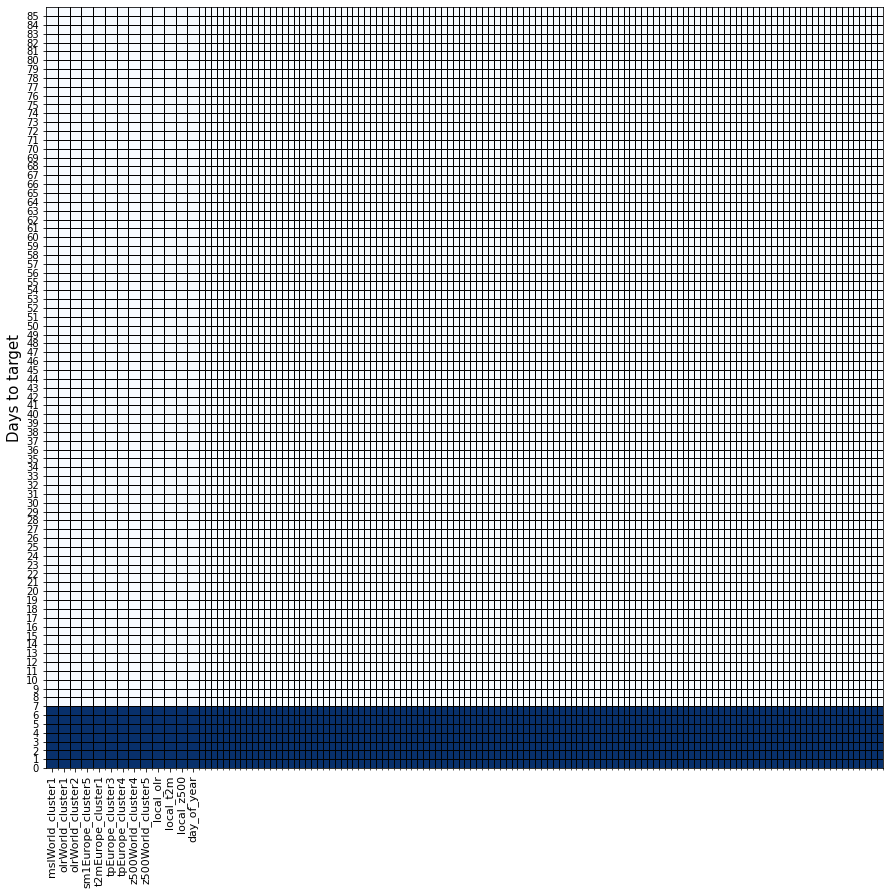

In [79]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [80]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

In [85]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()

from lightgbm import LGBMClassifier

clf_LR = LGBMClassifier()

clf_LR.fit(X_train, Y_train)
predictions = clf_LR.predict(X_train)

f1_score(Y_train, predictions)

[LightGBM] [Info] Number of positive: 571, number of negative: 6809
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015346 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125825
[LightGBM] [Info] Number of data points in the train set: 7380, number of used features: 497
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.077371 -> initscore=-2.478611
[LightGBM] [Info] Start training from score -2.478611


1.0

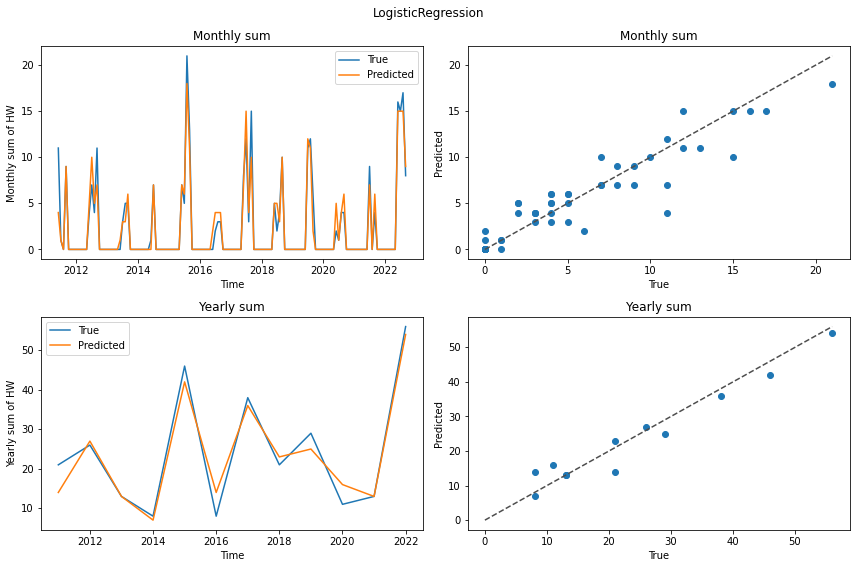

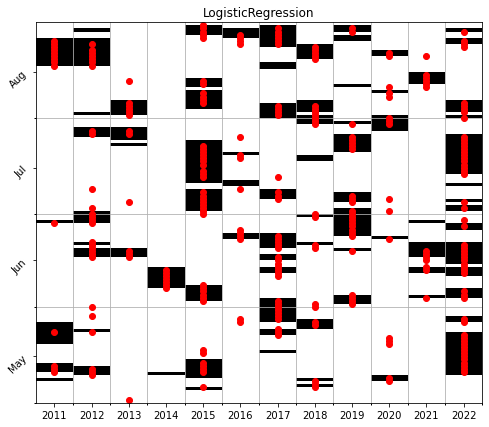

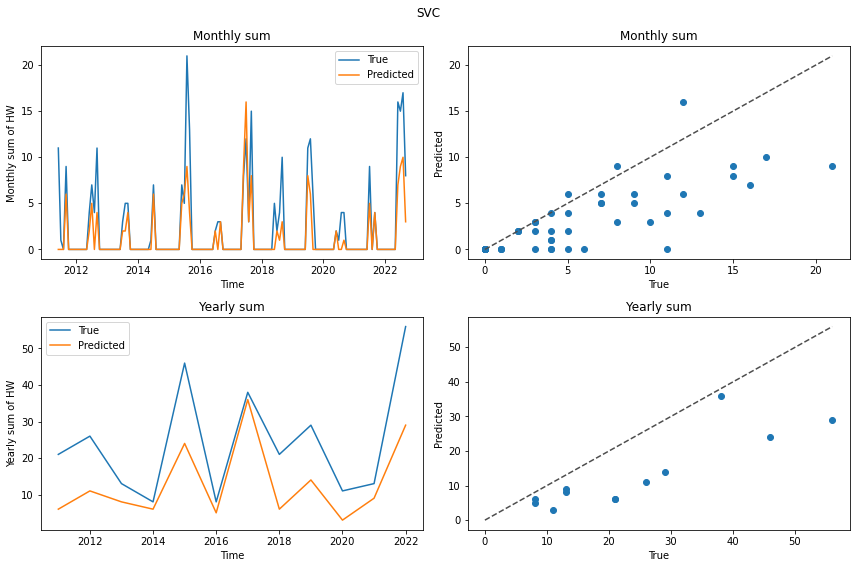

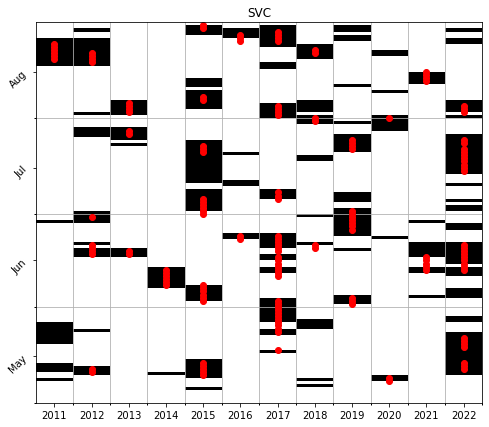

[LightGBM] [Info] Number of positive: 571, number of negative: 6809
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 125825
[LightGBM] [Info] Number of data points in the train set: 7380, number of used features: 497
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.077371 -> initscore=-2.478611
[LightGBM] [Info] Start training from score -2.478611


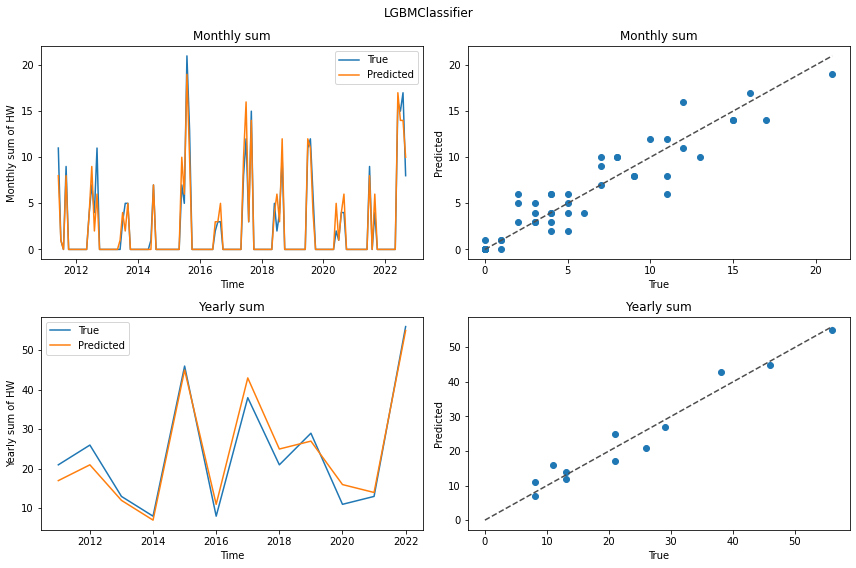

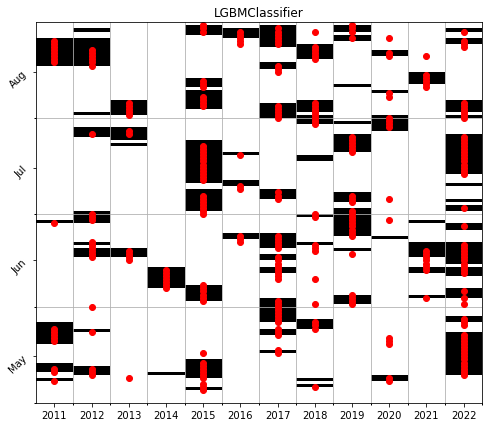

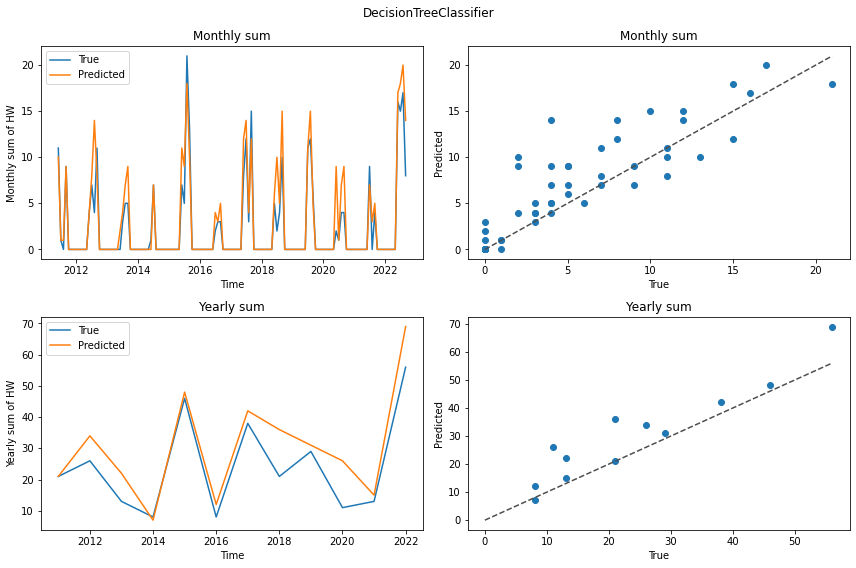

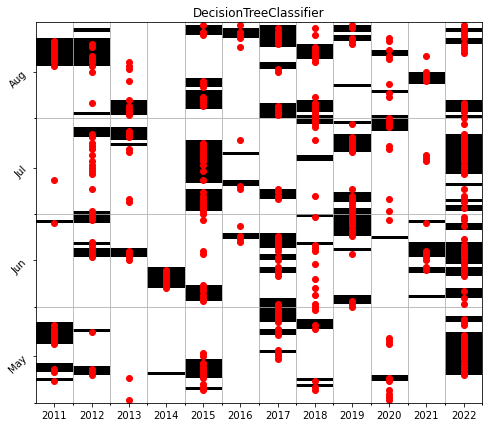

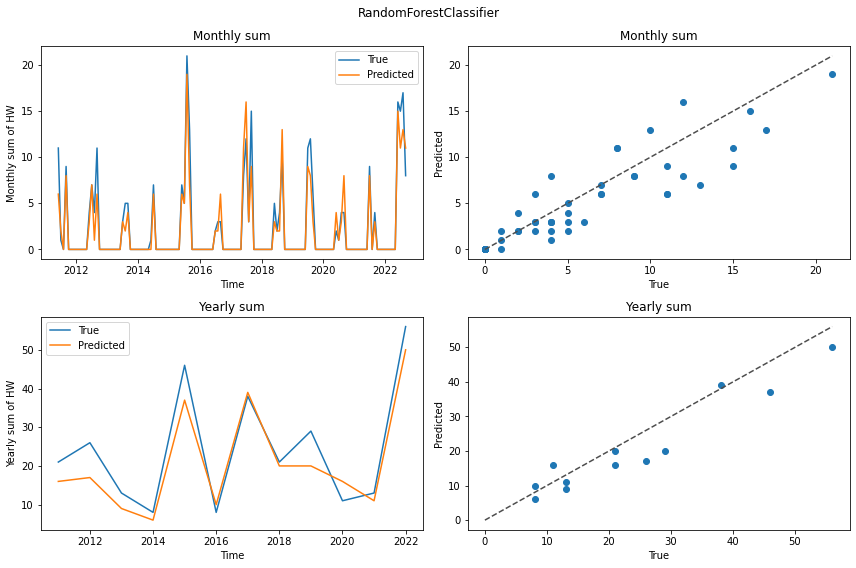

...

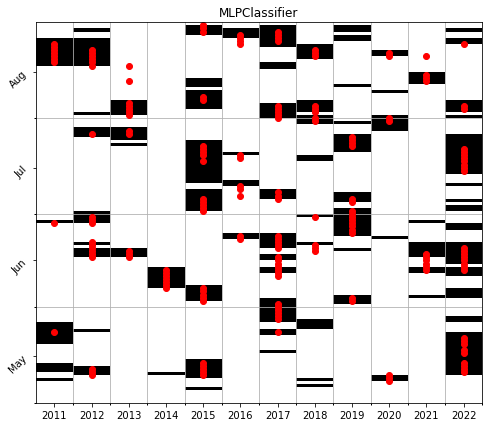

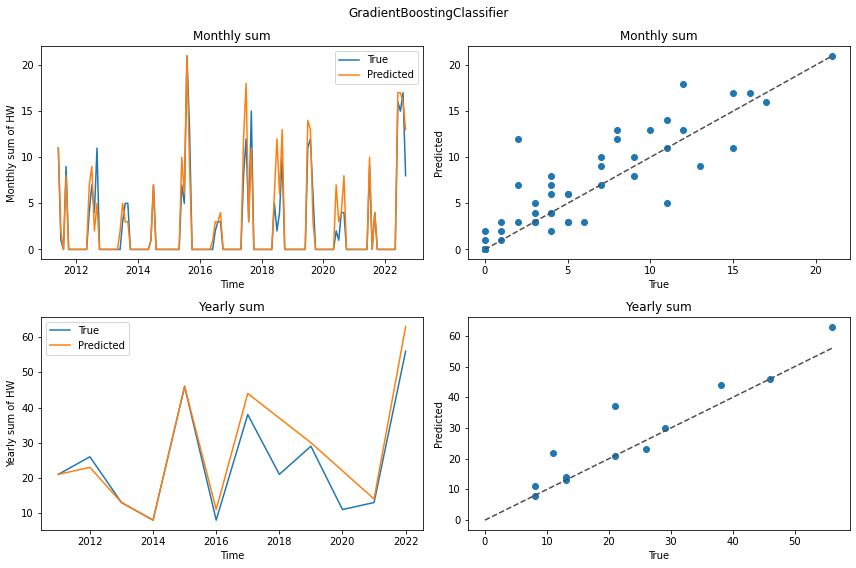

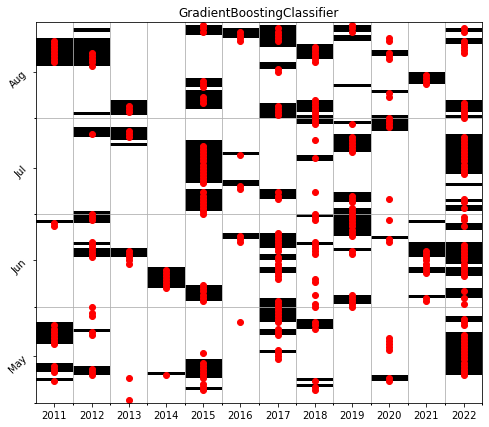

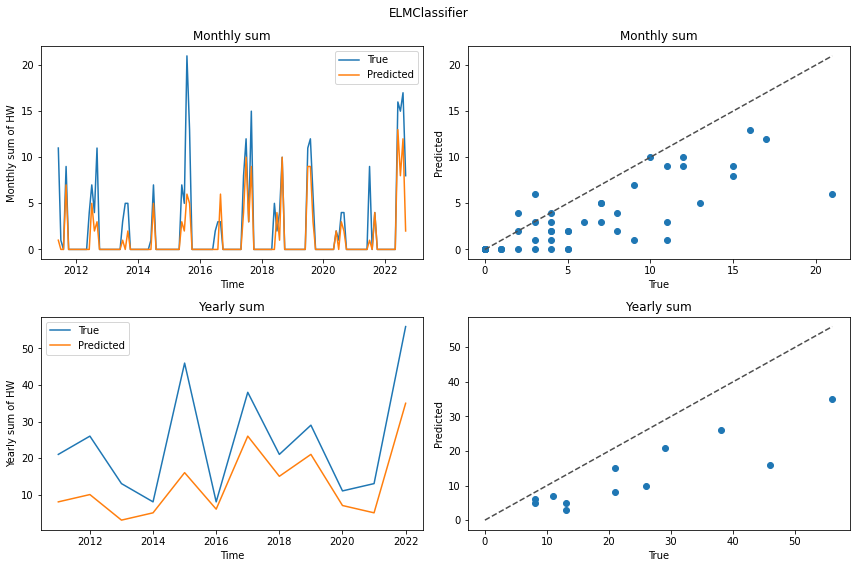

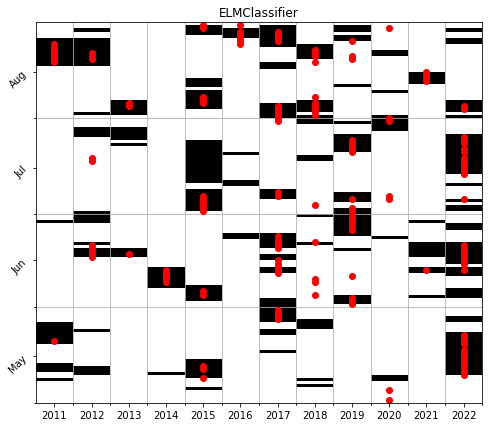

In [86]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#LGBM
from lightgbm import LGBMClassifier
clf_LGBM = LGBMClassifier()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC,clf_LGBM, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [87]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.806897,0.823944,0.815331,0.979310,1.118644,2.833333,0.880042,0.941653
1,SVC,0.482759,0.891720,0.626398,0.541379,2.457627,11.083333,0.443225,0.164069
2,LGBMClassifier,0.848276,0.839590,0.843911,1.010345,1.101695,2.750000,0.900035,0.953248
3,DecisionTreeClassifier,0.841379,0.672176,0.747320,1.251724,1.813559,6.250000,0.709798,0.697419
4,RandomForestClassifier,0.748276,0.864542,0.802218,0.865517,1.440678,4.583333,0.820063,0.865727
5,GaussianNB,0.996552,0.277085,0.433608,3.596552,12.762712,62.750000,-7.114136,-17.671363
6,KNeighborsClassifier,0.251724,0.646018,0.362283,0.389655,3.372881,14.750000,0.085774,-0.310934
7,AdaBoostClassifier,0.834483,0.809365,0.821732,1.031034,1.101695,3.583333,0.890341,0.903129
8,MLPClassifier,0.575862,0.893048,0.700210,0.644828,2.152542,9.083333,0.555913,0.344346
9,GradientBoostingClassifier,0.872414,0.762048,0.813505,1.144828,1.559322,4.000000,0.770989,0.819723


One of each seven days

In [309]:
board_benchmark = np.where(board_100>0.5,0,0)

board_benchmark[::7,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Text(0, 0.5, 'Days to target')

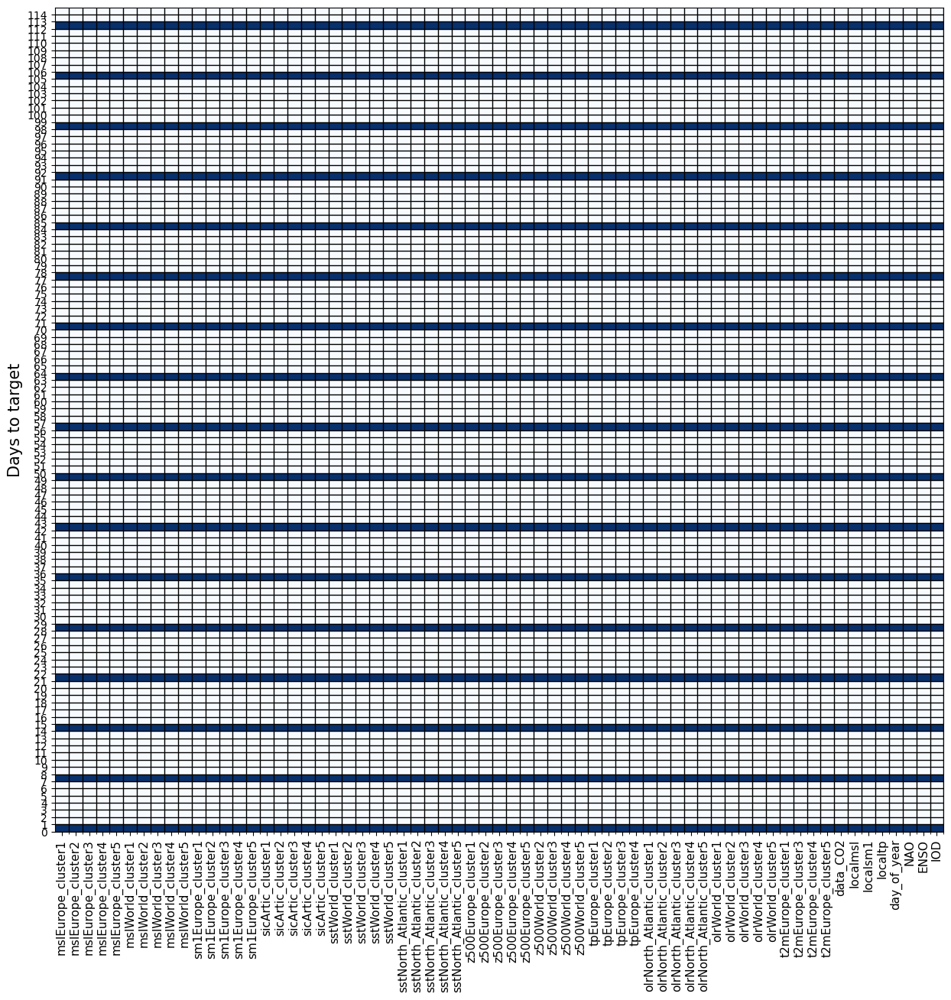

In [310]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [311]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

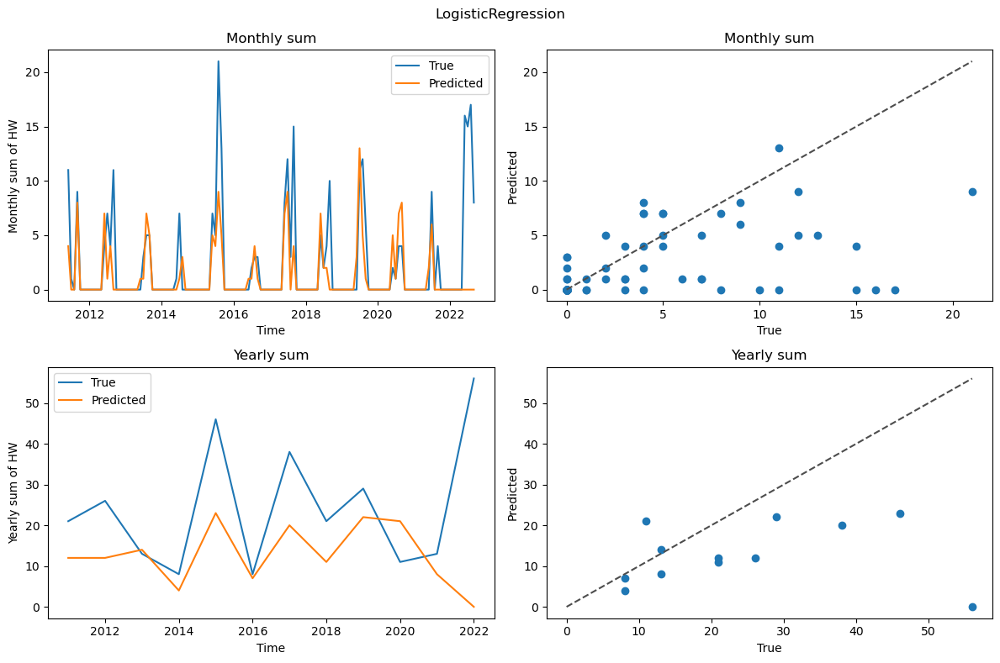

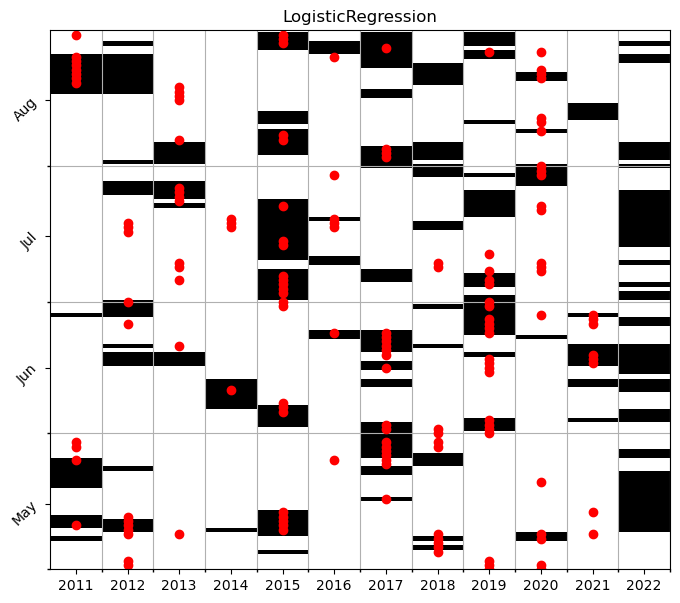

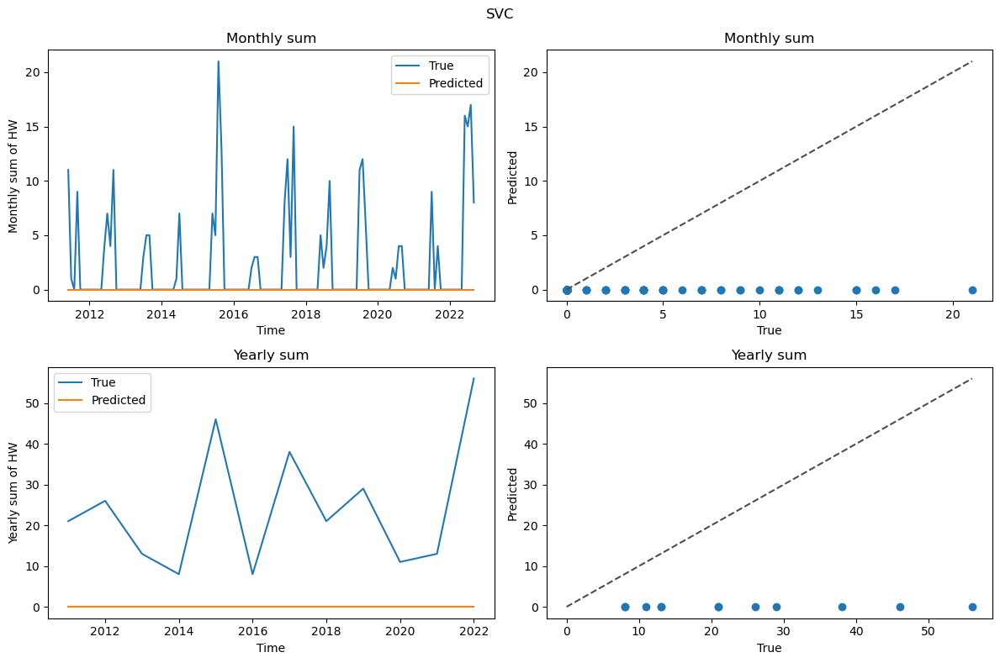

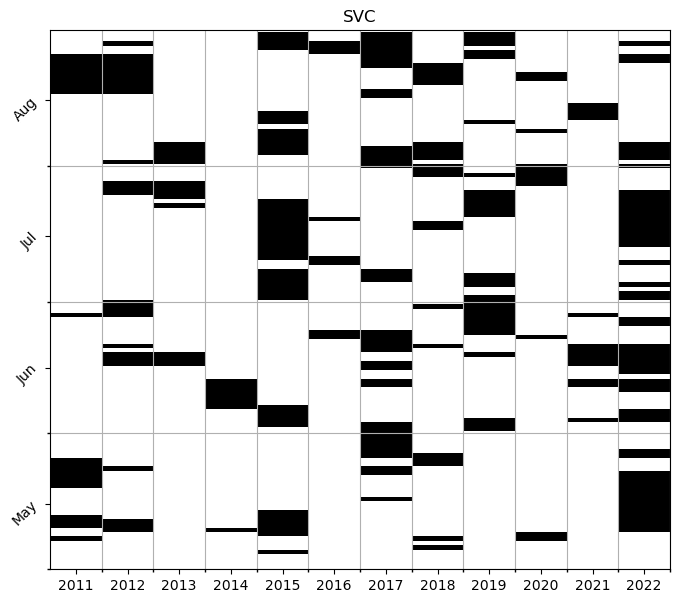

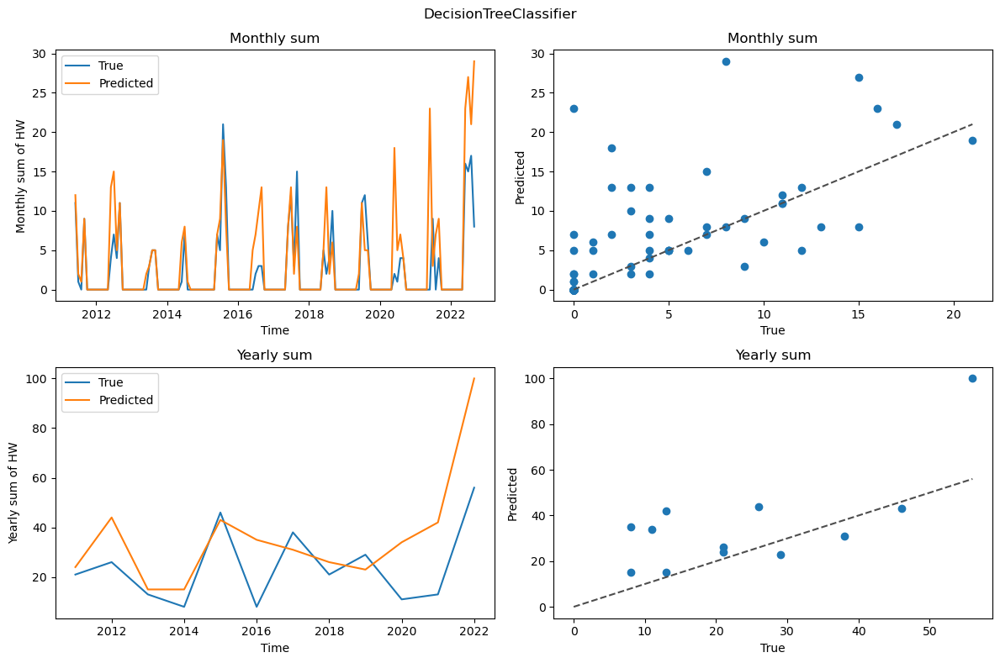

...

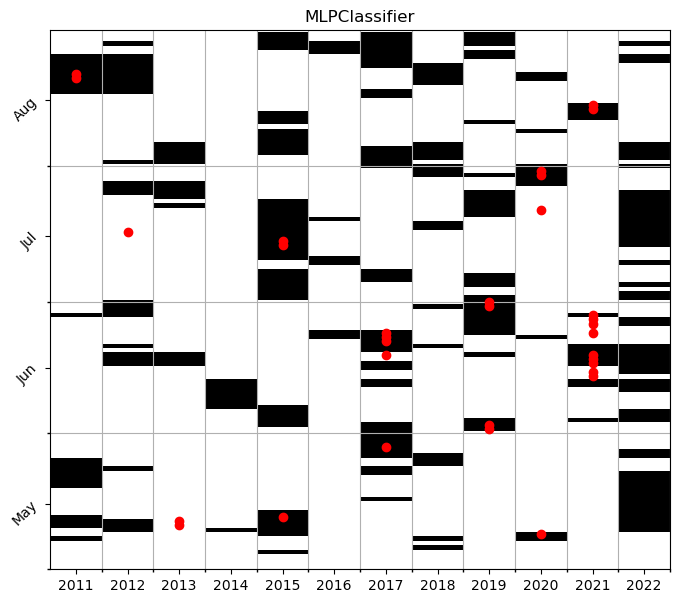

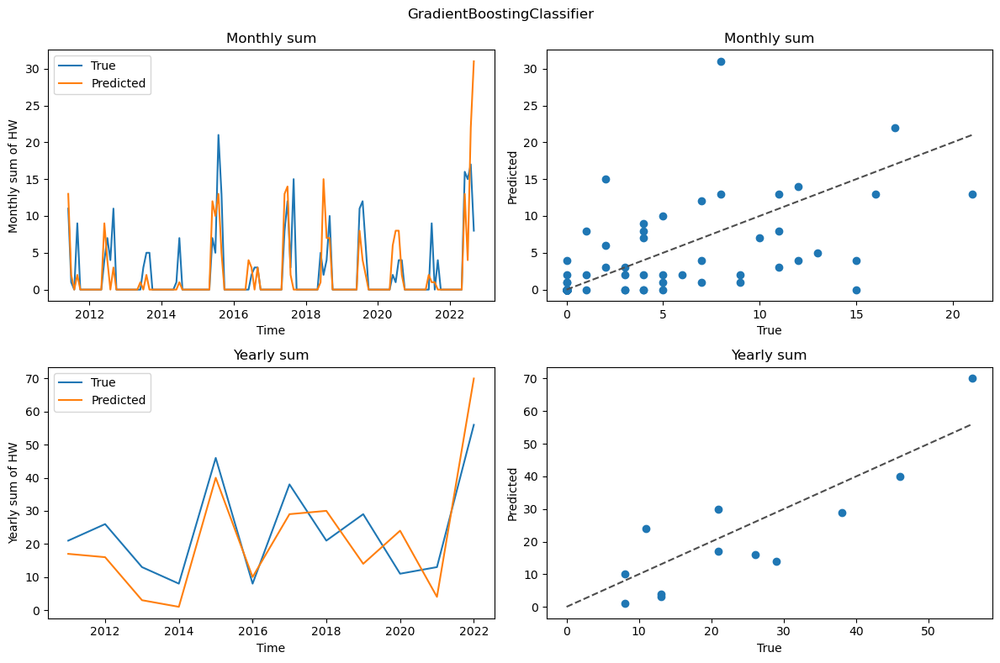

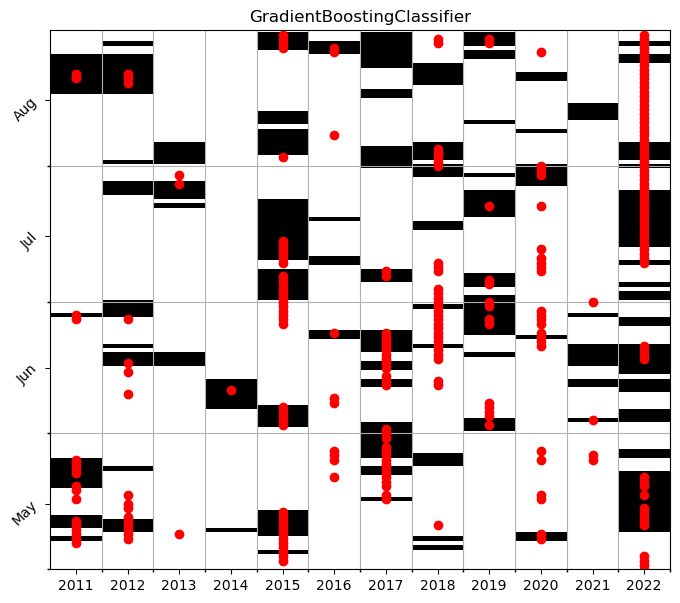

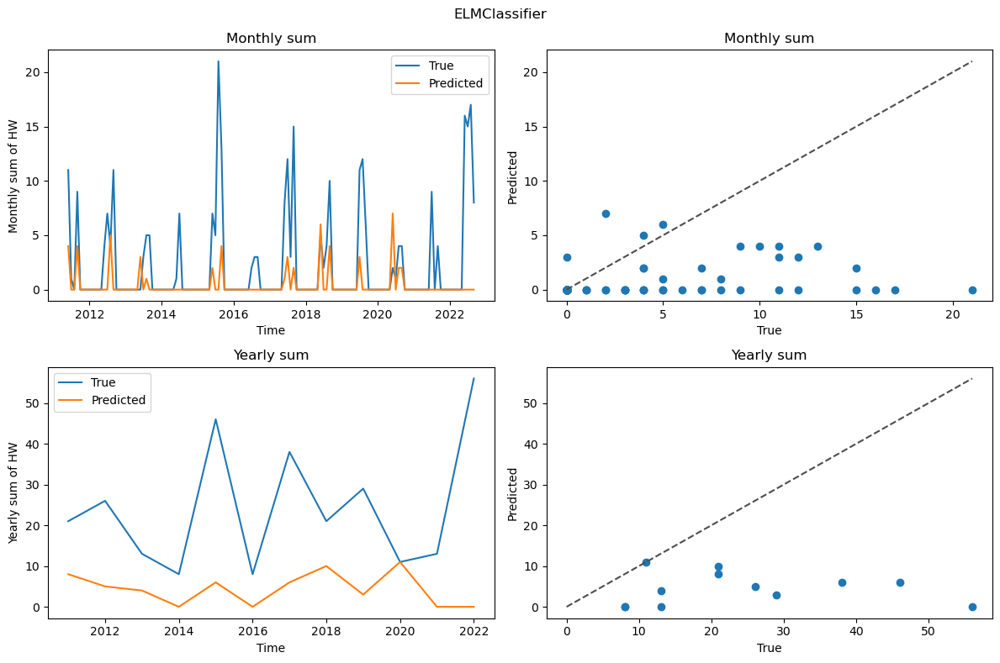

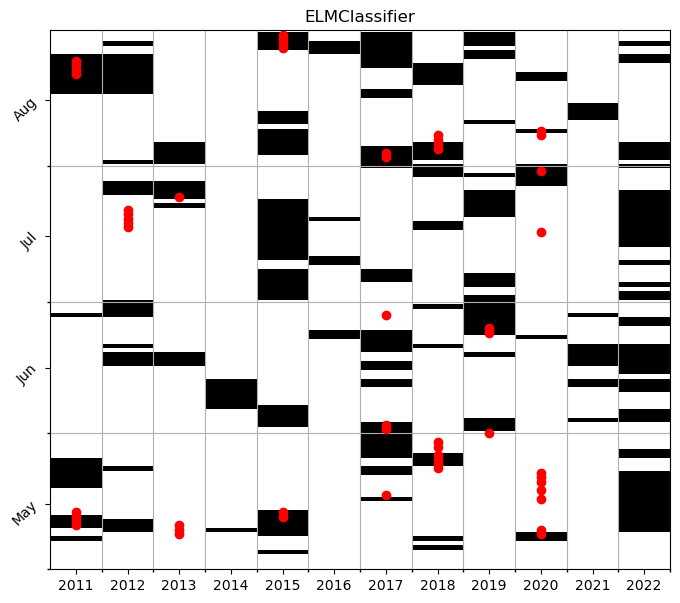

In [312]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [313]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.282759,0.532468,0.369369,0.531034,3.322034,13.166667,-0.044484,-0.704775
1,SVC,0.000000,0.000000,0.000000,0.000000,4.915254,24.166667,-0.863592,-2.621244
2,DecisionTreeClassifier,0.486207,0.326389,0.390582,1.489655,3.593220,14.500000,-0.357102,-0.698043
3,RandomForestClassifier,0.162069,0.431193,0.235589,0.375862,4.694915,21.750000,-0.750298,-1.875826
4,GaussianNB,0.803448,0.180062,0.294192,4.462069,18.915254,93.000000,-15.675388,-38.979554
5,KNeighborsClassifier,0.010345,0.272727,0.019934,0.037931,4.830508,23.250000,-0.835117,-2.520633
6,AdaBoostClassifier,0.434483,0.608696,0.507042,0.713793,2.932203,11.750000,0.141512,-0.592944
7,MLPClassifier,0.075862,0.687500,0.136646,0.110345,4.440678,21.500000,-0.612770,-2.152225
8,GradientBoostingClassifier,0.441379,0.496124,0.467153,0.889655,3.694915,9.000000,-0.123244,0.574367
9,ELMClassifier,0.096552,0.528302,0.163265,0.182759,4.355932,19.750000,-0.538251,-1.821967


First 15 days

In [314]:
board_benchmark = np.where(board_100>0.5,0,0)

board_benchmark[:15,:]=1
board_benchmark

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Text(0, 0.5, 'Days to target')

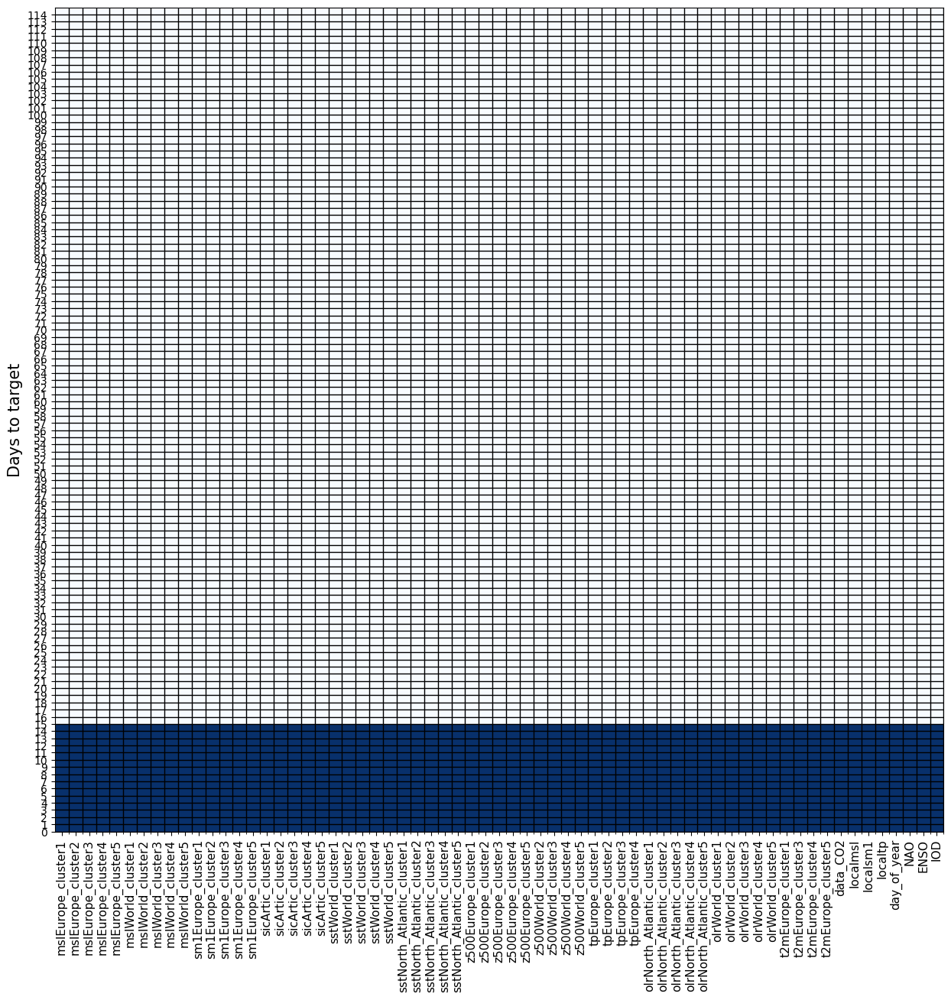

In [315]:
plt.figure(figsize=(15, 14))
plt.imshow(board_benchmark, cmap='Blues', origin='lower',aspect='auto')
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_benchmark.shape[0])-0.5,np.arange(board_benchmark.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.ylabel('Days to target',fontsize=15)

In [316]:
time_lags = np.repeat(0,pred_dataframe.shape[1])
time_sequences = np.repeat(board_benchmark.shape[0],pred_dataframe.shape[1])
variable_selection = np.repeat(1,pred_dataframe.shape[1])
# print(solution)
# if sum(variable_selection) == 0:
#     return 100000


# Create dataset according to solution
dataset_opt = target_dataset.copy()
for i,col in enumerate(pred_dataframe.columns):
    if variable_selection[i] == 0:
        continue
    for j in range(time_sequences[i]):
        dataset_opt[str(col)+'_lag'+str(time_lags[i]+j)] = pred_dataframe[col].shift(time_lags[i]+j)

train_dataset_opt = dataset_opt[train_indices]
test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
X_train=train_dataset_opt[train_dataset_opt.columns.drop([Y_column]) ]
Y_train=train_dataset_opt[Y_column]

X_test=test_dataset_opt[test_dataset_opt.columns.drop([Y_column]) ]
Y_test=test_dataset_opt[Y_column]
    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

X_train = np.array(X_train)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]
X_test = np.array(X_test)[:,board_benchmark.T.reshape(1,-1)[0].astype(bool)]

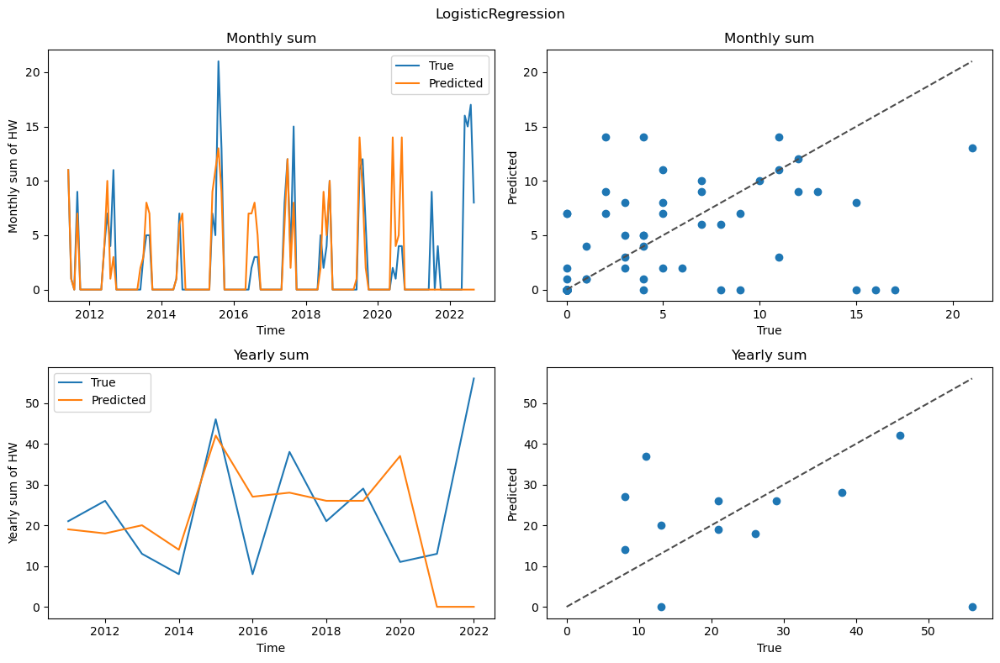

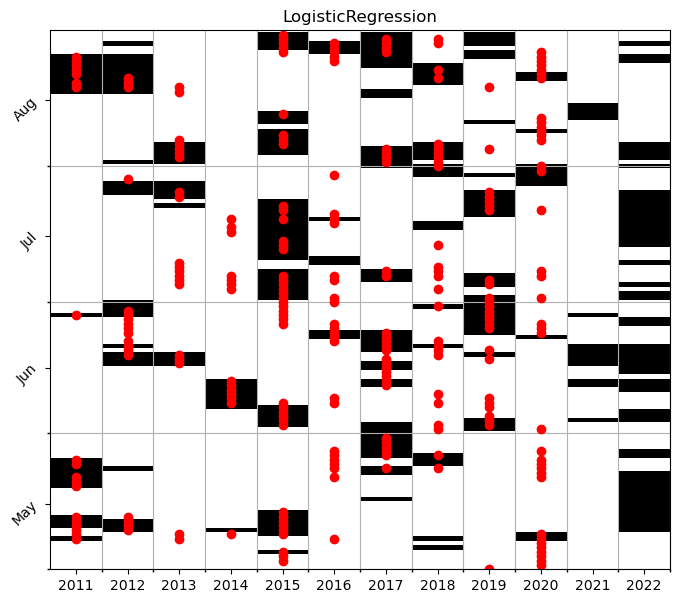

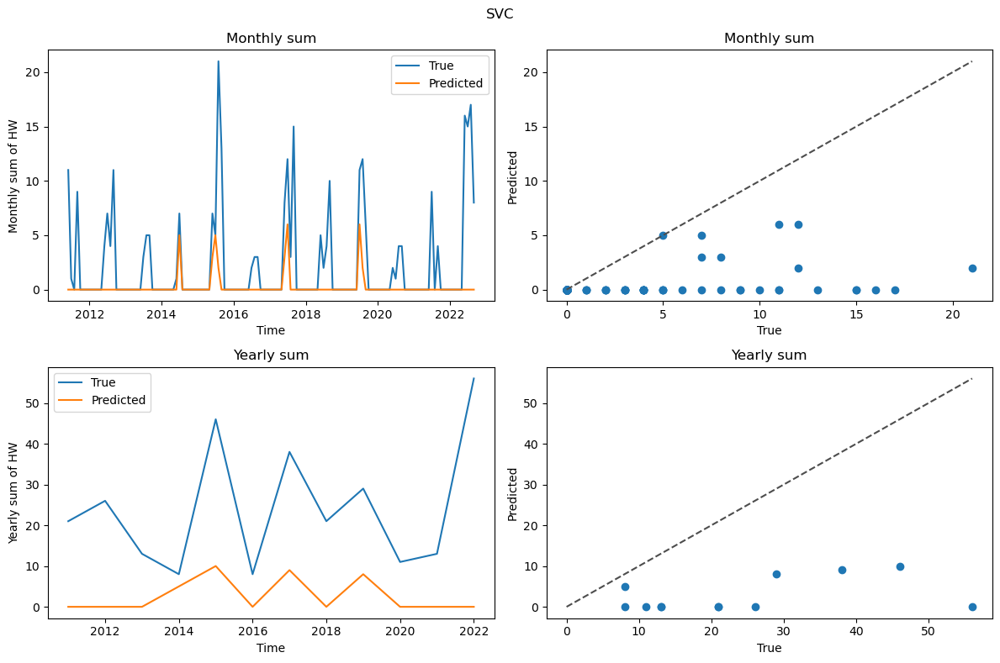

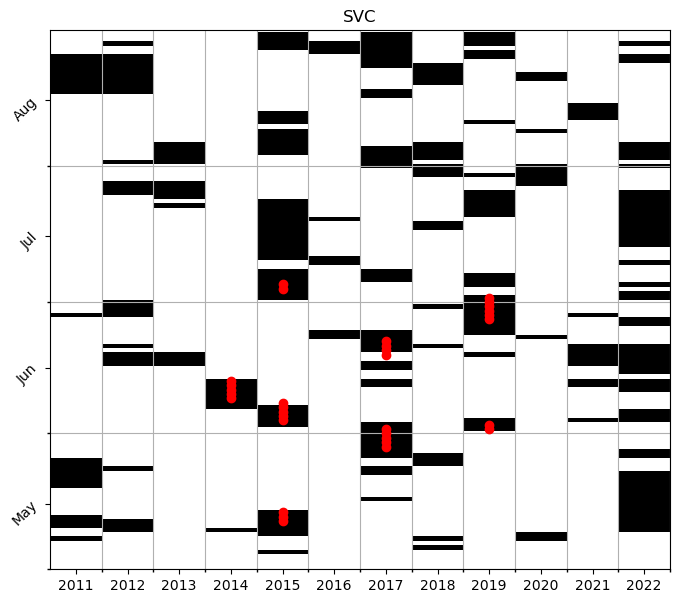

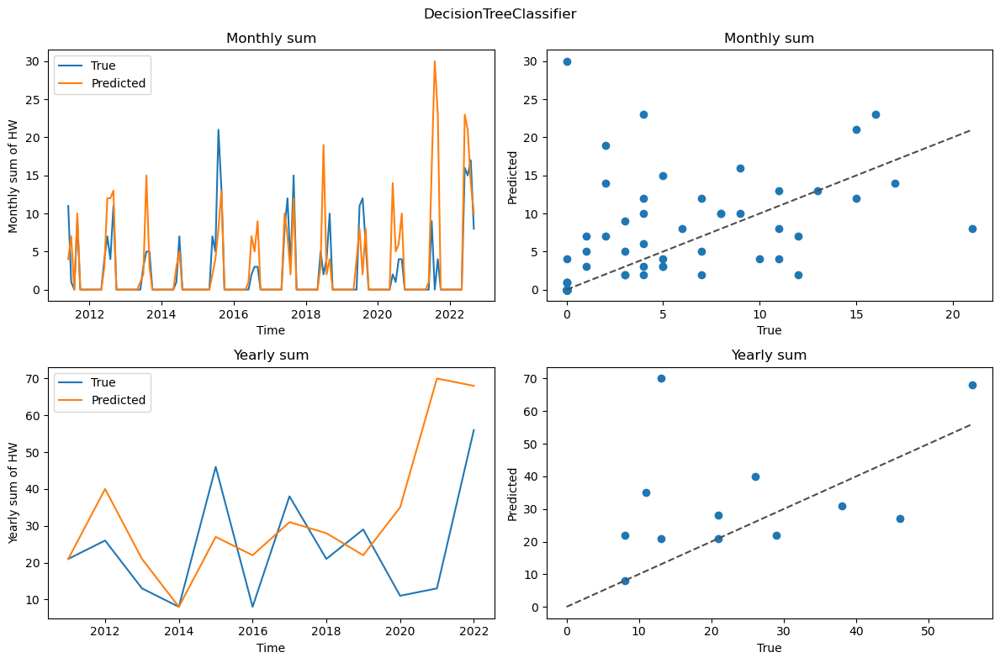

...

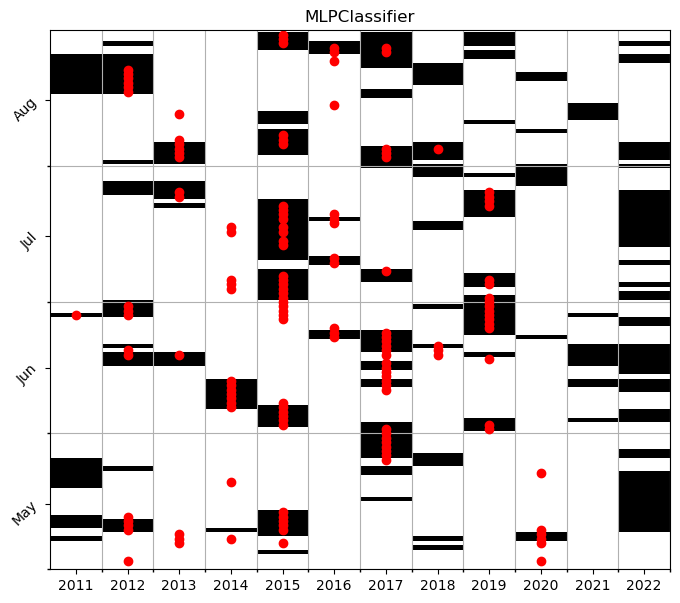

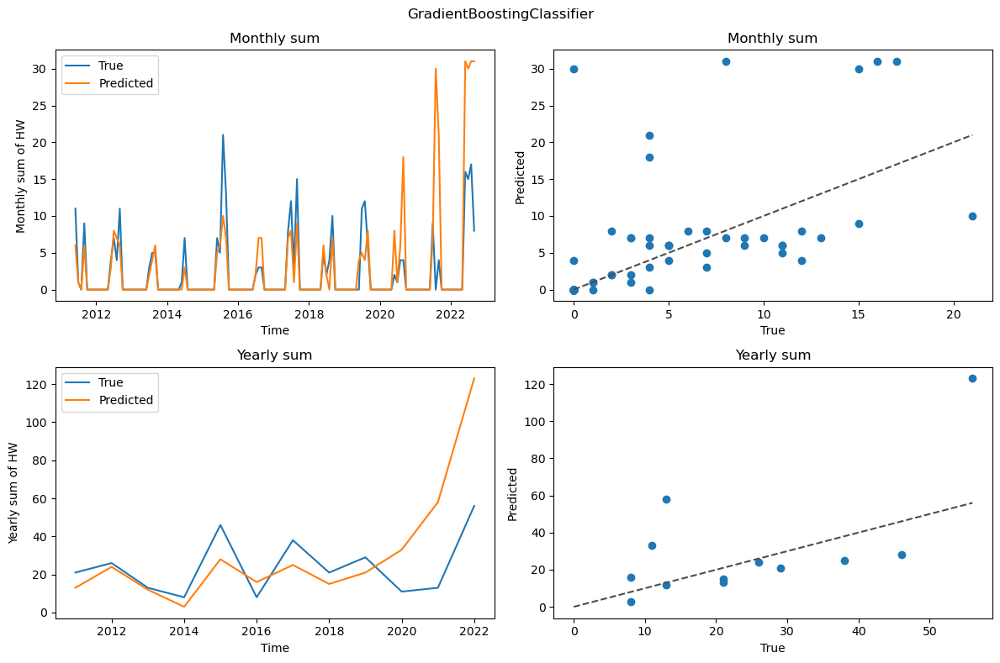

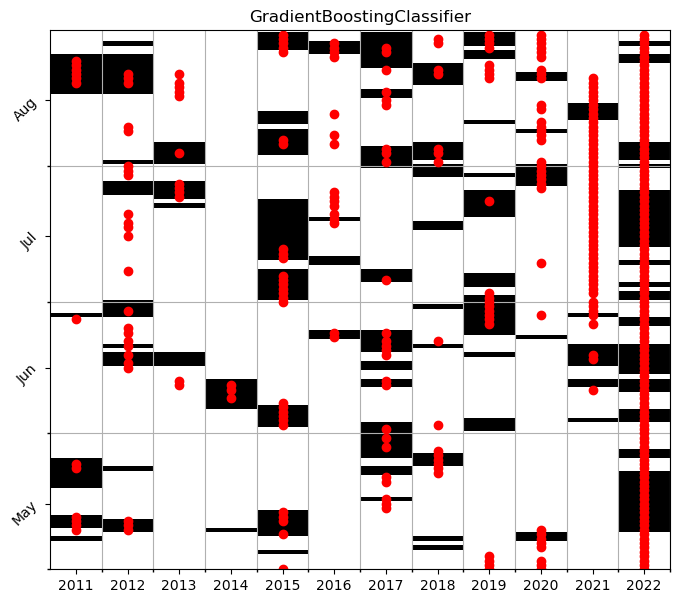

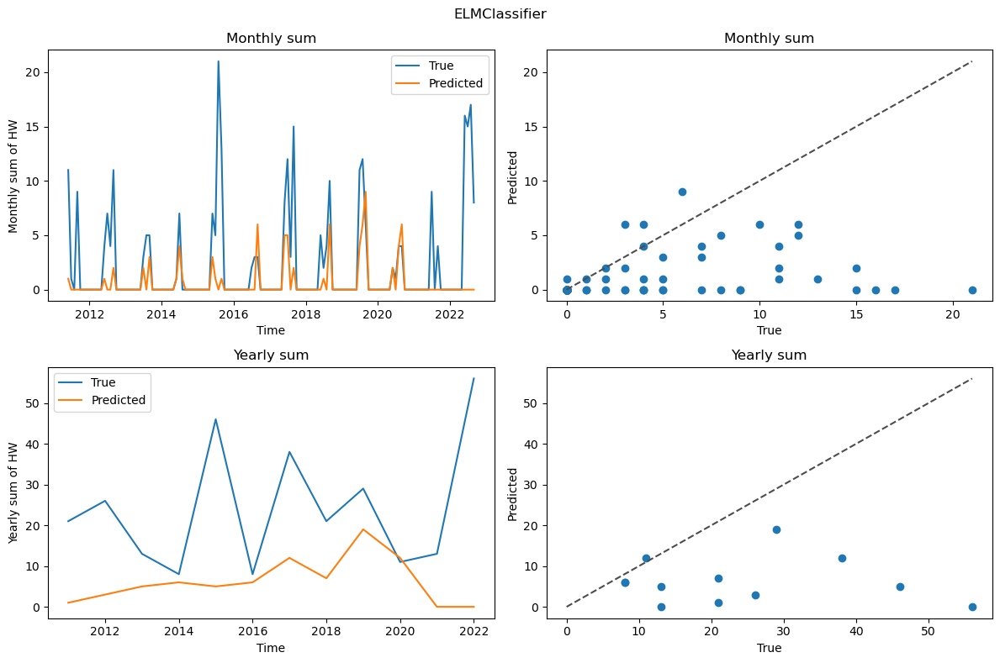

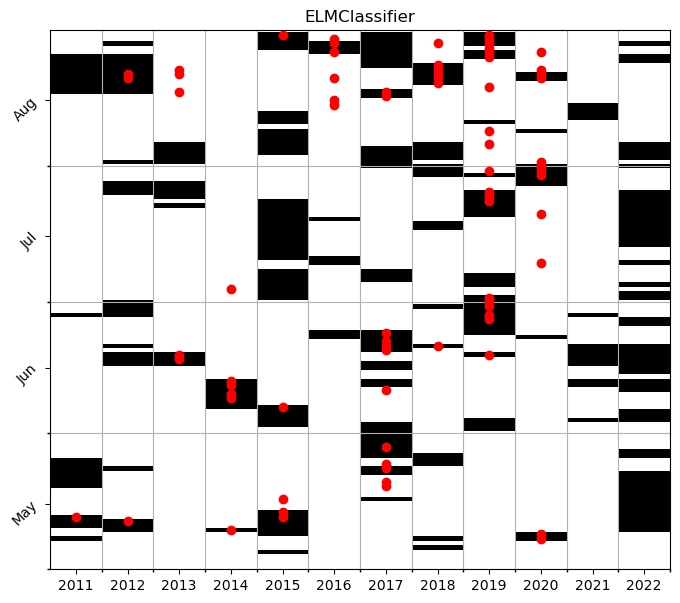

In [317]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)

    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [318]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.479310,0.540856,0.508227,0.886207,3.338983,13.250000,-0.035396,-0.737315
1,SVC,0.103448,0.937500,0.186335,0.110345,4.372881,21.500000,-0.578843,-1.918838
2,DecisionTreeClassifier,0.496552,0.366412,0.421669,1.355172,4.016949,14.083333,-0.614588,-0.845032
3,RandomForestClassifier,0.131034,0.730769,0.222222,0.179310,4.067797,19.833333,-0.291670,-1.255330
4,GaussianNB,0.762069,0.194371,0.309741,3.920690,16.694915,82.083333,-12.857584,-32.022441
5,KNeighborsClassifier,0.024138,0.388889,0.045455,0.062069,4.711864,22.666667,-0.798160,-2.374392
6,AdaBoostClassifier,0.437931,0.682796,0.533613,0.641379,2.779661,11.000000,0.200279,-0.380875
7,MLPClassifier,0.368966,0.732877,0.490826,0.503448,3.389831,13.666667,-0.023885,-0.689814
8,GradientBoostingClassifier,0.575862,0.450135,0.505295,1.279310,3.949153,16.916667,-0.872679,-1.898267
9,ELMClassifier,0.179310,0.684211,0.284153,0.262069,3.932203,18.000000,-0.417687,-1.603167


#### Locals variables

In [94]:
pred_dataframe = pd.read_csv('../Predictors/'+experiment+'/locals_variables.csv', index_col=0)
pred_dataframe.index = pd.to_datetime(pred_dataframe.index)

In [95]:
pred_dataframe = pred_dataframe[pred_dataframe.index.isin(target_dataset.index)]

In [96]:
# train_dataset_opt = dataset_opt[train_indices]
# test_dataset_opt = dataset_opt[test_indices]

Y_column = 'Target' 
            
Y_train=target_dataset[train_indices]
X_train=pred_dataframe[pred_dataframe.index.isin(Y_train.index)]

Y_test=target_dataset[test_indices]
X_test=pred_dataframe[pred_dataframe.index.isin(Y_test.index)]

    
from sklearn import preprocessing
scaler = preprocessing.StandardScaler()
X_std_train = scaler.fit(X_train)

X_std_train = scaler.transform(X_train)
X_std_val = scaler.transform(X_test)

X_train=pd.DataFrame(X_std_train,columns=X_train.columns,index=X_train.index)
X_test=pd.DataFrame(X_std_val,columns=X_test.columns,index=X_test.index)

In [97]:
X_train['day']=X_train.index.dayofyear
X_test['day']=X_test.index.dayofyear

In [216]:
X_train

,msl,olr,sm1,t2m,tp,z500,day
1951-05-01,1.309682,0.720693,0.575219,-0.507948,-0.484438,0.177647,121
1951-05-02,0.269065,-0.524572,0.475153,0.034367,-0.349864,0.249878,122
1951-05-03,-0.690741,-0.484164,0.455109,-0.034812,-0.238886,-0.160393,123
1951-05-04,-0.918901,0.661423,0.804306,-0.334795,0.848048,-0.573830,124
1951-05-05,-0.474675,-0.446247,0.913714,-0.020660,-0.261617,-0.571590,125
...,...,...,...,...,...,...,...
2010-08-27,-1.008198,0.811508,0.331104,0.567038,0.090356,0.331293,239
2010-08-28,-1.295634,-1.027113,0.475990,0.316440,-0.508329,-0.631975,240
2010-08-29,-0.149797,-0.465082,0.088948,-0.313078,-0.515178,-0.919808,241
2010-08-30,-1.144312,-0.610523,-0.122395,-0.490978,-0.420000,-2.046620,242


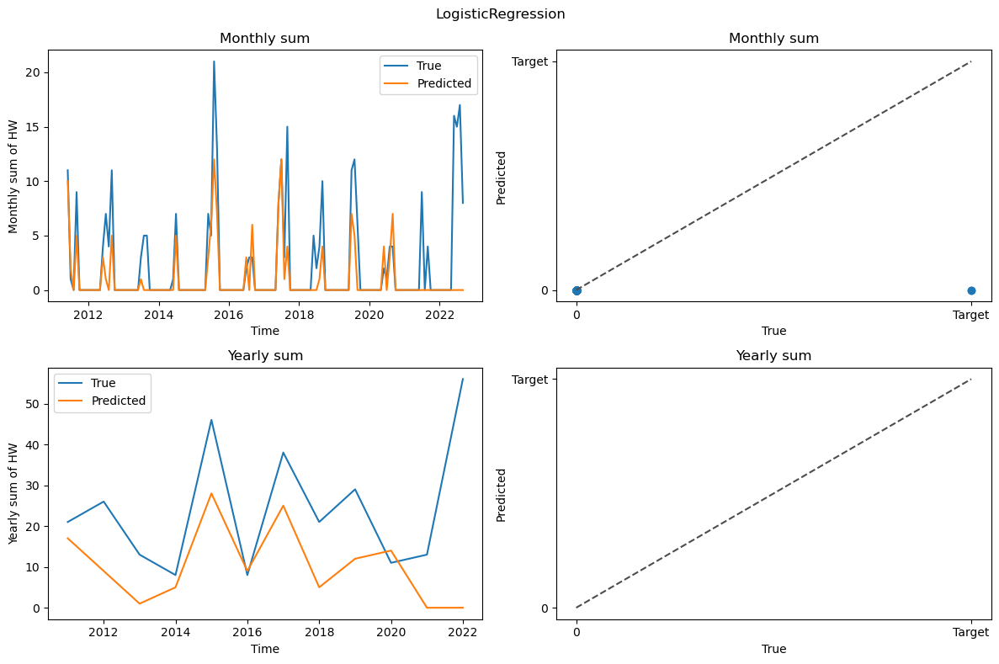

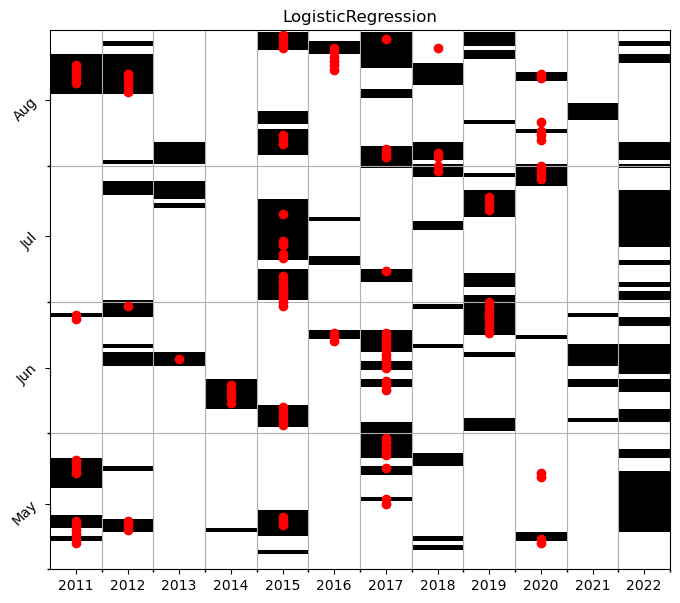

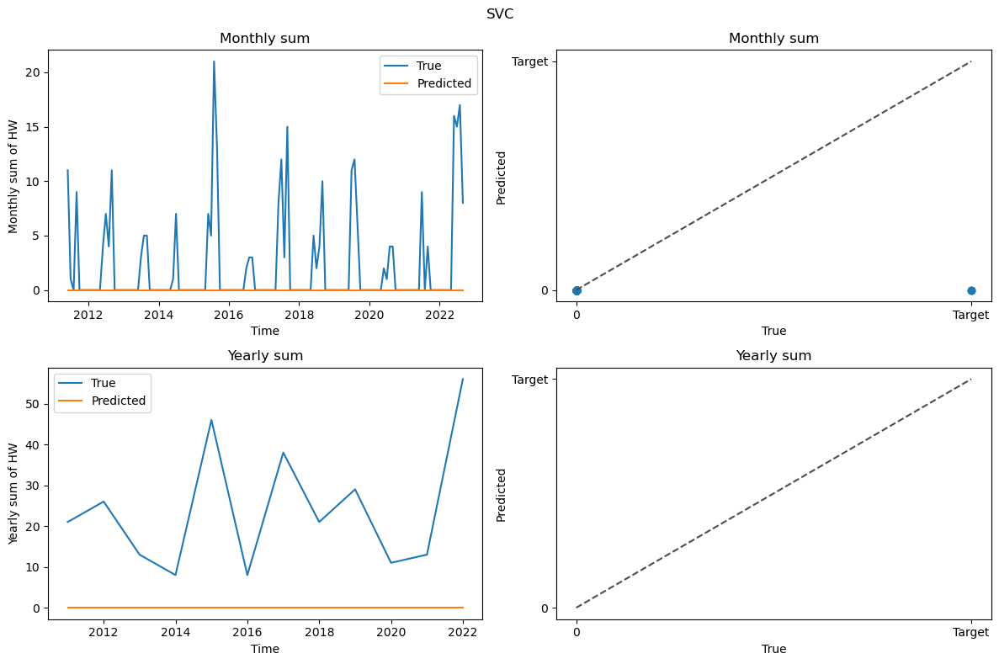

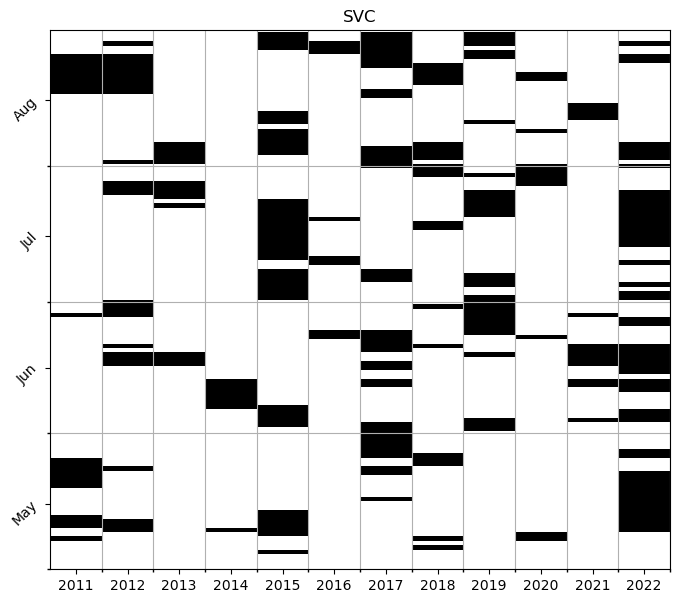

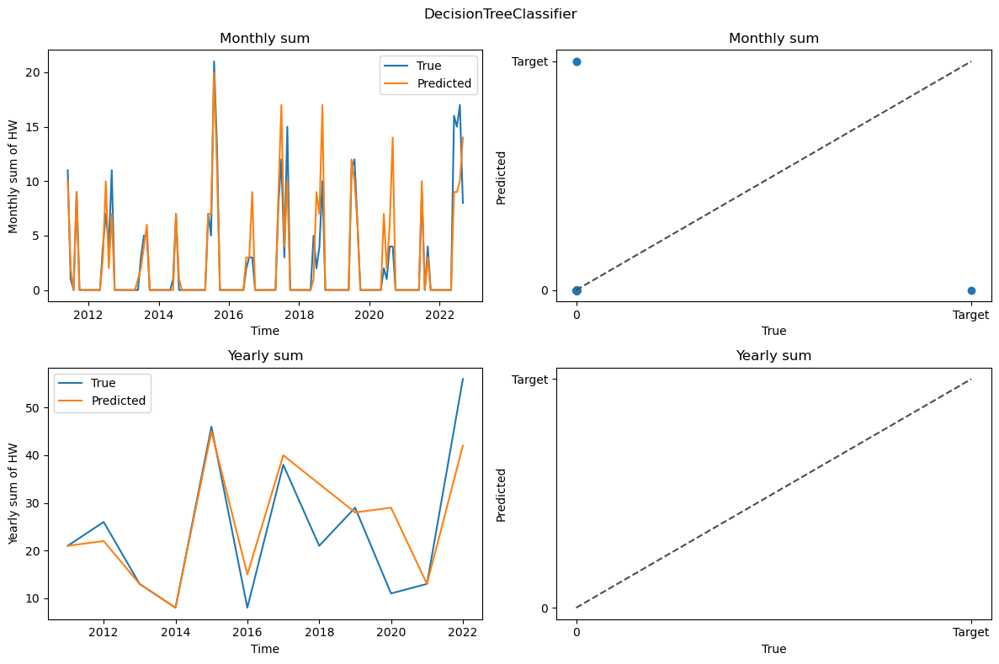

...

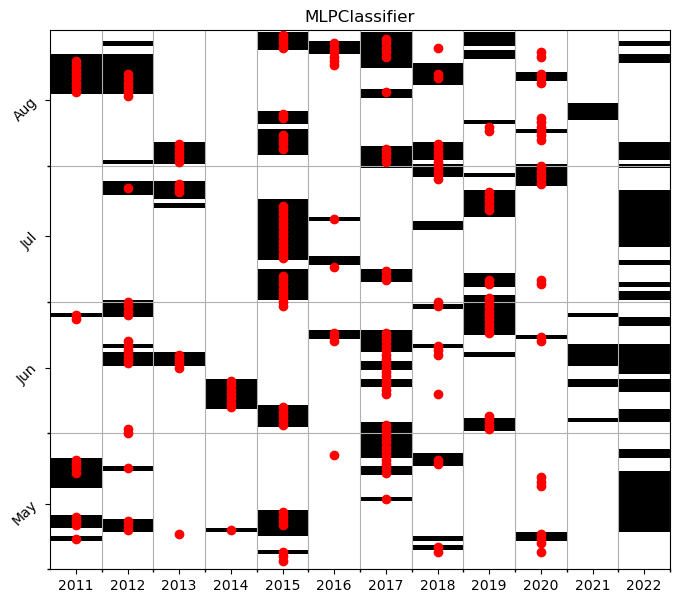

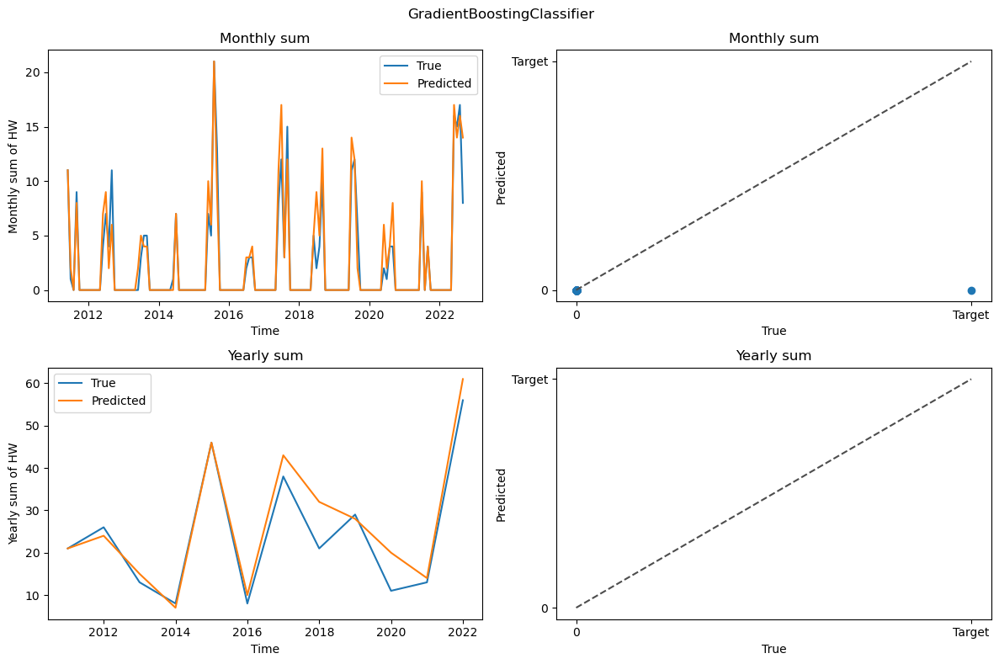

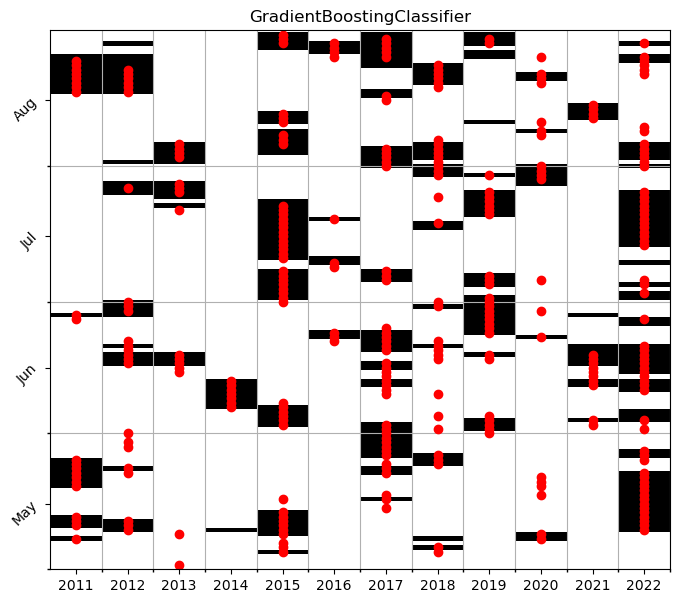

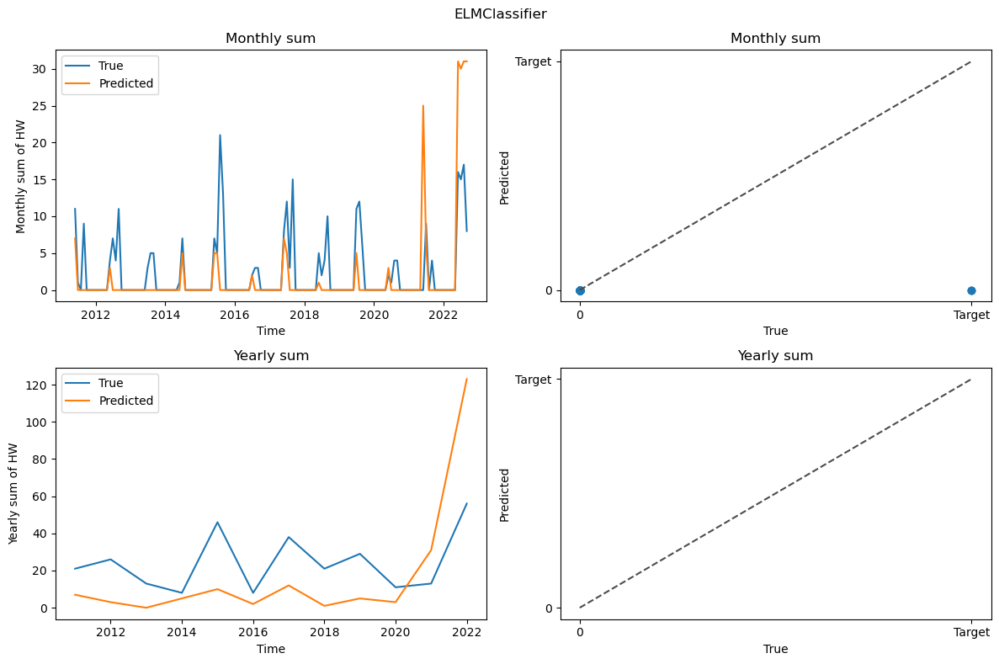

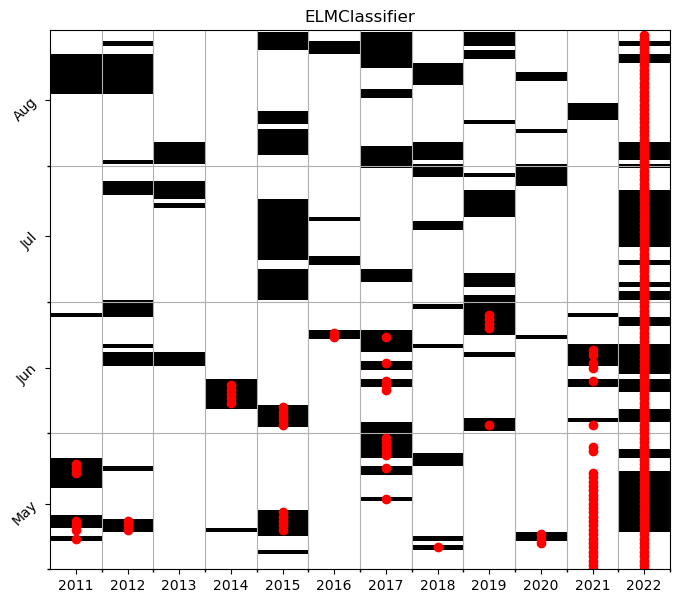

In [98]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]

    
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)
    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [99]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.355172,0.824000,0.496386,0.431034,3.169492,14.416667,0.051846,-0.799402
1,SVC,0.000000,0.000000,0.000000,0.000000,4.915254,24.166667,-0.863592,-2.621244
2,DecisionTreeClassifier,0.734483,0.687097,0.710000,1.068966,1.898305,5.000000,0.657089,0.715746
3,RandomForestClassifier,0.731034,0.806084,0.766727,0.906897,1.847458,6.916667,0.633461,0.422142
4,GaussianNB,0.613793,0.566879,0.589404,1.082759,3.389831,14.000000,-0.040849,-0.843162
5,KNeighborsClassifier,0.065517,0.863636,0.121795,0.075862,4.542373,22.333333,-0.638216,-2.213564
6,AdaBoostClassifier,0.810345,0.833333,0.821678,0.972414,1.525424,5.333333,0.786741,0.753148
7,MLPClassifier,0.606897,0.768559,0.678227,0.789655,2.389831,9.083333,0.266317,-0.370029
8,GradientBoostingClassifier,0.868966,0.785047,0.824877,1.106897,1.338983,3.250000,0.828545,0.900137
9,ELMClassifier,0.362069,0.519802,0.426829,0.696552,4.644068,21.500000,-1.105931,-2.277896


In [220]:
X_test

,msl,olr,sm1,t2m,tp,z500,day
2011-05-01,-1.744326,-0.882555,-0.858636,0.424203,-0.380881,-0.766065,121
2011-05-02,-1.575331,0.042025,-1.031454,0.457159,-0.038485,-0.497475,122
2011-05-03,-1.940527,-0.123145,-1.022666,0.673257,-0.483511,-0.685981,123
2011-05-04,-0.369518,-1.270196,-1.314979,0.292375,-0.433465,-0.327930,124
2011-05-05,1.638390,-0.752585,-1.444018,0.178449,-0.482386,0.740980,125
...,...,...,...,...,...,...,...
2022-08-27,-0.758043,1.052052,-2.724828,0.843239,-0.255651,-68.358741,239
2022-08-28,-0.245006,0.155890,-2.685523,0.868327,-0.308170,-68.346080,240
2022-08-29,0.401810,-0.983587,-2.458196,1.165807,-0.522568,-68.328967,241
2022-08-30,0.507396,0.909054,-2.170710,0.902279,-0.112046,-68.303814,242


#### Merge

In [487]:
X_train_0 = pd.read_csv('../Results/'+experiment+'/X_train_75.csv', index_col=0)
X_train_1 = pd.read_csv('../Results/'+'Test12_low_NOVIP1'+'/X_train_75.csv', index_col=0)
X_train_2 = pd.read_csv('../Results/'+'Test12_low_NOVIP2'+'/X_train_75.csv', index_col=0)

X_test_0 = pd.read_csv('../Results/'+experiment+'/X_test_75.csv', index_col=0)
X_test_1 = pd.read_csv('../Results/'+'Test12_low_NOVIP1'+'/X_test_75.csv', index_col=0)
X_test_2 = pd.read_csv('../Results/'+'Test12_low_NOVIP2'+'/X_test_75.csv', index_col=0)

In [488]:
X_train = X_train_0
X_test = X_test_0

X_train.shape

(7380, 441)

In [489]:
var1s = ['mslEurope_cluster2','sicArtic_cluster4','sstWorld_cluster1','sstWorld_cluster4','z500World_cluster3','tpEurope_cluster4','tpEurope_cluster5','localsm']
for var1 in var1s:
    filter_col = [col for col in X_train_1 if col.startswith(var1)]
    X_train[filter_col] = X_train_1[filter_col]
    X_test[filter_col] = X_test_1[filter_col]

X_train.shape

(7380, 534)

In [490]:
var2s = ['smEurope_cluster1','sicArtic_cluster1','sstWorld_cluster5','olrNorthAtlantic_cluster2','olrWorld_cluster4']
for var2 in var2s:
    filter_col = [col for col in X_train_2 if col.startswith(var2)]
    X_train[filter_col] = X_train_2[filter_col]
    X_test[filter_col] = X_test_2[filter_col]

X_train.shape

(7380, 591)

In [475]:
X_train_VIP = pd.DataFrame()
X_test_VIP = pd.DataFrame()

varVIPs = ['localt2m','z500World_cluster1','t2mEurope_cluster1','localz500','localolr','tpEurope_cluster5']
for var2 in varVIPs:
    filter_col = [col for col in X_train if col.startswith(var2)]
    X_train_VIP[filter_col] = X_train[filter_col]
    X_test_VIP[filter_col] = X_test[filter_col]

X_train_VIP.shape

(7380, 93)

In [463]:
X_train_VIP

,localt2m_lag0,localt2m_lag1,localt2m_lag2,localt2m_lag3,localt2m_lag4,localt2m_lag5,localt2m_lag6,localt2m_lag7,localt2m_lag8,localt2m_lag9,...,localolr_lag45,tpEurope_cluster5_lag32,tpEurope_cluster5_lag33,tpEurope_cluster5_lag34,tpEurope_cluster5_lag35,tpEurope_cluster5_lag36,tpEurope_cluster5_lag37,tpEurope_cluster5_lag38,tpEurope_cluster5_lag39,tpEurope_cluster5_lag40
Date,,,,,,,,,,,,,,,,,,,,,
1951-05-01,-1.529645,-2.060206,-2.107843,-1.404929,-1.236654,-1.381099,-0.932347,-1.271449,-1.203409,-0.889217,...,0.611893,-0.442708,-0.711013,-0.668279,-0.927867,0.224754,-0.312659,-0.451797,0.759390,2.206562
1951-05-02,-1.015545,-1.512552,-2.038546,-2.086239,-1.387806,-1.220108,-1.363176,-0.917089,-1.254964,-1.186318,...,1.121717,0.985357,-0.441237,-0.709226,-0.667947,-0.924923,0.223765,-0.311359,-0.450805,0.758115
1951-05-03,-1.045018,-1.001111,-1.493970,-2.017306,-2.065971,-1.370584,-1.202940,-1.346034,-0.902121,-1.237637,...,0.868791,0.489383,0.981894,-0.440136,-0.708781,-0.666051,-0.923808,0.224731,-0.310449,-0.448993
1951-05-04,-1.279140,-1.030431,-0.985403,-1.475593,-1.997357,-2.045717,-1.352711,-1.186499,-1.329230,-0.886408,...,-0.301349,-0.829357,0.487634,0.979381,-0.440433,-0.706720,-0.665410,-0.922128,0.225328,-0.308995
1951-05-05,-0.968827,-1.263343,-1.014558,-0.969700,-1.458144,-1.977410,-2.024677,-1.335615,-1.170378,-1.311563,...,-0.309071,1.595111,-0.826551,0.486376,0.975168,-0.439455,-0.706005,-0.663891,-0.920861,0.225416
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2010-08-27,0.642130,1.055626,0.968278,0.864756,0.902532,1.135333,1.037887,0.714193,0.714048,0.444301,...,-0.153152,0.421836,-0.845133,-0.377102,-0.824347,-0.754163,1.656490,0.427522,-0.045448,0.102593
2010-08-28,0.401908,0.647995,1.059775,0.973709,0.871401,0.909514,1.141452,1.044533,0.722180,0.722366,...,-0.168267,-0.516005,0.420320,-0.843005,-0.377573,-0.821820,-0.753361,1.656564,0.428002,-0.044670
2010-08-29,-0.175533,0.409014,0.654434,1.064725,0.979851,0.878522,0.916693,1.147647,1.051106,0.730460,...,-1.544951,-0.814879,-0.514281,0.419234,-0.842191,-0.376848,-0.820894,-0.751786,1.656327,0.427572


In [491]:
X_test.shape

(1476, 591)

In [492]:
X_train = np.array(X_train)
X_test = np.array(X_test)

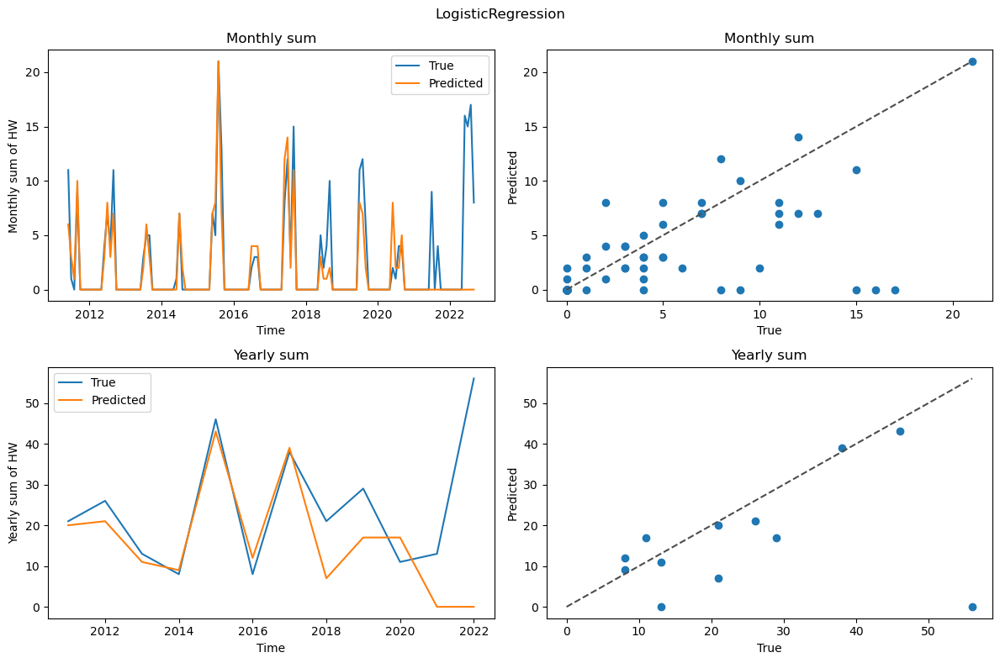

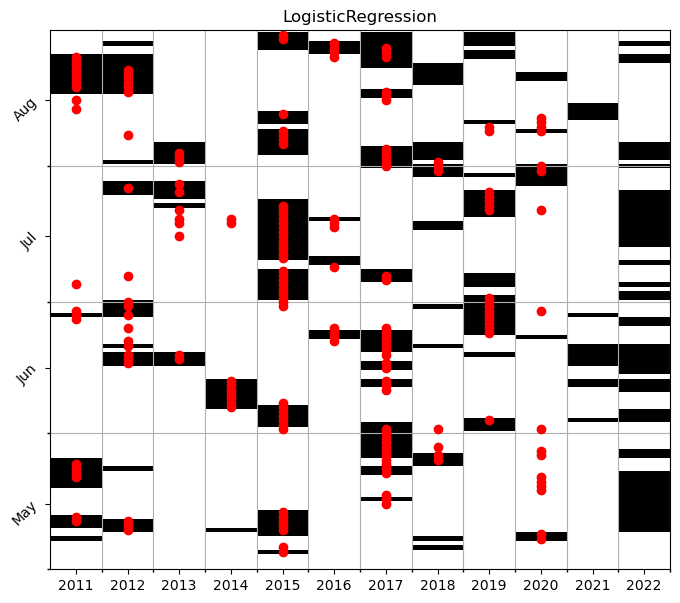

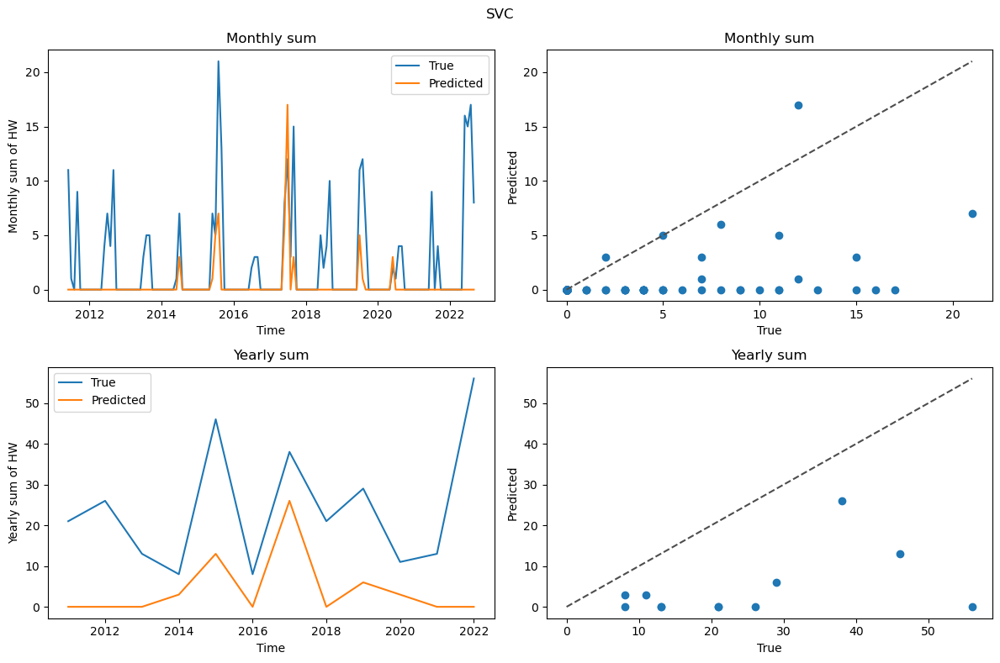

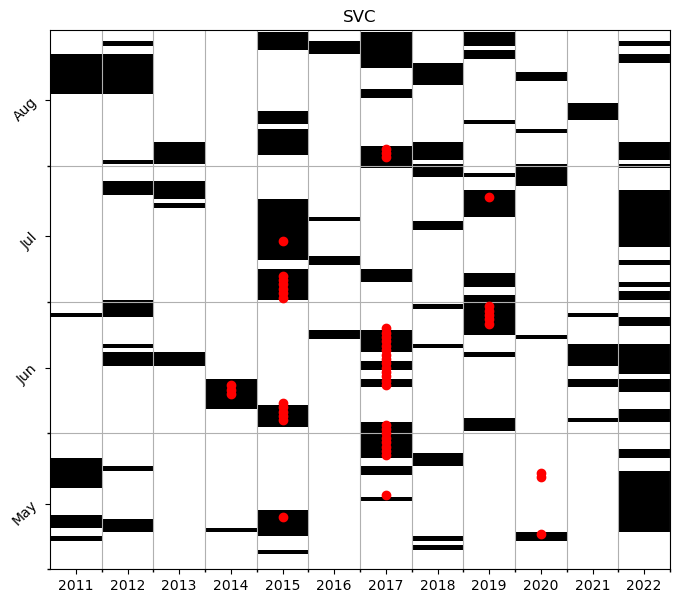

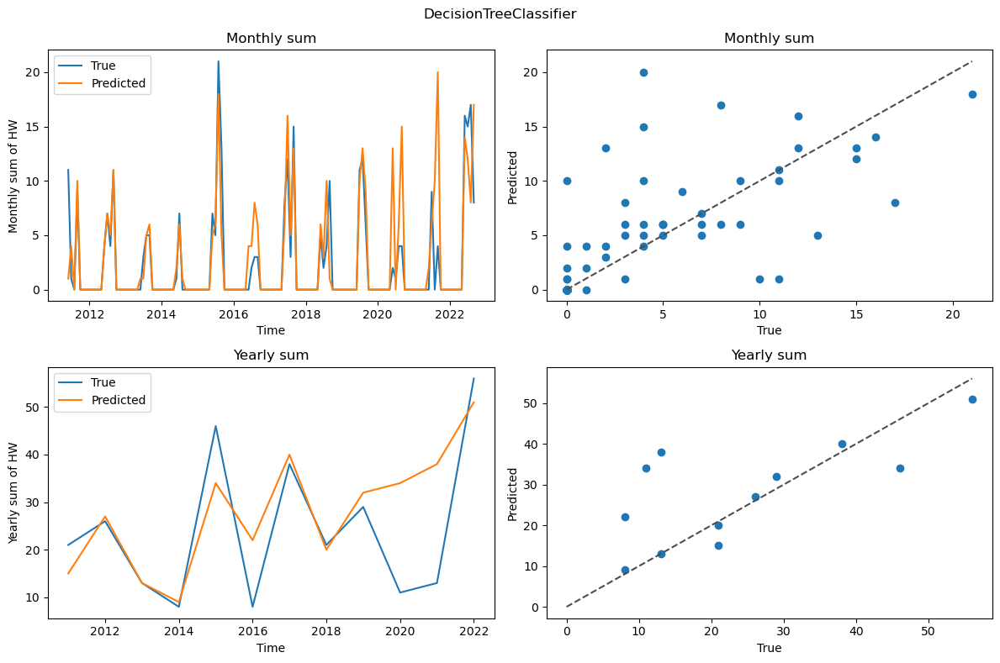

...

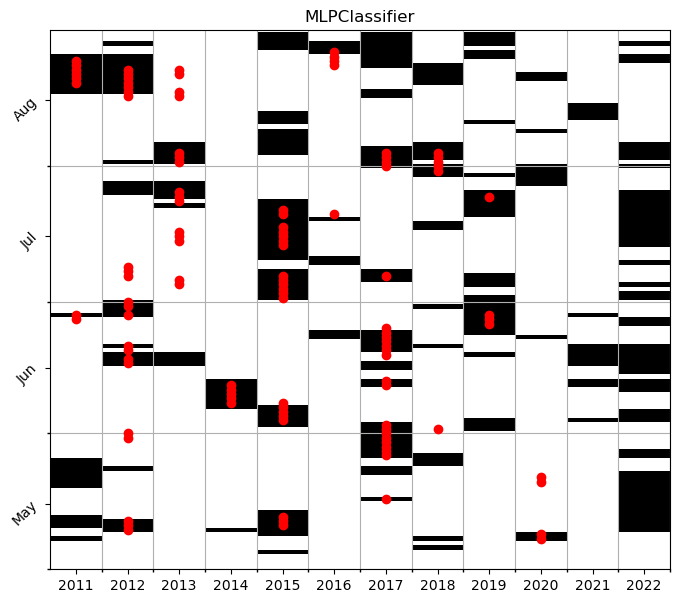

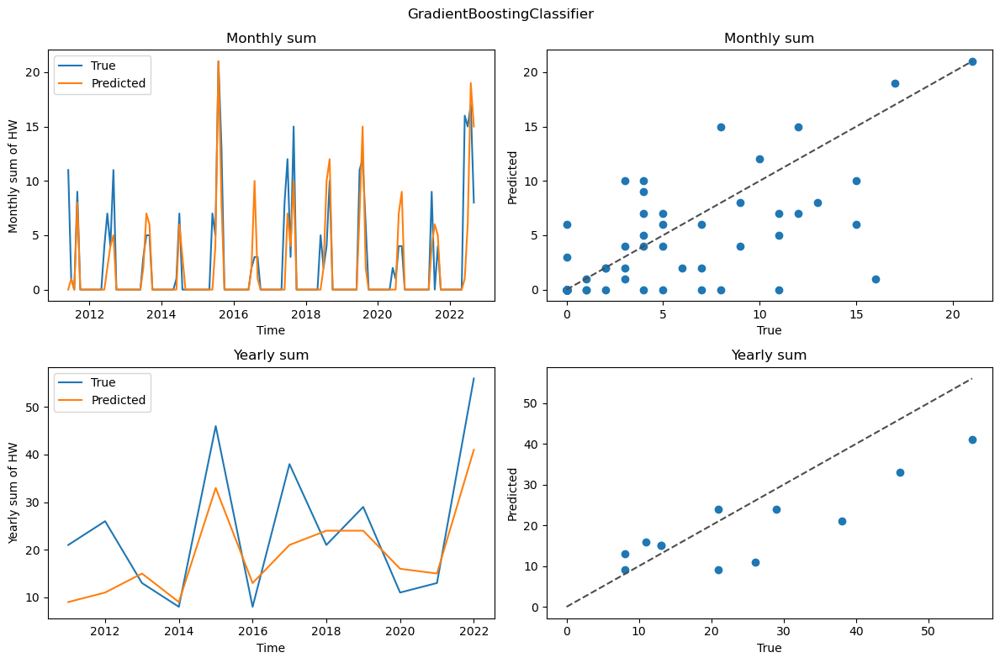

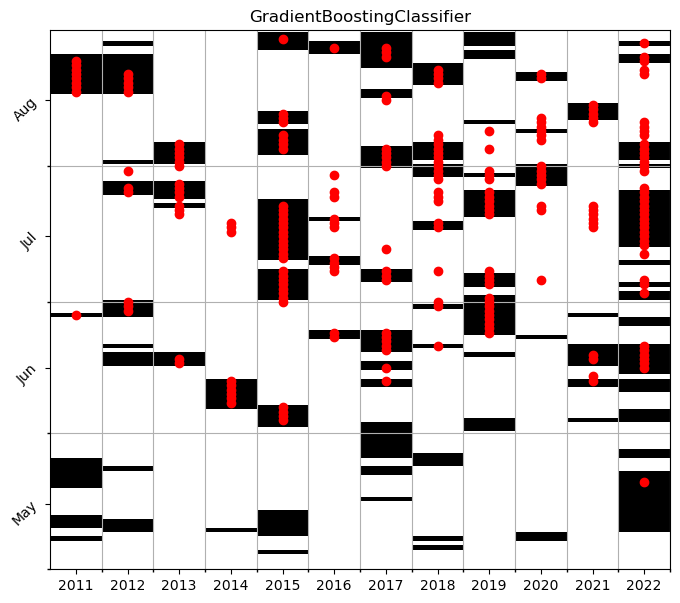

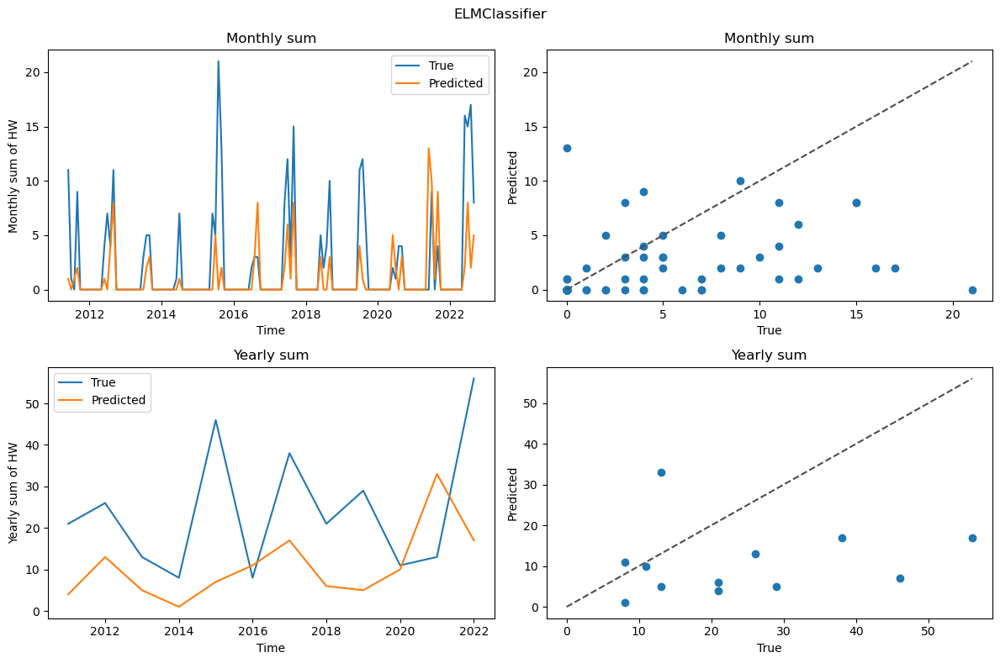

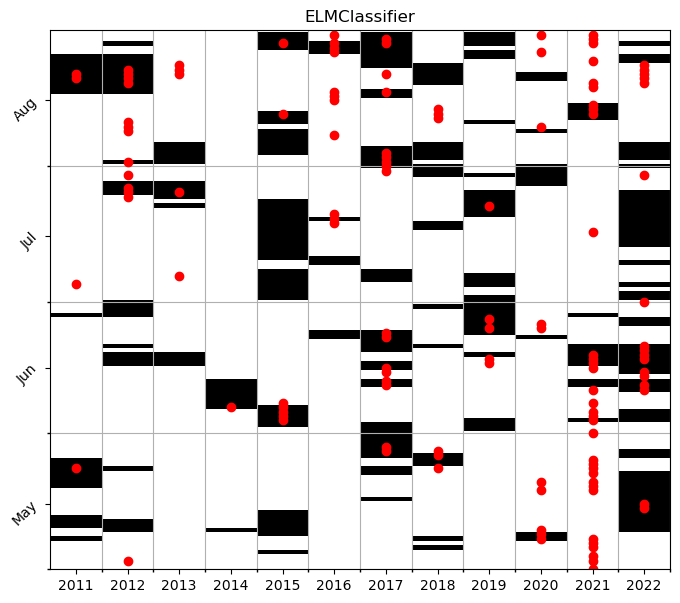

In [493]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]

    
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)
    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

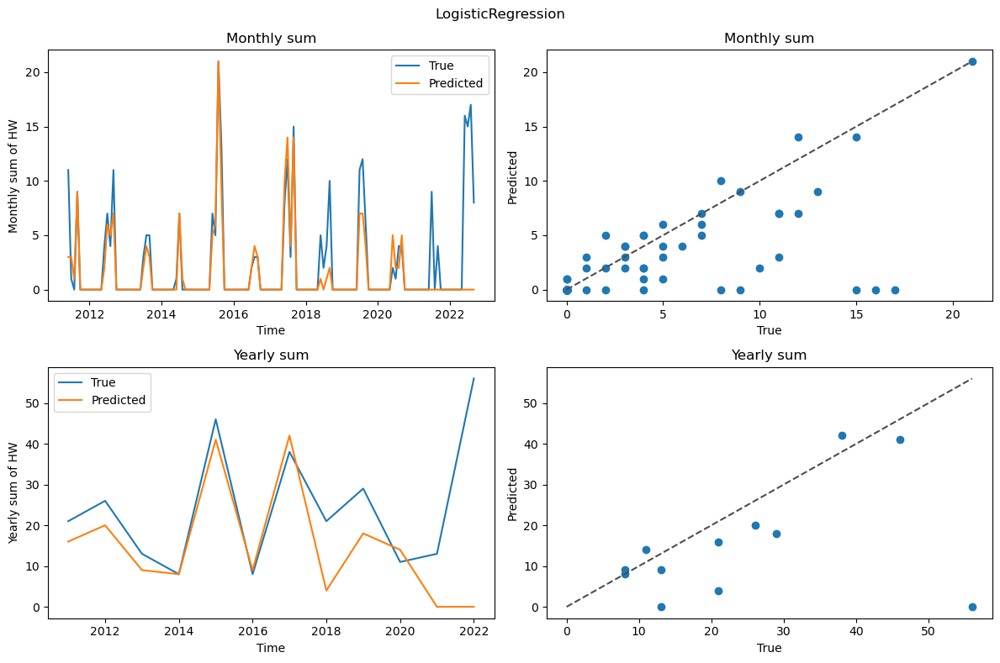

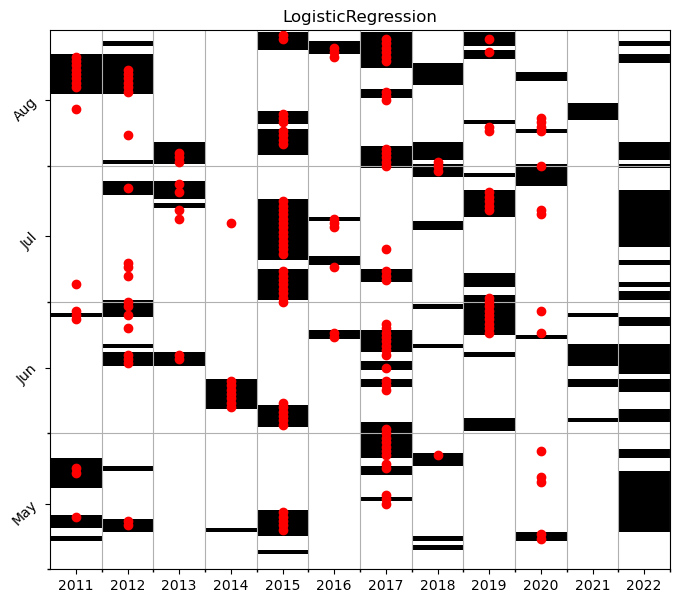

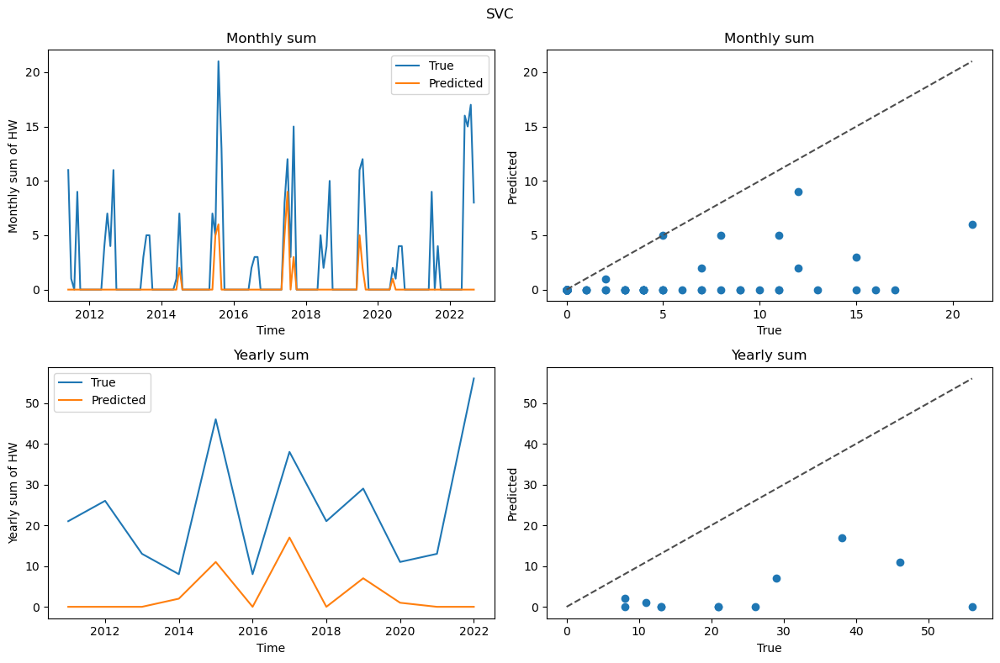

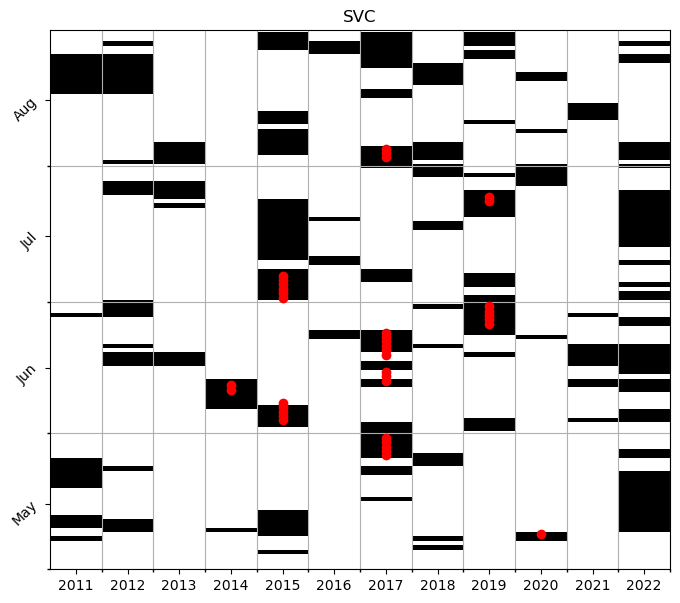

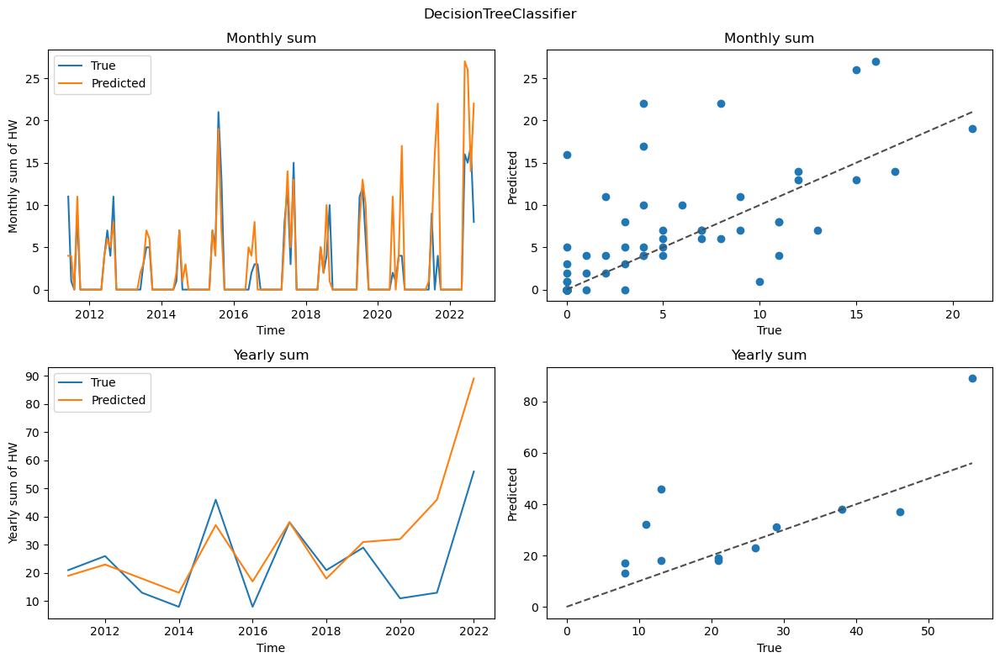

...

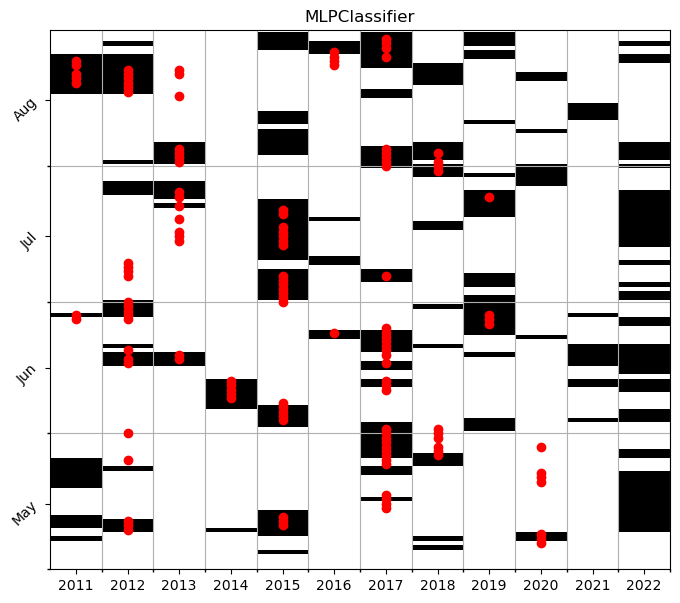

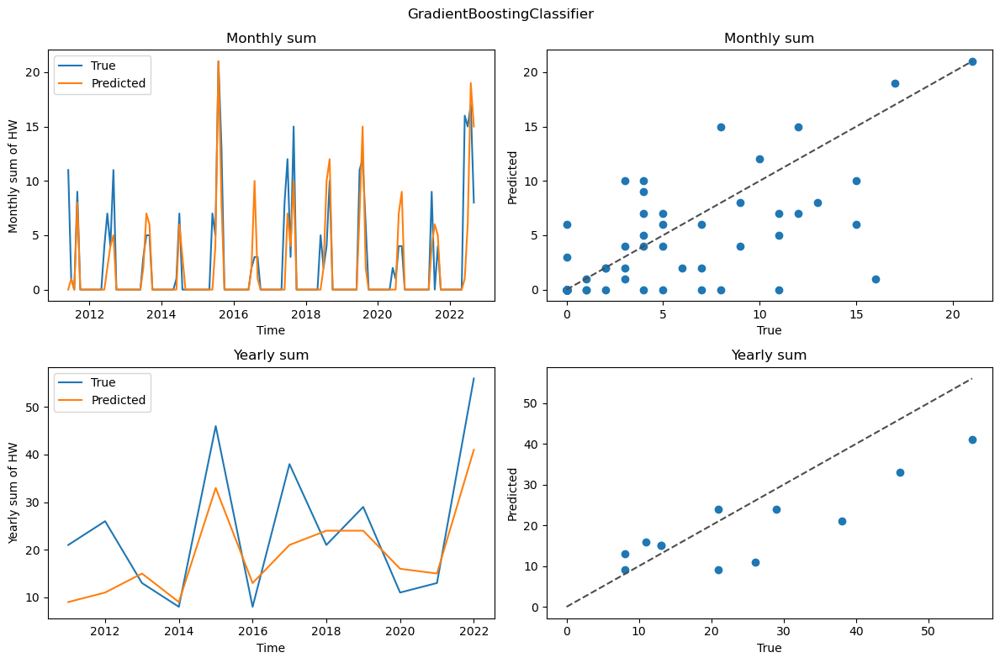

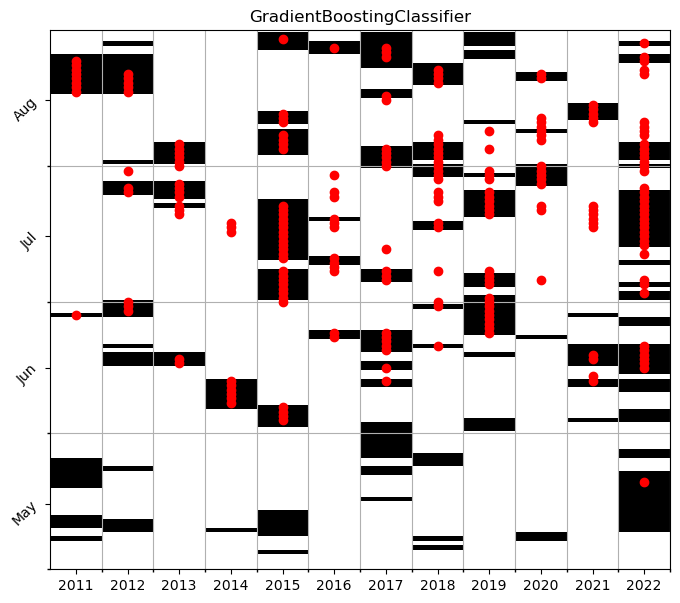

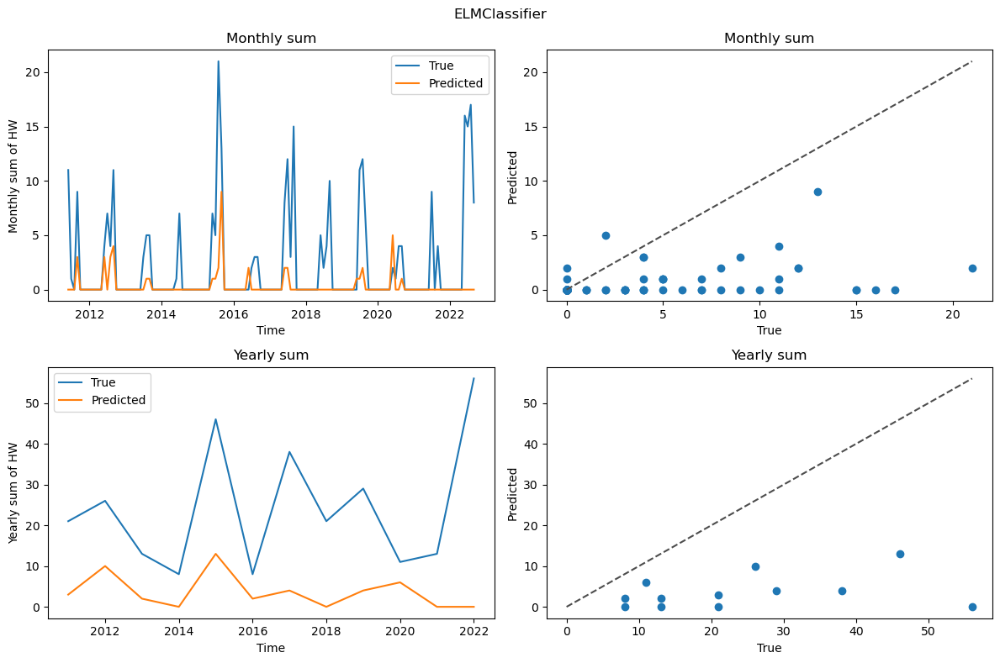

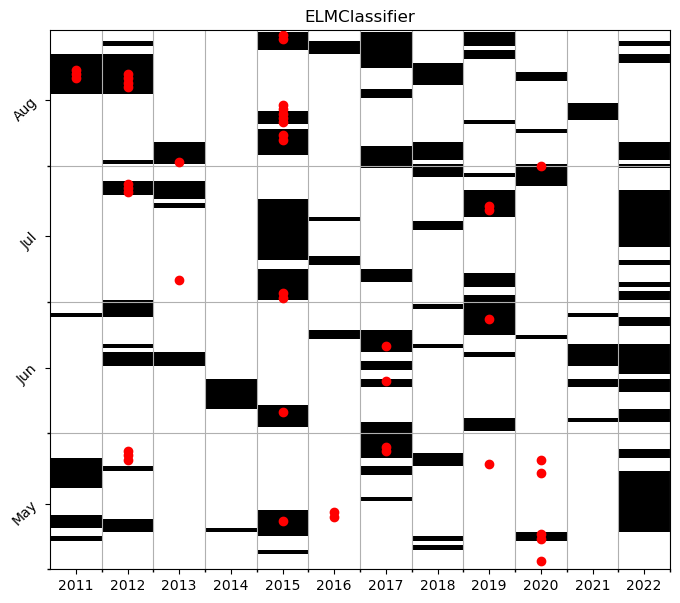

In [ ]:
#LR
from sklearn.linear_model import LogisticRegression
clf_LR = LogisticRegression()
#SVC
from sklearn.svm import SVC
clf_SVC = SVC()
#DT
from sklearn.tree import DecisionTreeClassifier
clf_DT = DecisionTreeClassifier(max_depth=400, random_state=0)
#RF
from sklearn.ensemble import RandomForestClassifier
clf_RF = RandomForestClassifier(max_depth=400, random_state=0)
#Naive Bayes
from sklearn.naive_bayes import GaussianNB
clf_NB = GaussianNB()
#KNeighbors
from sklearn.neighbors import KNeighborsClassifier
clf_neigh = KNeighborsClassifier(n_neighbors=20,algorithm='brute')
#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
clf_AB = AdaBoostClassifier(n_estimators=50, random_state=0)
#MLP
from sklearn.neural_network import MLPClassifier
clf_MLP = MLPClassifier(hidden_layer_sizes=500,random_state=1, max_iter=300)
#Gradient Boosting
from sklearn.ensemble import GradientBoostingClassifier
clf_GB = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
from skelm import ELMClassifier
clf_ELM = ELMClassifier(pairwise_metric=None)

ML_models = [clf_LR, clf_SVC, clf_DT, clf_RF, clf_NB, clf_neigh, clf_AB, clf_MLP, clf_GB, clf_ELM]
results=pd.DataFrame(data={'Method':[],'Recall':[],'Precision':[],'F1-score':[],'HW-Diff':[],'Month_MAE':[],'Year_MAE':[],'Month_R2':[],'Year_R2':[]})
for clf in ML_models:
    clf.fit(X_train, Y_train)
    predictions = clf.predict(X_test)
    Y_pred = pd.DataFrame(predictions, columns=['Y_pred'], index=Y_test.index)

    #Calculate monthly and yearly sums
    monthly_sum_test = Y_test.resample('M').sum()

    monthly_sum_pred = Y_pred.resample('M').sum()


    year_sum_test = Y_test.resample('Y').sum()
    year_sum_pred = Y_pred.resample('Y').sum()

    # Plotting
    title = clf.__class__.__name__
    forecast_plots(monthly_sum_test, monthly_sum_pred, year_sum_test, year_sum_pred, title)
    monthly_sum_test = monthly_sum_test[monthly_sum_test.index.month.isin([5, 6, 7, 8, 9])]
    monthly_sum_pred = monthly_sum_pred[monthly_sum_pred.index.month.isin([5, 6, 7, 8, 9])]

    
    plotter(x,y,Y_pred.values.reshape((12,123)).T, Y_test.values.reshape((12,123)).T,title)
    # Metrics
    results = results.append({'Method':title,
                            'Recall':recall_score(Y_test, Y_pred),
                            'Precision':precision_score(Y_test, Y_pred),
                            'F1-score':f1_score(Y_test, Y_pred),
                            'HW-Diff':np.count_nonzero(Y_pred==1)/np.count_nonzero(Y_test==1),
                            'Month_MAE':mean_absolute_error(monthly_sum_test, monthly_sum_pred),
                            'Year_MAE':mean_absolute_error(year_sum_test, year_sum_pred),
                            'Month_R2':r2_score(monthly_sum_test, monthly_sum_pred),
                            'Year_R2':r2_score(year_sum_test, year_sum_pred)}, ignore_index=True)

In [495]:
results

,Method,Recall,Precision,F1-score,HW-Diff,Month_MAE,Year_MAE,Month_R2,Year_R2
0,LogisticRegression,0.500000,0.739796,0.596708,0.675862,2.576271,9.833333,0.242689,-0.398080
1,SVC,0.144828,0.823529,0.246334,0.175862,4.254237,19.916667,-0.447373,-1.598304
2,DecisionTreeClassifier,0.544828,0.471642,0.505600,1.155172,2.728814,7.750000,0.272375,0.412417
3,RandomForestClassifier,0.517241,0.852273,0.643777,0.606897,2.203390,9.500000,0.557730,0.418776
4,GaussianNB,0.996552,0.207466,0.343434,4.803448,18.694915,91.916667,-15.107708,-37.815235
5,KNeighborsClassifier,0.031034,0.409091,0.057692,0.075862,4.779661,22.333333,-0.801795,-2.245730
6,AdaBoostClassifier,0.472414,0.782857,0.589247,0.603448,2.796610,11.750000,0.014284,-0.683456
7,MLPClassifier,0.289655,0.743363,0.416873,0.389655,3.305085,15.083333,-0.103251,-0.967710
8,GradientBoostingClassifier,0.596552,0.748918,0.664107,0.796552,2.661017,7.916667,0.379005,0.571749
9,ELMClassifier,0.200000,0.449612,0.276850,0.444828,3.745763,17.250000,-0.225633,-0.969206


#### Sensitivity Analysis

In [27]:
from sklearn.linear_model import LogisticRegression

# Perform a sensitivity analysis
f1s = []
for col in X_train.columns:
    X_train_sen = X_train.drop(col,axis=1)
    X_test_sen = X_test.drop(col,axis=1)

    clf_LR = LogisticRegression()

    clf_LR.fit(X_train_sen, Y_train)
    Y_pred = clf_LR.predict(X_test_sen)

    f1s.append(f1_score(Y_test, Y_pred))

NameError: name 'X_train' is not defined

In [166]:

clf_LR = LogisticRegression()

clf_LR.fit(X_train, Y_train)
Y_pred = clf_LR.predict(X_test)

f1_score(Y_test, Y_pred)

0.6181102362204723

In [ ]:
board_filtered_sen = board_filtered.copy()

board_filtered_sen = board_filtered_sen.astype(float)

In [ ]:
f1s= np.array(f1s)

board_filtered_sen[board_filtered_sen!=0]=f1s

board_filtered_sen[board_filtered_sen!=0]

Text(0, 0.5, 'Days to target')

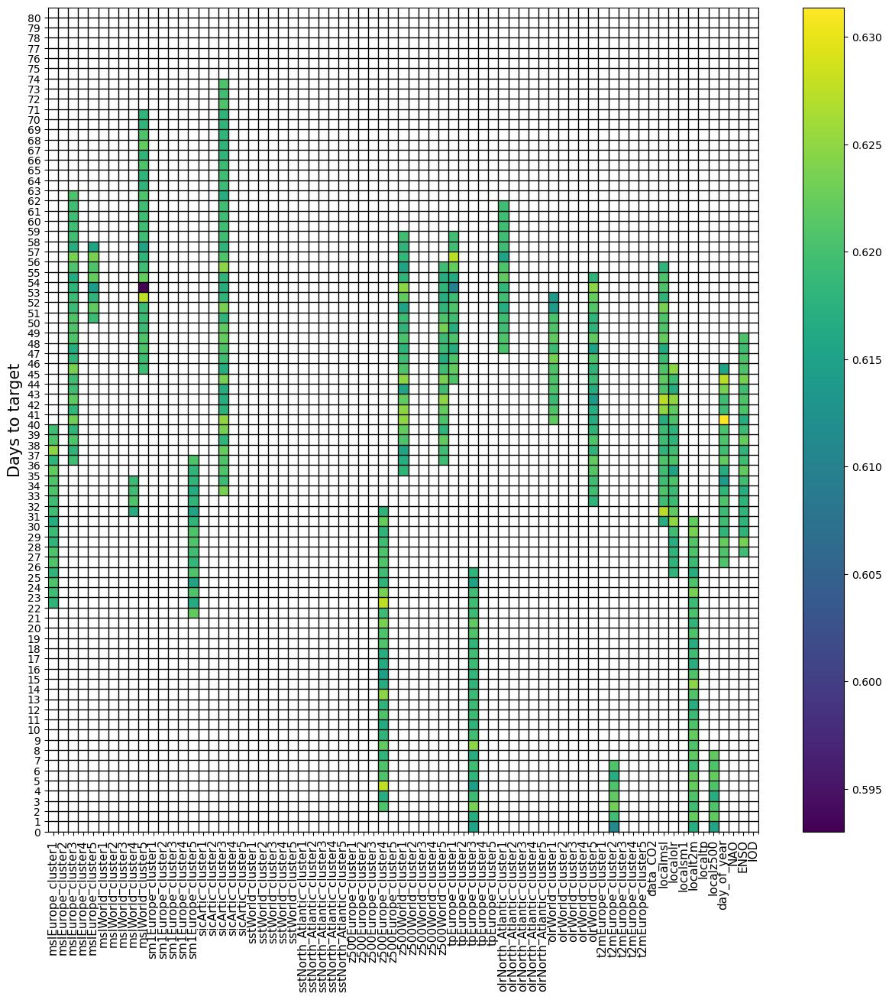

In [168]:
plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_filtered_sen.shape[0])-0.5,np.arange(board_filtered_sen.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.colorbar()
plt.ylabel('Days to target',fontsize=15)

# 

# for i in range(board_100.shape[1]):
#     if np.sum(board_100[:, i]) == 0:
#         rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
#         plt.gca().add_patch(rect)

In [34]:
# Assuming your DataFrame is named X_train
columns = X_train.columns

# Initialize an empty list to store unique prefixes in order of appearance
unique_prefixes = []

# Iterate over columns to extract and order unique prefixes
for col in columns:
    prefix = col.split('_l')[0]
    if prefix not in unique_prefixes:
        unique_prefixes.append(prefix)

# Print the unique prefixes in the order of appearance
print(unique_prefixes)

['mslEurope_cluster1', 'mslEurope_cluster3', 'mslEurope_cluster5', 'mslWorld_cluster4', 'mslWorld_cluster5', 'sm1Europe_cluster5', 'sicArtic_cluster3', 'z500Europe_cluster4', 'z500World_cluster1', 'z500World_cluster5', 'tpEurope_cluster1', 'tpEurope_cluster3', 'olrNorth_Atlantic_cluster1', 'olrWorld_cluster1', 'olrWorld_cluster5', 't2mEurope_cluster2', 'localmsl', 'localolr', 'localt2m', 'localz500', 'day_of_year', 'ENSO']


In [35]:
f1s=[]
for var1 in unique_prefixes:
    filter_col = [col for col in X_train if col.startswith(var1)]
    X_train_sen = X_train.drop(filter_col,axis=1)
    X_test_sen = X_test.drop(filter_col,axis=1)

    clf_LR = LogisticRegression()

    clf_LR.fit(X_train_sen, Y_train)
    Y_pred = clf_LR.predict(X_test_sen)

    f1s.append(f1_score(Y_test, Y_pred))
f1s = np.array(f1s)

In [235]:
f1s

array([0.61023622, 0.61876248, 0.6223092 , 0.62301587, 0.61143984,
       0.61568627, 0.60921844, 0.625     , 0.61290323, 0.628     ,
       0.63762376, 0.61023622, 0.61538462, 0.62598425, 0.61538462,
       0.61538462, 0.62301587, 0.61232604, 0.55491329, 0.59566075,
       0.6223092 , 0.62015504])

In [36]:
board_filtered_sen = board_filtered.copy()

board_filtered_sen = board_filtered_sen.astype(float)

In [37]:
selected_variables = np.where(np.sum(board_filtered_sen!=0,axis=0)!=0)[0]
for i in range(0,len(selected_variables)):
    board_filtered_sen[:,selected_variables[i]][board_filtered_sen[:,selected_variables[i]]!=0]=np.repeat(f1s[i],len(board_filtered_sen[:,selected_variables[i]][board_filtered_sen[:,selected_variables[i]]!=0]))

Text(0, 0.5, 'Days to target')

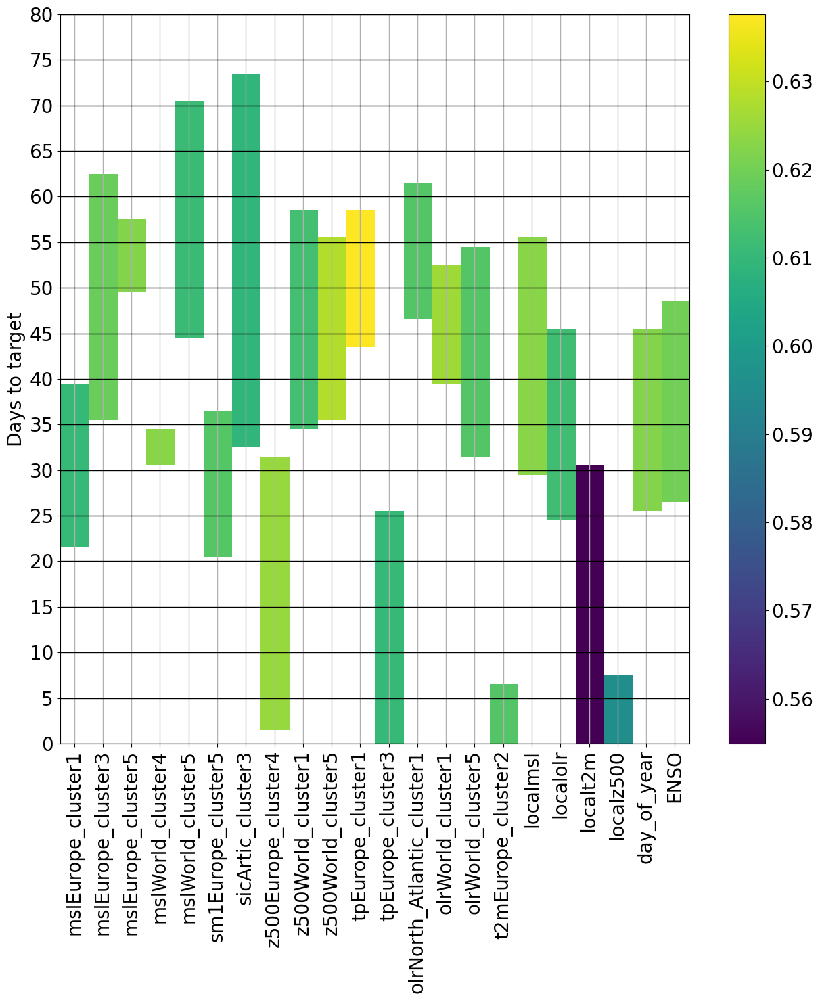

In [54]:
from matplotlib.ticker import MultipleLocator
# Just consider the columns of the board that have at least one day with a value greater than the threshold

board_filtered_sen = board_filtered_sen[:,np.any(board_filtered_sen, axis=0)]


plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
# Put xticks of columns with at least one day with a value greater than the threshold

column_names = pred_dataframe_opt.columns.tolist()
column_names = np.array(column_names)[np.any(board_filtered, axis=0)]

plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=20)

# Put just one of each 5 yticks
plt.gca().yaxis.set_major_locator(MultipleLocator(5))

plt.yticks(fontsize=20)
plt.ylim(0,80)
# Put the yticks labels

plt.gca().xaxis.grid( which='major',linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
cbar=plt.colorbar()
cbar.ax.tick_params(labelsize=20)
plt.ylabel('Days to target',fontsize=20)

Text(0, 0.5, 'Days to target')

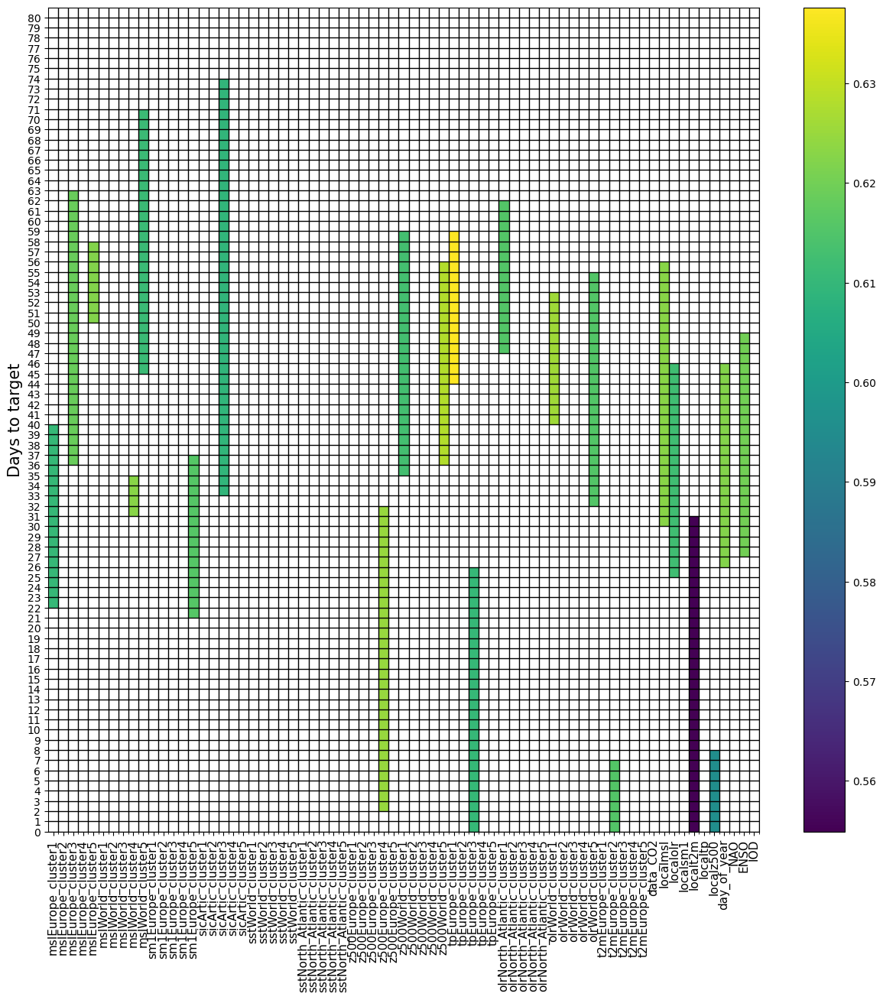

In [38]:
plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_filtered_sen.shape[0])-0.5,np.arange(board_filtered_sen.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.colorbar()
plt.ylabel('Days to target',fontsize=15)

# 

# for i in range(board_100.shape[1]):
#     if np.sum(board_100[:, i]) == 0:
#         rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
#         plt.gca().add_patch(rect)

In [55]:
# Iterate over unique prefixes
for prefix in unique_prefixes:
    # Filter columns that start with the current prefix
    filter_cols = [col for col in columns if col.startswith(prefix)]
    print(len(filter_cols))

18
27
8
4
26
16
41
30
24
20
15
26
15
13
23
7
26
21
31
8
20
22


In [56]:
f1s=[]
for var1 in unique_prefixes:
    filter_col = [col for col in X_train if col.startswith(var1)]

    for i in range(0,len(filter_col),3):
        # print(i,filter_col[i:i+3])
        X_train_sen = X_train.drop(filter_col[i:i+3],axis=1)
        X_test_sen = X_test.drop(filter_col[i:i+3],axis=1)


        clf_LR = LogisticRegression()

        clf_LR.fit(X_train_sen, Y_train)
        Y_pred = clf_LR.predict(X_test_sen)

        f1s.append(f1_score(Y_test, Y_pred))
f1s = np.array(f1s)

In [57]:
board_filtered_sen = board_filtered.copy()

board_filtered_sen = board_filtered_sen.astype(float)

In [58]:
selected_variables = np.where(np.sum(board_filtered_sen!=0,axis=0)!=0)[0]
h=0
for i in range(0,len(selected_variables)):
    for j in range(0,len(board_filtered_sen[:,selected_variables[i]][board_filtered_sen[:,selected_variables[i]]!=0]),3):
        board_filtered_sen[:,selected_variables[i]][board_filtered_sen[:,selected_variables[i]]!=0][j:j+3]=f1s[h]
        h+=1



Text(0, 0.5, 'Days to target')

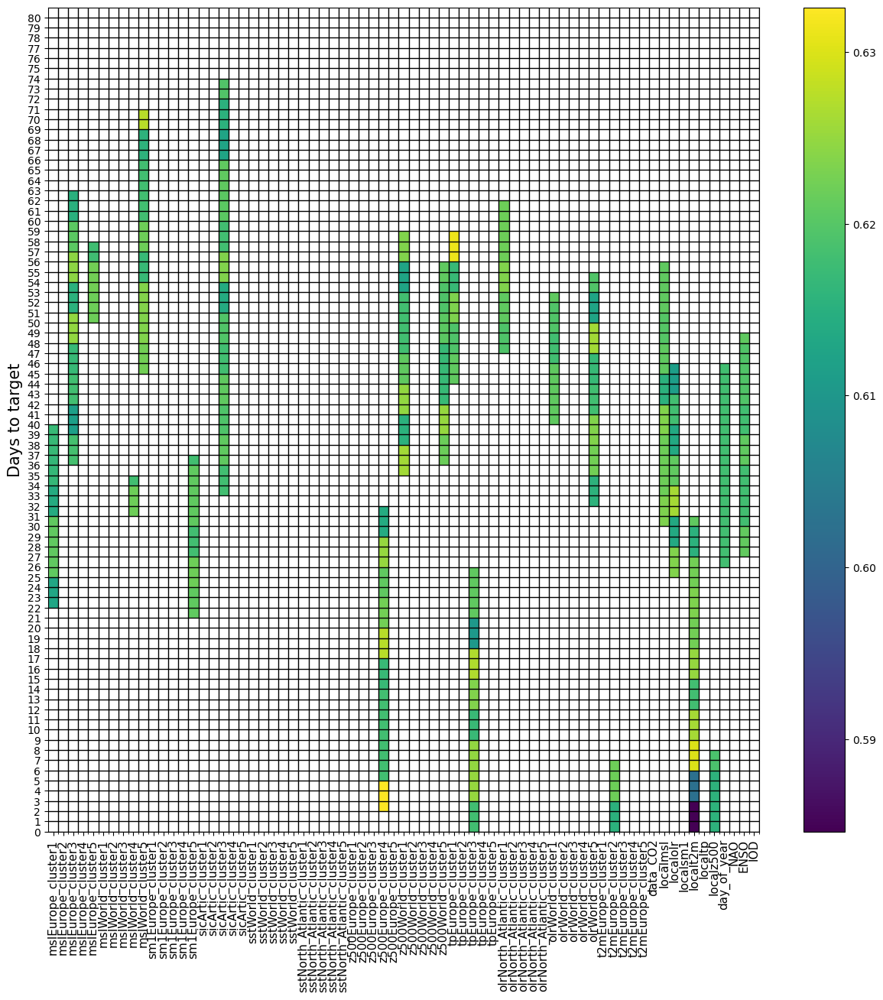

In [310]:
plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_filtered_sen.shape[0])-0.5,np.arange(board_filtered_sen.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.colorbar()
plt.ylabel('Days to target',fontsize=15)

# 

# for i in range(board_100.shape[1]):
#     if np.sum(board_100[:, i]) == 0:
#         rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
#         plt.gca().add_patch(rect)

In [60]:
f1s=[]
for var1 in unique_prefixes:
    filter_col = [col for col in X_train if col.startswith(var1)]
    division = int(len(filter_col)/4)
    for i in range(0,len(filter_col),division):
        # print(i,filter_col[i:i+3])
        X_train_sen = X_train.drop(filter_col[i:i+division],axis=1)
        X_test_sen = X_test.drop(filter_col[i:i+division],axis=1)


        clf_LR = LogisticRegression()

        clf_LR.fit(X_train_sen, Y_train)
        Y_pred = clf_LR.predict(X_test_sen)

        f1s.append(f1_score(Y_test, Y_pred))
f1s = np.array(f1s)

In [61]:
board_filtered_sen = board_filtered.copy()

board_filtered_sen = board_filtered_sen.astype(float)

In [62]:
selected_variables = np.where(np.sum(board_filtered_sen != 0, axis=0) != 0)[0]
h = 0

for i in selected_variables:
    non_zero_indices = np.where(board_filtered_sen[:, i] != 0)[0]
    division = int(len(non_zero_indices) / 4)
    
    for j in range(0, len(non_zero_indices), division):

        # Update the non-zero elements with values from f1s
        board_filtered_sen[non_zero_indices[j:j+division], i] = f1s[h]

        h += 1


Text(0, 0.5, 'Days to target')

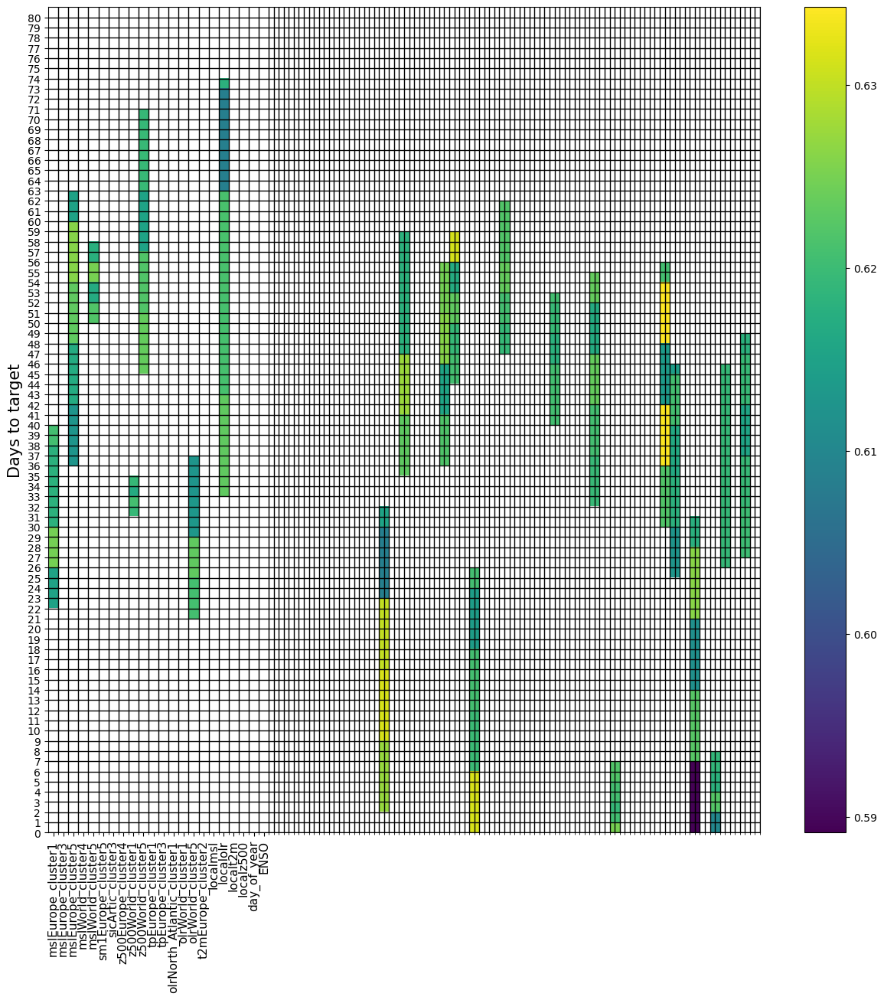

In [63]:
plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=11)
plt.yticks(np.arange(board_filtered_sen.shape[0])-0.5,np.arange(board_filtered_sen.shape[0]))
minor_locator = AutoMinorLocator(2)
plt.gca().xaxis.set_minor_locator(minor_locator)

plt.gca().xaxis.grid(which='minor',color='black', linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
plt.colorbar()
plt.ylabel('Days to target',fontsize=15)

# 

# for i in range(board_100.shape[1]):
#     if np.sum(board_100[:, i]) == 0:
#         rect = plt.Rectangle((i - 0.5, -0.5), 1, 1, color='red')
#         plt.gca().add_patch(rect)

Text(0, 0.5, 'Days to target')

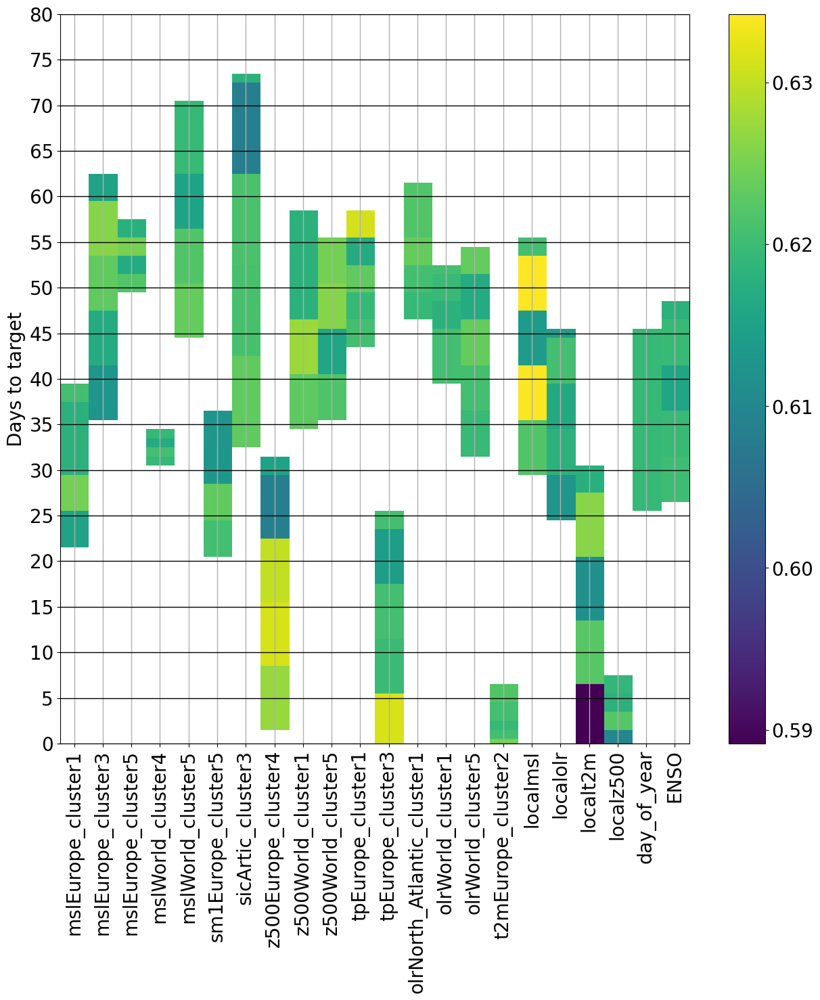

In [64]:
from matplotlib.ticker import MultipleLocator
# Just consider the columns of the board that have at least one day with a value greater than the threshold

board_filtered_sen = board_filtered_sen[:,np.any(board_filtered_sen, axis=0)]


plt.figure(figsize=(15, 14))
mask = board_filtered_sen == 0
plt.imshow(np.ma.masked_array(board_filtered_sen, mask), origin='lower',aspect='auto',vmin=f1s.min(),vmax=f1s.max())
# Put xticks of columns with at least one day with a value greater than the threshold

column_names = pred_dataframe_opt.columns.tolist()
column_names = np.array(column_names)[np.any(board_filtered, axis=0)]

plt.xticks(np.arange(len(column_names)), column_names, rotation=90,fontsize=20)

# Put just one of each 5 yticks
plt.gca().yaxis.set_major_locator(MultipleLocator(5))

plt.yticks(fontsize=20)
plt.ylim(0,80)
# Put the yticks labels

plt.gca().xaxis.grid( which='major',linewidth=1)
plt.gca().yaxis.grid(which='major',color='black', linewidth=1)
# plt.grid(color='black', linewidth=1)
cbar=plt.colorbar()
cbar.ax.tick_params(labelsize=20)
plt.ylabel('Days to target',fontsize=20)